# Install ptitprince and load libraries

In [3]:
!pip install ptitprince

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 42.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for ptitprince: filename=ptitprince-0.3.1-py3-none-any.whl size=16216 sha256=e3dfb22d38e63fe9a2ec1811aa619073a5ef0b26ce06ff590965839f073b2eb8
  Stored in directory: /root/.cache/pip/wheels/5d/79/49/b89a41fd3d8780ce2c21c7f2debe45f3c6b08d8aef400e3df1
Successfully built ptitprince


In [4]:
!pip install cartopy --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 41.8 MB/s eta 0:00:00


#Load Data

combinedFeatures_VegBiomeKoppen_withLatLon_with_countries_global_ns.csv, combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv, ne_110m_admin_0_countries.zip

In [5]:
!unzip ne_110m_admin_0_countries.zip

Archive:  ne_110m_admin_0_countries.zip
  inflating: ne_110m_admin_0_countries.README.html  
 extracting: ne_110m_admin_0_countries.VERSION.txt  
 extracting: ne_110m_admin_0_countries.cpg  
  inflating: ne_110m_admin_0_countries.dbf  
  inflating: ne_110m_admin_0_countries.prj  
  inflating: ne_110m_admin_0_countries.shp  
  inflating: ne_110m_admin_0_countries.shx  


In [6]:
!cp urbanRural_VegBiomeKoppen_withLatLon_with_countries_global_ns.csv /content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries_global_ns.csv
!cp urbanRural_VegBiomeKoppen_withLatLon_with_countries.csv /content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv

# Tree

###urban

Original number of cities with valid data: 83102


/usr/local/lib/python3.12/dist-packages/cartopy/io/__init__.py:242: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_land.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/usr/local/lib/python3.12/dist-packages/cartopy/io/__init__.py:242: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_ocean.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/usr/local/lib/python3.12/dist-packages/cartopy/io/__init__.py:242: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_coastline.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/usr/local/lib/python3.12/dist-packages/cartopy/io/__init__.py:242: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_cultural/ne_110m_admin_0_boundary_lines_land.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


Map saved to -> /content/Fig2A_map.pdf


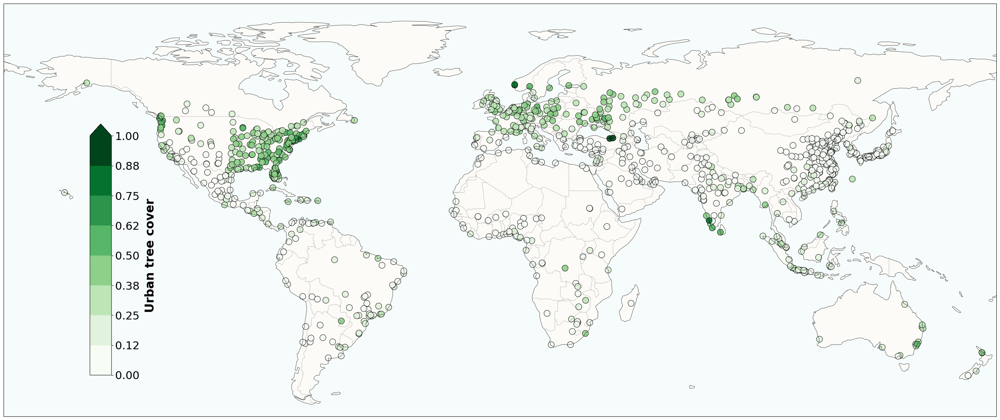

Histogram saved to -> /content/Fig2A_hist.pdf


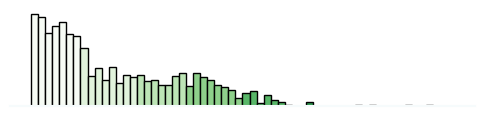

In [7]:
# ------------------------------------------------------------------
# STEP 1: IMPORTS
# ------------------------------------------------------------------
import sys
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm
from matplotlib.cm import ScalarMappable

# ------------------------------------------------------------------
# STEP 2: CONFIGURATION
# ------------------------------------------------------------------
# Paths should be adjusted to your environment.
# NOTE: Using the CSV with country names to ensure data consistency.
CSV_PATH        = Path('/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv')

# Outputs will be saved in the specified directory.
OUT_DIR         = Path('/content/')
OUT_MAP         = '/content/Fig2A_map.pdf'
OUT_HIST        = '/content/Fig2A_hist.pdf'

# --- Parameters ---
NUM_COLOR_BINS   = 8  # Number of distinct color classes on the map
NUM_HIST_BINS    = 60 # Number of bins for the smaller histogram

# A sequential green colormap suitable for tree cover data.
SEQUENTIAL_CMAP = plt.cm.Greens

# ------------------------------------------------------------------
# 1. LOAD CSV + CALCULATE URBAN TREE COVER FRACTION
# ------------------------------------------------------------------
if not CSV_PATH.is_file():
    raise FileNotFoundError(f"ERROR: CSV not found -> {CSV_PATH}")

# Use pandas to read the CSV file.
df = pd.read_csv(CSV_PATH, low_memory=False)

# Define required columns for the city map analysis
REQ = ["tree_cover_area_urban", "Urban_Area", "lat", "lon"]

missing = [c for c in REQ if c not in df.columns]
if missing:
    raise ValueError(f"ERROR: missing column(s) {missing!r} in CSV")

# Coerce data to numeric, turning errors into Not-a-Number (NaN)
for col in REQ:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Drop rows where essential data is missing
df.dropna(subset=REQ, inplace=True)

# Filter out cities with zero urban area to avoid division by zero
df = df[df["Urban_Area"] > 0].copy()

# Calculate the fraction of urban area covered by trees
df['tree_cover_frac'] = df["tree_cover_area_urban"] / df['Urban_Area']


# ------------------------------------------------------------------
# 2. FILTER FOR LARGEST 1000 CITIES
# ------------------------------------------------------------------
print(f"Original number of cities with valid data: {len(df)}")
df_top1000 = df.nlargest(1000, 'Urban_Area')


# ------------------------------------------------------------------
# 3. CREATE DISCRETE SEQUENTIAL COLOUR SCALE
# ------------------------------------------------------------------
# Get the tree cover fraction values
vals = df_top1000['tree_cover_frac'].to_numpy()

# Set the min/max for the color scale to the full 0-1 range
vmin = 0.0
vmax = 1.0

# Create discrete boundaries for the color bins
bounds = np.linspace(vmin, vmax, NUM_COLOR_BINS + 1)
norm   = BoundaryNorm(bounds, ncolors=SEQUENTIAL_CMAP.N, clip=True)


# ------------------------------------------------------------------
# 4. CITY SCATTER MAP
# ------------------------------------------------------------------
fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')
ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')

# Scatter plot of the top 1000 cities
scatter = ax.scatter(
    df_top1000['lon'],
    df_top1000['lat'],
    c=df_top1000['tree_cover_frac'],
    cmap=SEQUENTIAL_CMAP,
    norm=norm,
    s=150,  # Adjusted size for better visibility
    alpha=0.9,
    edgecolors='black',
    linewidths=0.8,
    transform=ccrs.PlateCarree()
)

ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())
# ax.set_title('Urban Tree Cover Fraction for the World\'s 1000 Largest Cities', fontsize=28, pad=20)


# --- Color Bar ---
cbar_ax = fig.add_axes([0.13, 0.27, 0.02, 0.35])
# Use a ScalarMappable for the color bar since it's a scatter plot
sm = ScalarMappable(norm=norm, cmap=SEQUENTIAL_CMAP)
sm.set_array([]) # You must set the array for the scalar mappable
cbar = plt.colorbar(sm, cax=cbar_ax, orientation='vertical', extend='max')
cbar.set_label('Urban tree cover', fontsize=24, labelpad=10, fontweight='bold')

# Set ticks to the calculated bin edges for clarity
cbar.set_ticks(bounds)
cbar.set_ticklabels([f'{b:.2f}' for b in bounds])
cbar.ax.tick_params(labelsize=22)


plt.subplots_adjust(left=0.05, right=0.97, top=0.95, bottom=0.05)
plt.savefig(OUT_MAP, bbox_inches='tight', format='pdf', transparent=True)
print(f"Map saved to -> {OUT_MAP}")
plt.show()

# ------------------------------------------------------------------
# 5. MINIMALIST HISTOGRAM
# ------------------------------------------------------------------
def minimalist_hist(series: pd.Series, bounds_arr, bins, cmap_obj, path):
    """Creates a minimalist histogram with bars colored by value."""
    # Use the same normalization as the map for visual consistency
    norm_hist = BoundaryNorm(bounds_arr, ncolors=cmap_obj.N, clip=True)

    # Clip series to the same bounds as the map
    series = series.clip(lower=bounds_arr[0], upper=bounds_arr[-1])
    if series.empty:
        print("No data in histogram range – skipped."); return

    fig, ax = plt.subplots(figsize=(6, 1.25))

    counts, edges, patches = ax.hist(
        series,
        bins=np.linspace(bounds_arr[0], bounds_arr[-1], bins + 1),
        edgecolor='black', linewidth=1
    )

    # Color each histogram bar based on its value
    for p, l, r in zip(patches, edges[:-1], edges[1:]):
        p.set_facecolor(cmap_obj(norm_hist((l + r) / 2)))

    # Strip axes for minimalist look
    ax.set_xticks([]); ax.set_yticks([])
    for s in ax.spines.values(): s.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbfc')
    ax.spines['bottom'].set_linewidth(1.5)

    fig.patch.set_alpha(0); ax.patch.set_alpha(0)
    plt.savefig(path, dpi=300, bbox_inches='tight', format='png', transparent=True)
    print(f"Histogram saved to -> {path}")
    plt.show()

# Generate the histogram with data and styling from the map
minimalist_hist(
    series=df_top1000['tree_cover_frac'],
    bounds_arr=bounds,
    bins=NUM_HIST_BINS,
    cmap_obj=SEQUENTIAL_CMAP,
    path=OUT_HIST
)

Original number of cities with valid data: 83102
Map saved to -> /content/Fig2_urbantree_Map_ALL.pdf


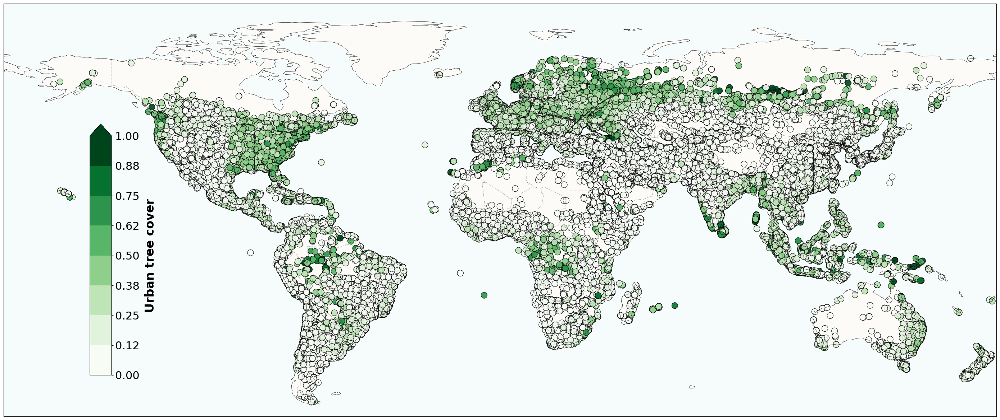

Histogram saved to -> /content/Fig2_urbantree_Histogram_ALL.pdf


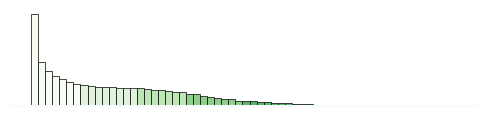

In [8]:
# ------------------------------------------------------------------
# STEP 1: IMPORTS
# ------------------------------------------------------------------
import sys
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm
from matplotlib.cm import ScalarMappable

# ------------------------------------------------------------------
# STEP 2: CONFIGURATION
# ------------------------------------------------------------------
# Paths should be adjusted to your environment.
# NOTE: Using the CSV with country names to ensure data consistency.
CSV_PATH        = Path('/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv')

# Outputs will be saved in the specified directory.
OUT_DIR         = Path('/content/')
OUT_MAP         = '/content/Fig2_urbantree_Map_ALL.pdf'
OUT_HIST        = '/content/Fig2_urbantree_Histogram_ALL.pdf'

# --- Parameters ---
NUM_COLOR_BINS   = 8  # Number of distinct color classes on the map
NUM_HIST_BINS    = 60 # Number of bins for the smaller histogram

# A sequential green colormap suitable for tree cover data.
SEQUENTIAL_CMAP = plt.cm.Greens

# ------------------------------------------------------------------
# 1. LOAD CSV + CALCULATE URBAN TREE COVER FRACTION
# ------------------------------------------------------------------
if not CSV_PATH.is_file():
    raise FileNotFoundError(f"ERROR: CSV not found -> {CSV_PATH}")

# Use pandas to read the CSV file.
df = pd.read_csv(CSV_PATH, low_memory=False)

# Define required columns for the city map analysis
REQ = ["tree_cover_area_urban", "Urban_Area", "lat", "lon"]

missing = [c for c in REQ if c not in df.columns]
if missing:
    raise ValueError(f"ERROR: missing column(s) {missing!r} in CSV")

# Coerce data to numeric, turning errors into Not-a-Number (NaN)
for col in REQ:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Drop rows where essential data is missing
df.dropna(subset=REQ, inplace=True)

# Filter out cities with zero urban area to avoid division by zero
df = df[df["Urban_Area"] > 0].copy()

# Calculate the fraction of urban area covered by trees
df['tree_cover_frac'] = df["tree_cover_area_urban"] / df['Urban_Area']


# ------------------------------------------------------------------
# 2. FILTER FOR LARGEST 1000 CITIES
# ------------------------------------------------------------------
print(f"Original number of cities with valid data: {len(df)}")
df_top1000 = df


# ------------------------------------------------------------------
# 3. CREATE DISCRETE SEQUENTIAL COLOUR SCALE
# ------------------------------------------------------------------
# Get the tree cover fraction values
vals = df_top1000['tree_cover_frac'].to_numpy()

# Set the min/max for the color scale to the full 0-1 range
vmin = 0.0
vmax = 1.0

# Create discrete boundaries for the color bins
bounds = np.linspace(vmin, vmax, NUM_COLOR_BINS + 1)
norm   = BoundaryNorm(bounds, ncolors=SEQUENTIAL_CMAP.N, clip=True)


# ------------------------------------------------------------------
# 4. CITY SCATTER MAP
# ------------------------------------------------------------------
fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')
ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')

# Scatter plot of the top 1000 cities
scatter = ax.scatter(
    df_top1000['lon'],
    df_top1000['lat'],
    c=df_top1000['tree_cover_frac'],
    cmap=SEQUENTIAL_CMAP,
    norm=norm,
    s=150,  # Adjusted size for better visibility
    alpha=0.9,
    edgecolors='black',
    linewidths=0.8,
    transform=ccrs.PlateCarree()
)

ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())
# ax.set_title('Urban Tree Cover Fraction for the World\'s 1000 Largest Cities', fontsize=28, pad=20)


# --- Color Bar ---
cbar_ax = fig.add_axes([0.13, 0.27, 0.02, 0.35])
# Use a ScalarMappable for the color bar since it's a scatter plot
sm = ScalarMappable(norm=norm, cmap=SEQUENTIAL_CMAP)
sm.set_array([]) # You must set the array for the scalar mappable
cbar = plt.colorbar(sm, cax=cbar_ax, orientation='vertical', extend='max')
cbar.set_label('Urban tree cover', fontsize=24, labelpad=10, fontweight='bold')

# Set ticks to the calculated bin edges for clarity
cbar.set_ticks(bounds)
cbar.set_ticklabels([f'{b:.2f}' for b in bounds])
cbar.ax.tick_params(labelsize=22)


plt.subplots_adjust(left=0.05, right=0.97, top=0.95, bottom=0.05)
plt.savefig(OUT_MAP, bbox_inches='tight', format='pdf', transparent=True)
print(f"Map saved to -> {OUT_MAP}")
plt.show()

# ------------------------------------------------------------------
# 5. MINIMALIST HISTOGRAM
# ------------------------------------------------------------------
def minimalist_hist(series: pd.Series, bounds_arr, bins, cmap_obj, path):
    """Creates a minimalist histogram with bars colored by value."""
    # Use the same normalization as the map for visual consistency
    norm_hist = BoundaryNorm(bounds_arr, ncolors=cmap_obj.N, clip=True)

    # Clip series to the same bounds as the map
    series = series.clip(lower=bounds_arr[0], upper=bounds_arr[-1])
    if series.empty:
        print("No data in histogram range – skipped."); return

    fig, ax = plt.subplots(figsize=(6, 1.25))

    counts, edges, patches = ax.hist(
        series,
        bins=np.linspace(bounds_arr[0], bounds_arr[-1], bins + 1),
        edgecolor='black', linewidth=0.5
    )

    # Color each histogram bar based on its value
    for p, l, r in zip(patches, edges[:-1], edges[1:]):
        p.set_facecolor(cmap_obj(norm_hist((l + r) / 2)))

    # Strip axes for minimalist look
    ax.set_xticks([]); ax.set_yticks([])
    for s in ax.spines.values(): s.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbfc')
    ax.spines['bottom'].set_linewidth(1.5)

    fig.patch.set_alpha(0); ax.patch.set_alpha(0)
    plt.savefig(path, bbox_inches='tight', format='pdf', transparent=True)
    print(f"Histogram saved to -> {path}")
    plt.show()

# Generate the histogram with data and styling from the map
minimalist_hist(
    series=df_top1000['tree_cover_frac'],
    bounds_arr=bounds,
    bins=NUM_HIST_BINS,
    cmap_obj=SEQUENTIAL_CMAP,
    path=OUT_HIST
)

###urban-rural difference

Map saved to /content/EDFig2_map.pdf


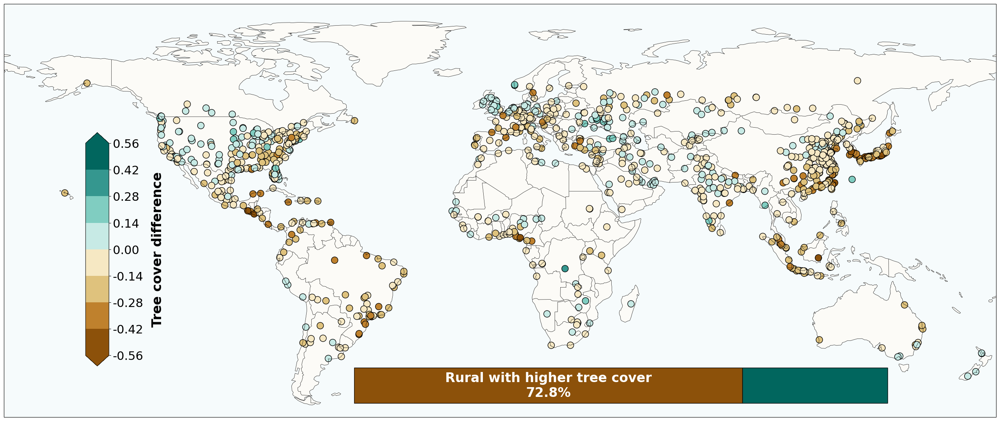

Histogram saved to /content/EDFig2_hist.pdf


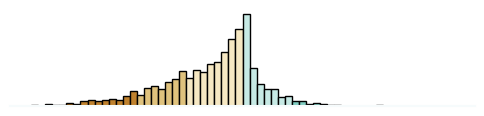

In [9]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import ListedColormap, BoundaryNorm
import geopandas as gpd

# Cohort size (Major cities) — keep in sync with summary table TOP_N
TOP_N = 1000
RURAL_AREA_CANDIDATES = ["Buffer_area", "Rural_Area"]


def _pick_rural_area_col(df: pd.DataFrame) -> str:
    """
    Choose rural area column in the same order as the summary script:
      1) Buffer_area
      2) Rural_Area
    """
    for c in RURAL_AREA_CANDIDATES:
        if c in df.columns:
            return c
    raise KeyError(f"None of {RURAL_AREA_CANDIDATES} found as rural area column.")


def create_frequency_histogram_discrete(series, bounds, cmap_disc, norm_disc, bins, out_dir):
    """
    Minimalist frequency histogram using the SAME discrete classes as the map.

    - Values restricted to [bounds[0], bounds[-1]]
    - Colors from cmap_disc via BoundaryNorm (norm_disc)
    - Each bar is assigned exactly one of the discrete colors
    """
    vals = pd.to_numeric(series, errors='coerce').dropna()
    vals = vals[(vals >= bounds[0]) & (vals <= bounds[-1])]
    if vals.empty:
        print("No data in histogram range.")
        return

    edges = np.linspace(bounds[0], bounds[-1], bins + 1)
    fig, ax = plt.subplots(figsize=(6, 1.25))

    try:
        counts, edges, patches = ax.hist(vals, bins=edges, edgecolor='black', linewidth=1)
    except Exception as e:
        print(f"Error generating histogram: {e}")
        plt.close(fig)
        return

    # DISCRETE coloring: use the same BoundaryNorm + colormap as the map
    for patch, left, right in zip(patches, edges[:-1], edges[1:]):
        mid = 0.5 * (left + right)
        patch.set_facecolor(cmap_disc(norm_disc(mid)))

    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbfc')
    ax.spines['bottom'].set_linewidth(1.5)

    fig.patch.set_alpha(0)
    ax.patch.set_alpha(0)

    hist_path = os.path.join(out_dir, 'EDFig2_hist.pdf')
    try:
        os.makedirs(out_dir, exist_ok=True)
        plt.savefig(hist_path, dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram saved to {hist_path}")
    except Exception as e:
        print(f"Error saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)


def analyze_tree_cover_difference(file_path):
    """
    Loads geospatial tree cover data and computes tree-cover fractions EXACTLY
    like the global summary table:

        frac_urban = tree_cover_area_urban / Urban_Area
        frac_rural = tree_cover_area_rural / Rural_Area_eff

    where Rural_Area_eff = Buffer_area (if present) else Rural_Area.

    Then:
      - Computes diff = frac_urban − frac_rural (clipped to [-1, 1] for plotting).
      - Selects Major cities: TOP_N by Urban_Area (ties kept, like summary).
      - Plots a map with a symmetric diverging palette.
      - Draws an inset stacked bar with:
            LEFT:  diff < 0   (rural > urban), brown
            MIDDLE: diff == 0 OR both tree areas 0, grey
            RIGHT: diff > 0   (urban > rural), teal
      - Saves map and DISCRETE histogram PDFs.
    """
    # 1. Load data
    try:
        data = gpd.read_file(file_path)
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # 2. Pick rural area column in the same way as the summary script
    try:
        rural_area_col = _pick_rural_area_col(data)
    except KeyError as e:
        raise ValueError(str(e))

    # Required columns for this map
    base_required = [
        'tree_cover_area_urban',
        'tree_cover_area_rural',
        'Urban_Area',
        'lat',
        'lon',
    ]
    required_columns = base_required + [rural_area_col]

    # Coerce numeric and check existence
    for col in required_columns:
        if col not in data.columns:
            raise ValueError(f"Required column '{col}' not found in data.")
        data[col] = pd.to_numeric(data[col], errors='coerce')

    # Drop rows with NaNs in required columns
    data = data.dropna(subset=required_columns)
    if data.empty:
        raise ValueError("No valid rows remain after dropping NaNs in required columns.")

    # Positive areas only (same spirit as summary)
    data = data[(data['Urban_Area'] > 0) & (data[rural_area_col] > 0)].copy()
    if data.empty:
        raise ValueError("No valid rows remain after filtering by area > 0.")

    data['Rural_Area_eff'] = data[rural_area_col]

    # 3. Tree-cover fractions (MATCH summary method)
    data['tree_cover_urban_frac'] = data['tree_cover_area_urban'] / data['Urban_Area']
    data['tree_cover_rural_frac'] = data['tree_cover_area_rural'] / data['Rural_Area_eff']

    # Difference (clip to [-1, 1] only for plotting aesthetics)
    data['tree_cover_difference'] = (
        data['tree_cover_urban_frac'] - data['tree_cover_rural_frac']
    ).clip(-1, 1)

    # 4. Major cities cohort: TOP_N by Urban_Area (like summary)
    top_n = min(TOP_N, len(data))
    data = data.nlargest(top_n, 'Urban_Area', keep='all').copy()
    if data.empty:
        raise ValueError("No rows remain after selecting top-N cities by Urban_Area.")

    # --- Diverging color palette (brown ↔ teal) ---
    custom_colors = [
        '#8c510a', '#bf812d', '#dfc27d', '#f6e8c3',  # brown side
        '#c7eae5', '#80cdc1', '#35978f', '#01665e'   # teal side
    ]

    # Compute symmetric bounds around 0 based on tree_cover_difference
    min_val = data['tree_cover_difference'].min()
    max_val = data['tree_cover_difference'].max()
    abs_max = max(abs(min_val), abs(max_val))
    if not np.isfinite(abs_max) or abs_max == 0:
        abs_max = 1.0

    bounds = np.linspace(-abs_max, abs_max, len(custom_colors) + 1)

    cmap_disc = ListedColormap(custom_colors)
    norm_disc = BoundaryNorm(bounds, ncolors=len(custom_colors), clip=True)

    # 5. Plot world scatter map
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, lw=0.5)
    ax.add_feature(cfeature.BORDERS, lw=0.5)
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')

    sc = ax.scatter(
        data['lon'], data['lat'],
        c=data['tree_cover_difference'],
        cmap=cmap_disc, norm=norm_disc,
        s=150, edgecolors='black', linewidths=1,
        transform=ccrs.PlateCarree()
    )

    # Colorbar
    cax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cbar = plt.colorbar(sc, cax=cax, orientation='vertical', extend='both')
    cbar.set_label('Tree cover difference', fontsize=24, labelpad=15, weight="bold")
    cbar.set_ticks(bounds)
    cbar.set_ticklabels([f"{b:.2f}" for b in bounds])
    cbar.ax.tick_params(labelsize=22)

    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    # 6. Inset bar chart with NEG / EQUAL / POS
    diff = data['tree_cover_difference']

    # both_zero: no tree cover area in either urban or rural
    both_zero_mask = (
        (data['tree_cover_area_urban'] == 0) &
        (data['tree_cover_area_rural'] == 0)
    )

    # equal_mask: diff == 0 OR both-zero tree cover
    equal_mask = (diff == 0) | both_zero_mask

    neg_mask = (diff < 0) & ~equal_mask
    pos_mask = (diff > 0) & ~equal_mask

    neg_count   = int(neg_mask.sum())
    pos_count   = int(pos_mask.sum())
    equal_count = int(equal_mask.sum())
    total       = int(len(data))

    if total == 0:
        raise ValueError("No observations available to compute bar-chart percentages.")

    p_neg   = 100.0 * neg_count   / total
    p_pos   = 100.0 * pos_count   / total
    p_equal = 100.0 * equal_count / total

    NEG_COLOR = custom_colors[0]
    POS_COLOR = custom_colors[-1]
    EQ_COLOR  = '#bdbdbd'

    bar_ax = fig.add_axes([0.4, 0.25, 0.48, 0.05])
    bar_ax.set_axis_off()

    # Left: rural > urban
    bar_ax.barh([''], [p_neg],
                color=NEG_COLOR, edgecolor='black', height=0.4)

    # Middle: equal (strict diff==0 OR both-zero tree cover)
    if p_equal > 0:
        bar_ax.barh([''], [p_equal],
                    color=EQ_COLOR, edgecolor='black', height=0.4, left=p_neg)
        pos_left = p_neg + p_equal
    else:
        pos_left = p_neg

    # Right: urban > rural
    bar_ax.barh([''], [p_pos],
                color=POS_COLOR, edgecolor='black', height=0.4, left=pos_left)

    # Label only the rural-higher segment
    bar_ax.text(p_neg / 2.0, 0,
                f"Rural with higher tree cover\n{p_neg:.1f}%",
                ha='center', va='center',
                fontsize=24, color='white', weight='bold')

    # Right-hand side left blank
    bar_ax.text(pos_left + p_pos / 2.0, 0,
                "",
                ha='center', va='center',
                fontsize=24, color='white', weight='bold')

    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)

    # Save map
    out_dir = '/content/'
    os.makedirs(out_dir, exist_ok=True)
    map_path = os.path.join(out_dir, 'EDFig2_map.pdf')
    try:
        plt.savefig(map_path, dpi=400, bbox_inches='tight', transparent=True)
        print(f"Map saved to {map_path}")
    except Exception as e:
        print(f"Error saving map: {e}")
    finally:
        plt.show()
        plt.close(fig)

    # DISCRETE histogram over same bounds/classes
    create_frequency_histogram_discrete(
        series=data['tree_cover_difference'],
        bounds=bounds,
        cmap_disc=cmap_disc,
        norm_disc=norm_disc,
        bins=60,
        out_dir=out_dir
    )


if __name__ == "__main__":
    input_file = '/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv'
    try:
        analyze_tree_cover_difference(input_file)
    except Exception as e:
        print(f"Analysis failed: {e}", file=sys.stderr)
        sys.exit(1)


Map saved to /content/EDFig2_map.pdf


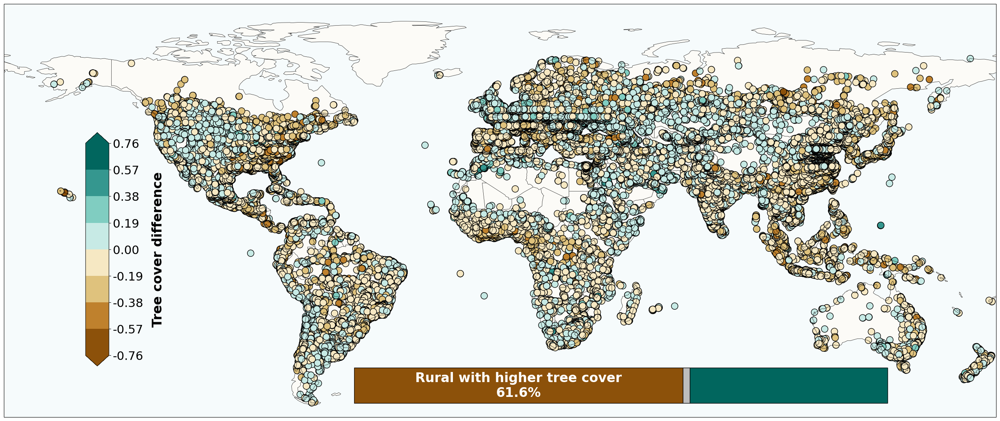

Histogram saved to /content/EDFig2_hist.pdf


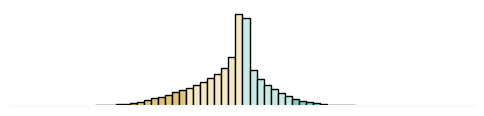

In [10]:
#!/usr/bin/env python3
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import ListedColormap, BoundaryNorm
import geopandas as gpd

# Cohort size (Major cities) — keep in sync with summary table TOP_N
TOP_N = 83102
RURAL_AREA_CANDIDATES = ["Buffer_area", "Rural_Area"]


def _pick_rural_area_col(df: pd.DataFrame) -> str:
    """
    Choose rural area column in the same order as the summary script:
      1) Buffer_area
      2) Rural_Area
    """
    for c in RURAL_AREA_CANDIDATES:
        if c in df.columns:
            return c
    raise KeyError(f"None of {RURAL_AREA_CANDIDATES} found as rural area column.")


def create_frequency_histogram_discrete(series, bounds, cmap_disc, norm_disc, bins, out_dir):
    """
    Minimalist frequency histogram using the SAME discrete classes as the map.

    - Values restricted to [bounds[0], bounds[-1]]
    - Colors from cmap_disc via BoundaryNorm (norm_disc)
    - Each bar is assigned exactly one of the discrete colors
    """
    vals = pd.to_numeric(series, errors='coerce').dropna()
    vals = vals[(vals >= bounds[0]) & (vals <= bounds[-1])]
    if vals.empty:
        print("No data in histogram range.")
        return

    edges = np.linspace(bounds[0], bounds[-1], bins + 1)
    fig, ax = plt.subplots(figsize=(6, 1.25))

    try:
        counts, edges, patches = ax.hist(vals, bins=edges, edgecolor='black', linewidth=1)
    except Exception as e:
        print(f"Error generating histogram: {e}")
        plt.close(fig)
        return

    # DISCRETE coloring: use the same BoundaryNorm + colormap as the map
    for patch, left, right in zip(patches, edges[:-1], edges[1:]):
        mid = 0.5 * (left + right)
        patch.set_facecolor(cmap_disc(norm_disc(mid)))

    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbfc')
    ax.spines['bottom'].set_linewidth(1.5)

    fig.patch.set_alpha(0)
    ax.patch.set_alpha(0)

    hist_path = os.path.join(out_dir, 'EDFig2_hist.pdf')
    try:
        os.makedirs(out_dir, exist_ok=True)
        plt.savefig(hist_path, dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram saved to {hist_path}")
    except Exception as e:
        print(f"Error saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)


def analyze_tree_cover_difference(file_path):
    """
    Loads geospatial tree cover data and computes tree-cover fractions EXACTLY
    like the global summary table:

        frac_urban = tree_cover_area_urban / Urban_Area
        frac_rural = tree_cover_area_rural / Rural_Area_eff

    where Rural_Area_eff = Buffer_area (if present) else Rural_Area.

    Then:
      - Computes diff = frac_urban − frac_rural (clipped to [-1, 1] for plotting).
      - Selects Major cities: TOP_N by Urban_Area (ties kept, like summary).
      - Plots a map with a symmetric diverging palette.
      - Draws an inset stacked bar with:
            LEFT:  diff < 0   (rural > urban), brown
            MIDDLE: diff == 0 OR both tree areas 0, grey
            RIGHT: diff > 0   (urban > rural), teal
      - Saves map and DISCRETE histogram PDFs.
    """
    # 1. Load data
    try:
        data = gpd.read_file(file_path)
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # 2. Pick rural area column in the same way as the summary script
    try:
        rural_area_col = _pick_rural_area_col(data)
    except KeyError as e:
        raise ValueError(str(e))

    # Required columns for this map
    base_required = [
        'tree_cover_area_urban',
        'tree_cover_area_rural',
        'Urban_Area',
        'lat',
        'lon',
    ]
    required_columns = base_required + [rural_area_col]

    # Coerce numeric and check existence
    for col in required_columns:
        if col not in data.columns:
            raise ValueError(f"Required column '{col}' not found in data.")
        data[col] = pd.to_numeric(data[col], errors='coerce')

    # Drop rows with NaNs in required columns
    data = data.dropna(subset=required_columns)
    if data.empty:
        raise ValueError("No valid rows remain after dropping NaNs in required columns.")

    # Positive areas only (same spirit as summary)
    data = data[(data['Urban_Area'] > 0) & (data[rural_area_col] > 0)].copy()
    if data.empty:
        raise ValueError("No valid rows remain after filtering by area > 0.")

    data['Rural_Area_eff'] = data[rural_area_col]

    # 3. Tree-cover fractions (MATCH summary method)
    data['tree_cover_urban_frac'] = data['tree_cover_area_urban'] / data['Urban_Area']
    data['tree_cover_rural_frac'] = data['tree_cover_area_rural'] / data['Rural_Area_eff']

    # Difference (clip to [-1, 1] only for plotting aesthetics)
    data['tree_cover_difference'] = (
        data['tree_cover_urban_frac'] - data['tree_cover_rural_frac']
    ).clip(-1, 1)

    # 4. Major cities cohort: TOP_N by Urban_Area (like summary)
    top_n = min(TOP_N, len(data))
    data = data.nlargest(top_n, 'Urban_Area', keep='all').copy()
    if data.empty:
        raise ValueError("No rows remain after selecting top-N cities by Urban_Area.")

    # --- Diverging color palette (brown ↔ teal) ---
    custom_colors = [
        '#8c510a', '#bf812d', '#dfc27d', '#f6e8c3',  # brown side
        '#c7eae5', '#80cdc1', '#35978f', '#01665e'   # teal side
    ]

    # Compute symmetric bounds around 0 based on tree_cover_difference
    min_val = data['tree_cover_difference'].min()
    max_val = data['tree_cover_difference'].max()
    abs_max = max(abs(min_val), abs(max_val))
    if not np.isfinite(abs_max) or abs_max == 0:
        abs_max = 1.0

    bounds = np.linspace(-abs_max, abs_max, len(custom_colors) + 1)

    cmap_disc = ListedColormap(custom_colors)
    norm_disc = BoundaryNorm(bounds, ncolors=len(custom_colors), clip=True)

    # 5. Plot world scatter map
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, lw=0.5)
    ax.add_feature(cfeature.BORDERS, lw=0.5)
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')

    sc = ax.scatter(
        data['lon'], data['lat'],
        c=data['tree_cover_difference'],
        cmap=cmap_disc, norm=norm_disc,
        s=150, edgecolors='black', linewidths=1,
        transform=ccrs.PlateCarree()
    )

    # Colorbar
    cax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cbar = plt.colorbar(sc, cax=cax, orientation='vertical', extend='both')
    cbar.set_label('Tree cover difference', fontsize=24, labelpad=15, weight="bold")
    cbar.set_ticks(bounds)
    cbar.set_ticklabels([f"{b:.2f}" for b in bounds])
    cbar.ax.tick_params(labelsize=22)

    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    # 6. Inset bar chart with NEG / EQUAL / POS
    diff = data['tree_cover_difference']

    # both_zero: no tree cover area in either urban or rural
    both_zero_mask = (
        (data['tree_cover_area_urban'] == 0) &
        (data['tree_cover_area_rural'] == 0)
    )

    # equal_mask: diff == 0 OR both-zero tree cover
    equal_mask = (diff == 0) | both_zero_mask

    neg_mask = (diff < 0) & ~equal_mask
    pos_mask = (diff > 0) & ~equal_mask

    neg_count   = int(neg_mask.sum())
    pos_count   = int(pos_mask.sum())
    equal_count = int(equal_mask.sum())
    total       = int(len(data))

    if total == 0:
        raise ValueError("No observations available to compute bar-chart percentages.")

    p_neg   = 100.0 * neg_count   / total
    p_pos   = 100.0 * pos_count   / total
    p_equal = 100.0 * equal_count / total

    NEG_COLOR = custom_colors[0]
    POS_COLOR = custom_colors[-1]
    EQ_COLOR  = '#bdbdbd'

    bar_ax = fig.add_axes([0.4, 0.25, 0.48, 0.05])
    bar_ax.set_axis_off()

    # Left: rural > urban
    bar_ax.barh([''], [p_neg],
                color=NEG_COLOR, edgecolor='black', height=0.4)

    # Middle: equal (strict diff==0 OR both-zero tree cover)
    if p_equal > 0:
        bar_ax.barh([''], [p_equal],
                    color=EQ_COLOR, edgecolor='black', height=0.4, left=p_neg)
        pos_left = p_neg + p_equal
    else:
        pos_left = p_neg

    # Right: urban > rural
    bar_ax.barh([''], [p_pos],
                color=POS_COLOR, edgecolor='black', height=0.4, left=pos_left)

    # Label only the rural-higher segment
    bar_ax.text(p_neg / 2.0, 0,
                f"Rural with higher tree cover\n{p_neg:.1f}%",
                ha='center', va='center',
                fontsize=24, color='white', weight='bold')

    # Right-hand side left blank
    bar_ax.text(pos_left + p_pos / 2.0, 0,
                "",
                ha='center', va='center',
                fontsize=24, color='white', weight='bold')

    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)

    # Save map
    out_dir = '/content/'
    os.makedirs(out_dir, exist_ok=True)
    map_path = os.path.join(out_dir, 'EDFig2_map.pdf')
    try:
        plt.savefig(map_path, dpi=400, bbox_inches='tight', transparent=True)
        print(f"Map saved to {map_path}")
    except Exception as e:
        print(f"Error saving map: {e}")
    finally:
        plt.show()
        plt.close(fig)

    # DISCRETE histogram over same bounds/classes
    create_frequency_histogram_discrete(
        series=data['tree_cover_difference'],
        bounds=bounds,
        cmap_disc=cmap_disc,
        norm_disc=norm_disc,
        bins=60,
        out_dir=out_dir
    )


if __name__ == "__main__":
    input_file = '/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv'
    try:
        analyze_tree_cover_difference(input_file)
    except Exception as e:
        print(f"Analysis failed: {e}", file=sys.stderr)
        sys.exit(1)


###global north south

Data after cleaning: (80341, 37)
Unique GlobalNS values: ['South', 'North']

[North] Area-weighted stats for TREE fraction difference:
  n_raw (cities)                  : 30621
  n_eff (Kish)                    : 464.1
  μ_w (weighted mean of diffs)    : -0.0677
  SE_w (weighted)                 : 0.0063
  Δ (ratio-of-sums, group-level)  : -0.0681
  U > R                           : 11779 / 30621 (38.5%)

[South] Area-weighted stats for TREE fraction difference:
  n_raw (cities)                  : 49720
  n_eff (Kish)                    : 1247.1
  μ_w (weighted mean of diffs)    : -0.0704
  SE_w (weighted)                 : 0.0037
  Δ (ratio-of-sums, group-level)  : -0.0707
  U > R                           : 18062 / 49720 (36.3%)


/tmp/ipython-input-921728976.py:102: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


Figure saved → /content/EDFig3B.pdf


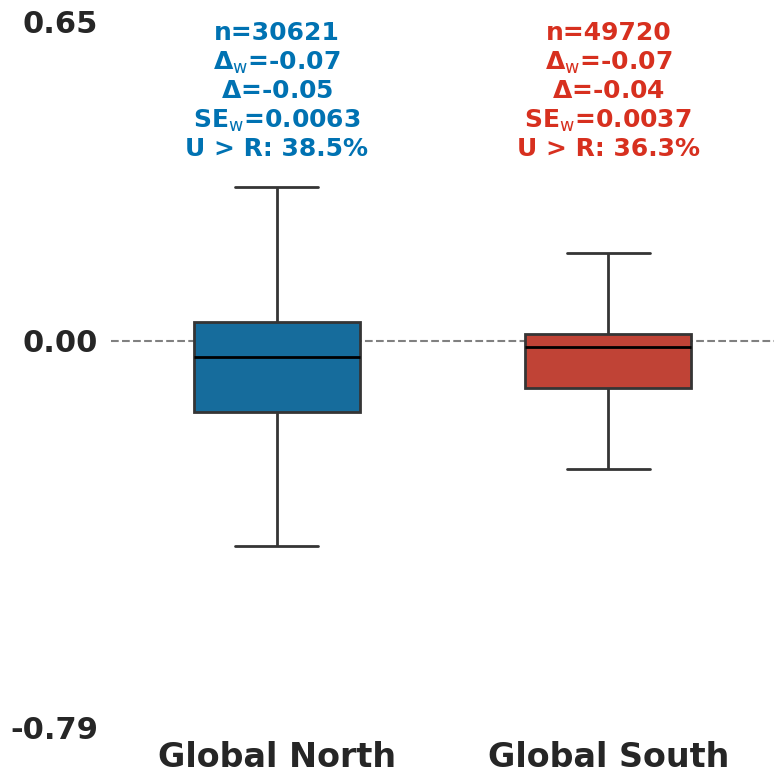

In [11]:
from __future__ import annotations
import sys
from pathlib import Path
from typing import Dict, Tuple

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# ─────────────────────────────────────────────────────────────────────
# CONFIG
# ─────────────────────────────────────────────────────────────────────
INPUT_CSV  = Path('/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries_global_ns.csv')
OUTPUT_FIG = Path('/content/EDFig3B.pdf')
GROUP_COL  = 'GlobalNS'
FEATURE    = 'tree_frac_difference'          # plotted variable
PLOT_ORDER = ['North', 'South']              # underlying group values (kept as-is)

# Okabe–Ito blue / Vermilion
COLORS = {'North': '#0072B2', 'South': '#d7301f'}

# Column names for TREE areas
TREE_URBAN_COL = 'tree_cover_area_urban'
TREE_RURAL_COL = 'tree_cover_area_rural'

# ─────────────────────────────────────────────────────────────────────
# HELPERS
# ─────────────────────────────────────────────────────────────────────
def _safe_y_limits(values: pd.Series) -> Tuple[float, float]:
    """Keep 0 in range with small padding."""
    v = pd.to_numeric(values, errors='coerce').dropna().astype(float)
    if v.empty:
        return (-1.0, 1.0)
    vmin, vmax = float(np.min(v)), float(np.max(v))
    vmin = min(vmin, 0.0)
    vmax = max(vmax, 0.0)
    if np.isclose(vmin, vmax):
        pad = max(abs(vmax), 0.01) * 0.1
        vmin, vmax = vmax - pad, vmax + pad
    span = vmax - vmin
    return (vmin - 0.02 * span, vmax + 0.02 * span)

def _kish_weighted_mean_se(x: np.ndarray, w: np.ndarray) -> Tuple[float, float, float, int]:
    """
    Kish-weighted mean and SE:
      μ_w   = Σ w x / Σ w
      Var_w = Σ w (x − μ_w)^2 / Σ w
      n_eff = (Σ w)^2 / Σ w^2
      SE_w  = sqrt(Var_w / n_eff)
    Returns (mean_w, se_w, n_eff, n_raw)
    """
    x = np.asarray(x, dtype=float)
    w = np.asarray(w, dtype=float)
    m = np.isfinite(x) & np.isfinite(w) & (w > 0)
    x, w = x[m], w[m]
    n_raw = int(x.size)
    if n_raw == 0:
        return (np.nan, np.nan, 0.0, 0)
    W = float(np.sum(w))
    mu_w = float(np.sum(w * x) / W)
    var_w = float(np.sum(w * (x - mu_w) ** 2) / W)
    w2 = float(np.sum(w * w))
    n_eff = (W * W) / w2 if w2 > 0 else 0.0
    se_w = float(np.sqrt(var_w / max(n_eff, 1.0))) if np.isfinite(var_w) else np.nan
    return (mu_w, se_w, n_eff, n_raw)

def _group_ratio_of_sums_tree(df_g: pd.DataFrame) -> float:
    """
    Group-level tree fraction difference via ratio-of-sums:
      (Σ tree_area_urban / Σ Urban_Area) − (Σ tree_area_rural / Σ Buffer_area)
    """
    u_area = float(df_g['Urban_Area'].sum())
    r_area = float(df_g['Buffer_area'].sum())
    if u_area <= 0 or r_area <= 0:
        return np.nan
    u_num = float(df_g[TREE_URBAN_COL].sum())
    r_num = float(df_g[TREE_RURAL_COL].sum())
    return (u_num / u_area) - (r_num / r_area)

def _ext_from_path(p: Path) -> str:
    ext = p.suffix.lower().lstrip('.')
    return ext if ext in {'pdf', 'png', 'svg'} else 'pdf'

# ─────────────────────────────────────────────────────────────────────
# PLOTTING
# ─────────────────────────────────────────────────────────────────────
def create_minimalistic_boxplot(data: pd.DataFrame,
                                feature: str,
                                stats_w: Dict[str, Dict[str, float]],
                                output_path: Path) -> None:
    if data.empty:
        raise ValueError(f"No data available for plotting '{feature}'.")

    plt.rcParams.update({'font.size': 24})
    sns.set(style="white")
    fig = plt.figure(figsize=(8, 8), facecolor="none")
    ax = plt.gca()
    ax.set_facecolor("none")

    # Unweighted boxplot (distribution shape); weighted stats in annotations
    sns.boxplot(
        x=GROUP_COL, y=feature, data=data, order=PLOT_ORDER,
        width=0.5, showfliers=False, palette=COLORS,
        boxprops={'alpha': 1, 'linewidth': 2},
        whiskerprops={'linewidth': 2},
        capprops={'linewidth': 2},
        medianprops={'linewidth': 2, 'color': 'black'}
    )

    # Reference line at 0
    ax.axhline(0, color='grey', linestyle='--', linewidth=1.5, zorder=0)

    # y-limits and ticks
    ymin, ymax = _safe_y_limits(data[feature])
    ax.set_ylim(ymin, ymax)
    ax.set_yticks([ax.get_ylim()[0], 0, ax.get_ylim()[1]])
    ax.set_yticklabels([f"{ax.get_ylim()[0]:.2f}", "0.00", f"{ax.get_ylim()[1]:.2f}"])

    # Minimal axes
    sns.despine(left=True, bottom=True, trim=True, offset=10)
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.spines["left"].set_visible(False)
    ax.spines["bottom"].set_visible(False)
    plt.yticks(fontsize=22, fontweight='bold')

    # Override x-axis tick labels to show "Global North" / "Global South"
    ax.set_xticks([0, 1])
    ax.set_xticklabels(["Global North", "Global South"], fontsize=24, fontweight='bold')

    # AREA-WEIGHTED μ_w / SE_w + simple μ + RAW n + % U > R (mathtext)
    y0, y1 = ax.get_ylim()
    for i, label in enumerate(PLOT_ORDER):
        st = stats_w.get(label)
        if not st:
            continue
        y_pos = y1 + 0.00 * (y1 - y0)  # can adjust if you later want them above plot
        ann = (
            f"n={st['n_raw']}\n"
            r"$\boldsymbol{\Delta}_{\mathrm{w}}$" + f"={st['mean_w']:.2f}\n"
            r"$\boldsymbol{\Delta}$"               + f"={st['mu_simple']:.2f}\n"
            r"$\mathbf{SE}_{\mathrm{w}}$"         + f"={st['se_w']:.4f}\n"
            f"U > R: {st['pct_pos']:.1f}%"
        )
        ax.text(
            i, y_pos, ann,
            ha='center', va='top', fontsize=18, fontweight='bold',
            color=COLORS.get(label, 'black')
        )

    plt.tight_layout()
    output_path.parent.mkdir(parents=True, exist_ok=True)
    fmt = _ext_from_path(output_path)
    try:
        plt.savefig(output_path, dpi=400, bbox_inches='tight', format=fmt, transparent=True)
        print(f"Figure saved → {output_path}")
    except Exception as e:
        print(f"[ERROR] Failed to save figure: {e}", file=sys.stderr)
    plt.show()

# ─────────────────────────────────────────────────────────────────────
# PIPELINE
# ─────────────────────────────────────────────────────────────────────
def tree_fraction_difference_analysis(file_path: Path, output_path: Path) -> None:
    if not file_path.is_file():
        raise FileNotFoundError(f"The file '{file_path}' does not exist.")

    try:
        df = pd.read_csv(file_path, low_memory=False)
    except Exception as e:
        raise IOError(f"Error reading '{file_path}': {e}")

    # Validate required columns
    required_cols = [TREE_URBAN_COL, TREE_RURAL_COL, 'Urban_Area', 'Buffer_area', GROUP_COL]
    missing = [c for c in required_cols if c not in df.columns]
    if missing:
        raise ValueError(f"Missing required columns: {missing}")

    # Coerce numerics for tree areas and denominators
    for col in [TREE_URBAN_COL, TREE_RURAL_COL, 'Urban_Area', 'Buffer_area']:
        df[col] = pd.to_numeric(df[col], errors='coerce')

    # Clean and ensure positive denominators
    df = df.dropna(subset=required_cols).copy()
    df = df[(df['Urban_Area'] > 0) & (df['Buffer_area'] > 0)].copy()
    if df.empty:
        raise ValueError("No valid rows after cleaning and positive-area filtering.")

    # Per-city tree fractions and URBAN−RURAL difference
    df['tree_frac_urban'] = df[TREE_URBAN_COL] / df['Urban_Area']
    df['tree_frac_rural'] = df[TREE_RURAL_COL] / df['Buffer_area']
    df[FEATURE] = df['tree_frac_urban'] - df['tree_frac_rural']

    # Keep North/South; fixed order
    df = df[df[GROUP_COL].isin(PLOT_ORDER)].copy()
    if df.empty:
        raise ValueError(f"No rows with groups in {PLOT_ORDER}.")
    df[GROUP_COL] = pd.Categorical(df[GROUP_COL], categories=PLOT_ORDER, ordered=True)

    # Weights for city-level diff_i
    df['w_diff'] = df['Urban_Area'] + df['Buffer_area']
    df = df[df['w_diff'] > 0].copy()
    if df.empty:
        raise ValueError("No valid rows after applying w_diff > 0 filter.")

    print(f"Data after cleaning: {df.shape}")
    print(f"Unique {GROUP_COL} values: {list(df[GROUP_COL].unique())}")

    # Weighted stats per group + ratio-of-sums + % U>R
    stats_weighted: Dict[str, Dict[str, float]] = {}
    for g in PLOT_ORDER:
        gdf = df[df[GROUP_COL] == g].copy()
        x = gdf[FEATURE].to_numpy()
        w = gdf['w_diff'].to_numpy()

        mean_w, se_w, n_eff, n_raw = _kish_weighted_mean_se(x, w)
        mu_simple = float(np.nanmean(x)) if x.size else float('nan')
        ros = _group_ratio_of_sums_tree(gdf)
        n_pos = int((gdf[FEATURE] > 0).sum())
        pct_pos = 100.0 * n_pos / n_raw if n_raw > 0 else np.nan

        stats_weighted[g] = {
            'mean_w': mean_w,
            'se_w': se_w,
            'n_eff': n_eff,
            'n_raw': n_raw,
            'mu_simple': mu_simple,
            'ratio_of_sums': ros,
            'pct_pos': pct_pos
        }

        # Console diagnostics (tree only)
        print(f"\n[{g}] Area-weighted stats for TREE fraction difference:")
        print(f"  n_raw (cities)                  : {n_raw}")
        print(f"  n_eff (Kish)                    : {n_eff:.1f}")
        print(f"  μ_w (weighted mean of diffs)    : {mean_w:.4f}")
        print(f"  SE_w (weighted)                 : {se_w:.4f}")
        print(f"  Δ (ratio-of-sums, group-level)  : {ros:.4f}")
        print(f"  U > R                           : {n_pos} / {n_raw} ({pct_pos:.1f}%)")

    # Plot
    create_minimalistic_boxplot(df, FEATURE, stats_weighted, output_path)

# ─────────────────────────────────────────────────────────────────────
# CLI
# ─────────────────────────────────────────────────────────────────────
def main() -> None:
    try:
        tree_fraction_difference_analysis(INPUT_CSV, OUTPUT_FIG)
    except (FileNotFoundError, ValueError, IOError) as e:
        print(f"[ERROR] {e}", file=sys.stderr)
        sys.exit(1)
    except Exception as e:
        print(f"[ERROR] Unexpected: {e}", file=sys.stderr)
        sys.exit(2)

if __name__ == '__main__':
    main()


###climate

/usr/local/lib/python3.12/dist-packages/ptitprince/PtitPrince.py:154: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for group_name, group_df in self.plot_data.groupby(grouping_vars):
/tmp/ipython-input-3015490337.py:151: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(


[OK] Figure saved → /content/EDFig3C.pdf


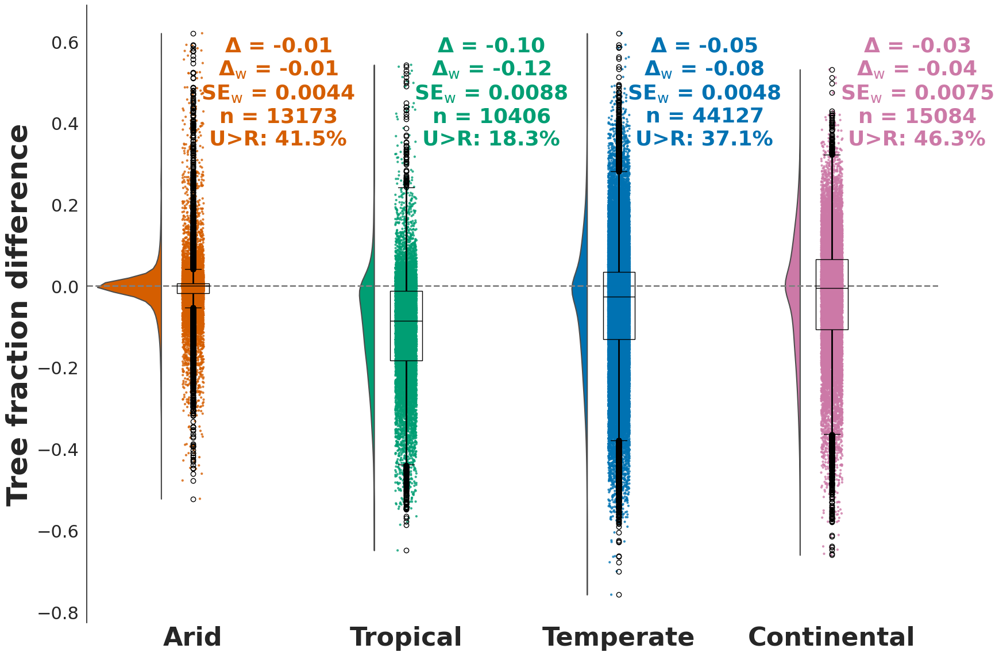


Climate summaries (μ_w, μ, SE_w):
              n_raw    mu_w  mu_simple    SE_w     n_eff  U>R (%)
Köppen class                                                     
Arid          13173 -0.0143    -0.0061  0.0044  229.3125  41.5471
Tropical      10406 -0.1203    -0.1047  0.0088  203.9048  18.3260
Temperate     44127 -0.0813    -0.0481  0.0048  860.0688  37.1065
Continental   15084 -0.0380    -0.0250  0.0075  302.0870  46.3206


In [12]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import ptitprince as pt
from pathlib import Path

# ─────────────────────────────────────────────────────────────────────
# 1) INPUT
# ─────────────────────────────────────────────────────────────────────
CSV_PATH = "/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries_global_ns.csv"
OUT_PNG  = "/content/EDFig3C.pdf"

# ─────────────────────────────────────────────────────────────────────
# 2) CONFIG
# ─────────────────────────────────────────────────────────────────────
# Tree columns only
TREE_URBAN_COL = "tree_cover_area_urban"
TREE_RURAL_COL = "tree_cover_area_rural"

REQUIRED = [
    TREE_URBAN_COL, TREE_RURAL_COL,
    "koppen_name_urban", "lat", "lon", "Urban_Area", "Buffer_area"
]

KOPPEN_MAP = {"A": "Tropical", "B": "Arid", "C": "Temperate", "D": "Continental"}
ORDER      = ["Arid", "Tropical", "Temperate", "Continental"]
PALETTE    = ["#D55E00", "#009E73", "#0072B2", "#CC79A7"]  # Arid, Tropical, Temperate, Continental

# ─────────────────────────────────────────────────────────────────────
# 3) LOAD + CLEAN
# ─────────────────────────────────────────────────────────────────────
try:
    df = pd.read_csv(CSV_PATH, low_memory=False)
except FileNotFoundError as e:
    raise FileNotFoundError(f"Data file not found: {CSV_PATH}") from e
except Exception as e:
    raise RuntimeError(f"Failed to read CSV: {e}") from e

missing = [c for c in REQUIRED if c not in df.columns]
if missing:
    raise ValueError(f"Missing required columns: {missing}")

# Coerce numerics; keep koppen_name_urban as string
for col in REQUIRED:
    if "name" not in col:
        df[col] = pd.to_numeric(df[col], errors='coerce')

# Guard denominators
df["Urban_Area"]  = df["Urban_Area"].replace(0, np.nan)
df["Buffer_area"] = df["Buffer_area"].replace(0, np.nan)

df = df.dropna(subset=REQUIRED).copy()
if df.empty:
    raise ValueError("No valid rows after cleaning.")

# ─────────────────────────────────────────────────────────────────────
# 4) CITY-LEVEL TREE FRACTIONS + DIFFERENCE
# ─────────────────────────────────────────────────────────────────────
df["tree_frac_urban"] = df[TREE_URBAN_COL] / df["Urban_Area"]
df["tree_frac_rural"] = df[TREE_RURAL_COL] / df["Buffer_area"]
df["tree_frac_diff"]  = df["tree_frac_urban"] - df["tree_frac_rural"]

# Köppen class
df["koppen_class"] = df["koppen_name_urban"].astype(str).str[0].map(KOPPEN_MAP)
df = df.dropna(subset=["koppen_class", "tree_frac_diff"]).copy()
df["koppen_class"] = pd.Categorical(df["koppen_class"], categories=ORDER, ordered=True)
df = df.sort_values("koppen_class")

# Weights for class-level summaries of the *difference*
df["w_diff"] = df["Urban_Area"] + df["Buffer_area"]
df = df[df["w_diff"] > 0].copy()
if df.empty:
    raise ValueError("All rows dropped after enforcing positive weights.")

# ─────────────────────────────────────────────────────────────────────
# 5) AREA-WEIGHTED STATS PER KÖPPEN CLASS (+ U>R %) + SIMPLE MEAN
# ─────────────────────────────────────────────────────────────────────
def weighted_mean_se_with_kish(x: np.ndarray, w: np.ndarray):
    """
    Returns (μ_w, SE_w, n_eff, n_raw).
    Kish n_eff = (Σw)^2 / Σw^2.
    SE_w uses var_w = Σ w (x-μ_w)^2 / Σ w, then SE_w = sqrt(var_w / n_eff).
    """
    x = np.asarray(x, dtype=float)
    w = np.asarray(w, dtype=float)
    m = np.isfinite(x) & np.isfinite(w) & (w > 0)
    x, w = x[m], w[m]
    n_raw = int(x.size)
    if n_raw == 0:
        return np.nan, np.nan, 0.0, 0
    W = float(w.sum())
    if W <= 0:
        return np.nan, np.nan, 0.0, n_raw
    mu_w = float(np.sum(w * x) / W)
    w2   = float(np.sum(w * w))
    n_eff = (W * W) / w2 if w2 > 0 else 0.0
    var_w = float(np.sum(w * (x - mu_w) ** 2) / W)
    se_w  = float(np.sqrt(var_w / max(n_eff, 1.0))) if np.isfinite(var_w) else np.nan
    return mu_w, se_w, n_eff, n_raw

stats_rows = []
for klass, grp in df.groupby("koppen_class", observed=True):
    if grp.empty:
        continue
    x = grp["tree_frac_diff"].to_numpy()
    w = grp["w_diff"].to_numpy()

    mu_w, se_w, n_eff, n_raw = weighted_mean_se_with_kish(x, w)
    mu_simple = float(np.nanmean(x)) if np.isfinite(x).any() else np.nan
    pct_ur = float((grp["tree_frac_diff"] > 0).mean() * 100.0)  # unweighted share of cities

    stats_rows.append({
        "Köppen class": klass,
        "n_raw": n_raw,
        "mu_w": mu_w,             # weighted mean
        "mu_simple": mu_simple,   # simple (unweighted) mean
        "SE_w": se_w,
        "n_eff": n_eff,
        "U>R (%)": pct_ur
    })

stats_df = (pd.DataFrame(stats_rows)
              .set_index("Köppen class")
              .reindex(ORDER))

# ─────────────────────────────────────────────────────────────────────
# 6) RAINCLOUD PLOT (unweighted distribution; weighted annotations)
# ─────────────────────────────────────────────────────────────────────
plt.rcParams.update({"font.size": 26})
fig, ax = plt.subplots(figsize=(18, 12), facecolor='none')  # transparent bg

# RainCloud violins
pt.half_violinplot(
    x="koppen_class", y="tree_frac_diff",
    data=df, palette=PALETTE, bw=.2, cut=0, scale="area",
    width=.6, inner=None, orient="v", ax=ax
)

# Boxplot overlay (unweighted)
sns.boxplot(
    x="koppen_class", y="tree_frac_diff",
    data=df, width=.15, showcaps=True,
    boxprops={"facecolor": "none"},
    whiskerprops={"linewidth": 2},
    capprops={"zorder": 10},
    whis=1.5, color="black", zorder=10, ax=ax
)

# Stripplot overlay
sns.stripplot(
    x="koppen_class", y="tree_frac_diff",
    data=df, palette=PALETTE, jitter=0.05,
    size=3, alpha=0.8, orient="v", ax=ax
)

# Zero line & styling
ax.axhline(y=0, color="gray", linestyle="--", linewidth=2)
ax.grid(False)
for spine in ["top", "right", "bottom"]:
    ax.spines[spine].set_visible(False)
ax.tick_params(axis='x', length=0)

# Labels
ax.set_ylabel("Tree fraction difference", fontsize=36, fontweight="bold")
ax.set_xlabel("")
plt.setp(ax.get_xticklabels(), fontsize=32, fontweight="bold")
plt.yticks(fontsize=22)

# Weighted statistical annotations + simple mean + U>R %
ymin, ymax = ax.get_ylim()
y_text = ymax - 0.05 * (ymax - ymin)

for i, klass in enumerate(ORDER):
    if klass not in stats_df.index or pd.isna(stats_df.loc[klass, "mu_w"]):
        continue
    n_raw     = int(stats_df.loc[klass, "n_raw"])
    mu_w      = float(stats_df.loc[klass, "mu_w"])
    mu_simple = float(stats_df.loc[klass, "mu_simple"])
    se_w      = float(stats_df.loc[klass, "SE_w"])
    upr       = float(stats_df.loc[klass, "U>R (%)"])

    # Subscript-w notation (bold), simple μ on its own line
    ann = (
        rf"$\boldsymbol{{\Delta}}$ = {mu_simple:.2f}" + "\n" +
        rf"$\boldsymbol{{\Delta}}_{{\mathrm{{w}}}}$ = {mu_w:.2f}" + "\n" +
        rf"$\mathbf{{SE}}_{{\mathrm{{w}}}}$ = {se_w:.4f}" + "\n" +
        rf"$\mathbf{{n}}$ = {n_raw}" + "\n" +
        f"U>R: {upr:.1f}%"
    )

    ax.text(
        i + 0.4, y_text, ann,
        ha='center', va='top',
        fontsize=26, fontweight='bold',
        color=PALETTE[i]
    )

plt.tight_layout()
try:
    fig.savefig(OUT_PNG, bbox_inches="tight", transparent=True)
    print(f"[OK] Figure saved → {OUT_PNG}")
finally:
    plt.show()

# ─────────────────────────────────────────────────────────────────────
# 7) SUMMARY TABLE
# ─────────────────────────────────────────────────────────────────────
disp = stats_df.loc[ORDER, ["n_raw", "mu_w", "mu_simple", "SE_w", "n_eff", "U>R (%)"]]
with pd.option_context("display.precision", 4):
    print("\nClimate summaries (μ_w, μ, SE_w):")
    print(disp.to_string())


#Grassland

Keeping 167 countries with >= 3 cities
Map saved to -> /content/EDFig4A_map.pdf


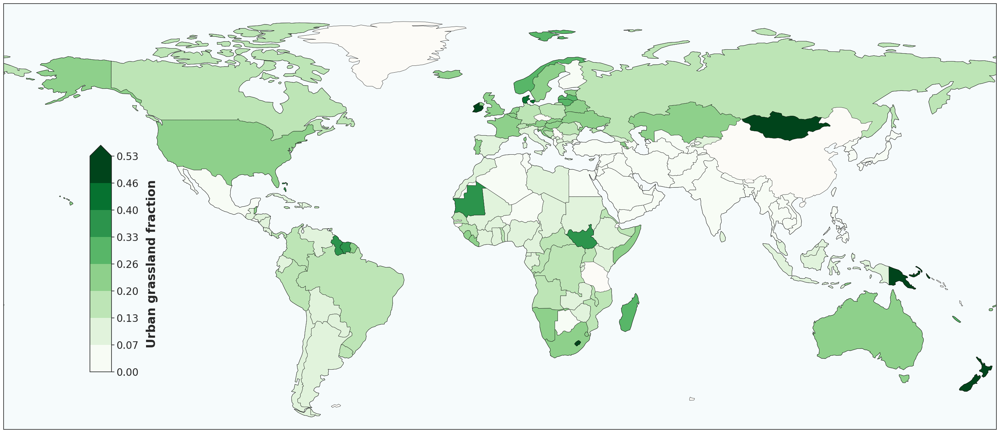

Histogram saved to -> /content/EDFig4A_hist.pdf


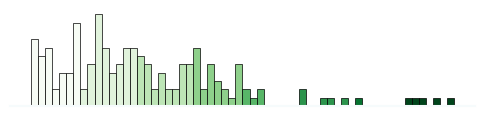

In [13]:
# ------------------------------------------------------------------
# STEP 1: IMPORTS
# ------------------------------------------------------------------
import sys
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm
from matplotlib.cm import ScalarMappable

# ------------------------------------------------------------------
# STEP 2: CONFIGURATION
# ------------------------------------------------------------------
# Paths should be adjusted to your environment (e.g., Colab, local machine).
CSV_PATH        = Path('/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv')
SHAPE_PATH      = Path('/content/ne_110m_admin_0_countries.shp')

# Outputs will be saved in the specified directory.
OUT_DIR         = Path('/content/')
OUT_MAP         = '/content/EDFig4A_map.pdf'
OUT_HIST        = '/content/EDFig4A_hist.pdf'

# --- Parameters ---
MIN_CITIES       = 3
NUM_COLOR_BINS   = 8  # Number of distinct color classes on the map
NUM_HIST_BINS    = 60 # Number of bins for the smaller histogram

# A sequential green colormap suitable for grass cover data.
SEQUENTIAL_CMAP = plt.cm.Greens

# ------------------------------------------------------------------
# HELPER FUNCTION
# ------------------------------------------------------------------
def _std_name(series: pd.Series) -> pd.Series:
    """Standardizes country names for robust merging."""
    return (series.str.lower()
                  .str.replace("&", "and")
                  .str.replace("-", " ")
                  .str.replace("[.,]", "", regex=True)
                  .str.strip())

# ------------------------------------------------------------------
# 1. LOAD CSV + CALCULATE URBAN grass COVER FRACTION
# ------------------------------------------------------------------
if not CSV_PATH.is_file():
    raise FileNotFoundError(f"ERROR: CSV not found -> {CSV_PATH}")

df = pd.read_csv(CSV_PATH, low_memory=False)
# df = df[df["grassland_area_urban"] > 0].copy()

# Define required columns for grass cover analysis
REQ = ["grassland_area_urban", "Urban_Area", "NAME_EN"]

missing = [c for c in REQ if c not in df.columns]
if missing:
    raise ValueError(f"ERROR: missing column(s) {missing!r} in CSV")

# Coerce data to numeric, turning errors into Not-a-Number (NaN)
for col in ["grassland_area_urban", "Urban_Area"]:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Drop rows where essential data is missing
df.dropna(subset=REQ, inplace=True)

# Filter out cities with zero urban area to avoid division by zero
df = df[df["Urban_Area"] > 0].copy()

# Calculate the fraction of urban area covered by grasss
df['grassland_frac'] = df["grassland_area_urban"] / df['Urban_Area']

# ------------------------------------------------------------------
# 2. REQUIRE MIN_CITIES PER COUNTRY & AGGREGATE
# ------------------------------------------------------------------
# Count the number of cities per country
city_counts = df['NAME_EN'].value_counts()

# Keep only countries with a sufficient number of cities
countries_ok = city_counts[city_counts >= MIN_CITIES].index
print(f"Keeping {len(countries_ok)} countries with >= {MIN_CITIES} cities")

# Calculate the mean urban grass cover fraction for each qualifying country
country_urban_grass = (df[df['NAME_EN'].isin(countries_ok)]
                      .groupby('NAME_EN', as_index=False)['grassland_frac']
                      .mean()
                      .rename(columns={'grassland_frac': 'mean_urban_grass_frac'}))

# ------------------------------------------------------------------
# 3. LOAD WORLD SHAPEFILE & MERGE
# ------------------------------------------------------------------
if not SHAPE_PATH.is_file():
    raise FileNotFoundError(f"ERROR: shapefile not found -> {SHAPE_PATH}")

world = gpd.read_file(SHAPE_PATH)
world = world[world.get('ADMIN', '') != 'Antarctica']

# Standardize country names in both dataframes for a clean merge
country_urban_grass['std_name'] = _std_name(country_urban_grass['NAME_EN'])
world['std_name'] = _std_name(world.get('ADMIN', world.get('NAME_EN')))

# Merge the geographic data with the calculated grass cover data
merged = world.merge(country_urban_grass[['std_name', 'mean_urban_grass_frac']],
                     how='left', on='std_name').dropna(subset=['mean_urban_grass_frac'])

if merged.empty:
    raise RuntimeError("ERROR: no countries matched between CSV and shapefile.")

# ------------------------------------------------------------------
# 4. DISCRETE SEQUENTIAL COLOUR SCALE
# ------------------------------------------------------------------
vals = merged['mean_urban_grass_frac'].to_numpy()

# Set vmin and vmax to the min and max of your data
vmin, vmax = vals.min(), vals.max()

# Ensure bounds are within the valid range for fractions [0, 1]
vmin = max(vmin, 0.0)
vmax = min(vmax, 1.0)

# Create discrete boundaries for the color bins
bounds = np.linspace(vmin, vmax, NUM_COLOR_BINS + 1)
norm   = BoundaryNorm(bounds, ncolors=SEQUENTIAL_CMAP.N, clip=True)

# ------------------------------------------------------------------
# 5. CHOROPLETH MAP
# ------------------------------------------------------------------
fig, ax = plt.subplots(figsize=(30, 18), subplot_kw={'projection': ccrs.PlateCarree()})
ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')
ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')

# Plot the merged data, coloring countries by grass cover fraction
merged.plot(column='mean_urban_grass_frac', cmap=SEQUENTIAL_CMAP, norm=norm,
            ax=ax, edgecolor='black', linewidth=0.4,
            missing_kwds={'color': 'lightgrey', 'label': 'No data'})

ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

# --- Color Bar ---
cbar_ax = fig.add_axes([0.13, 0.27, 0.02, 0.35])
sm = ScalarMappable(norm=norm, cmap=SEQUENTIAL_CMAP); sm._A = []
cbar = plt.colorbar(sm, cax=cbar_ax, orientation='vertical', extend='max')
cbar.set_label('Urban grassland fraction', fontsize=24, labelpad=15, fontweight='bold')

# Set ticks to the calculated bin edges for clarity
cbar.set_ticks(bounds)
cbar.set_ticklabels([f'{b:.2f}' for b in bounds])
cbar.ax.tick_params(labelsize=20)

plt.subplots_adjust(left=0.05, right=0.97, top=0.97, bottom=0.05)
plt.savefig(OUT_MAP, bbox_inches='tight', format='pdf', transparent=True)
print(f"Map saved to -> {OUT_MAP}")
plt.show()

# ------------------------------------------------------------------
# 6. MINIMALIST HISTOGRAM
# ------------------------------------------------------------------
def minimalist_hist(series: pd.Series, bounds_arr, bins, cmap_obj, path):
    """Creates a minimalist histogram with bars colored by value."""
    # Use the same normalization as the map for visual consistency
    norm_hist = BoundaryNorm(bounds_arr, ncolors=cmap_obj.N, clip=True)

    # Clip series to the same bounds as the map
    series = series.clip(lower=bounds_arr[0], upper=bounds_arr[-1])
    if series.empty:
        print("No data in histogram range – skipped."); return

    fig, ax = plt.subplots(figsize=(6, 1.25))

    counts, edges, patches = ax.hist(
        series,
        bins=np.linspace(bounds_arr[0], bounds_arr[-1], bins + 1),
        edgecolor='black', linewidth=0.5
    )

    # Color each histogram bar based on its value
    for p, l, r in zip(patches, edges[:-1], edges[1:]):
        p.set_facecolor(cmap_obj(norm_hist((l + r) / 2)))

    # Strip axes for minimalist look
    ax.set_xticks([]); ax.set_yticks([])
    for s in ax.spines.values(): s.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbfc')
    ax.spines['bottom'].set_linewidth(1.5)

    fig.patch.set_alpha(0); ax.patch.set_alpha(0)
    plt.savefig(path, bbox_inches='tight', format='pdf', transparent=True)
    print(f"Histogram saved to -> {path}")
    plt.show()

# Generate the histogram with data and styling from the map
minimalist_hist(
    series=merged['mean_urban_grass_frac'],
    bounds_arr=bounds,
    bins=NUM_HIST_BINS,
    cmap_obj=SEQUENTIAL_CMAP,
    path=OUT_HIST
)

Keeping 167 countries with ≥3 cities for analysis.


/tmp/ipython-input-3187630635.py:147: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .groupby('NAME_EN', as_index=False).apply(_aggregate_country))



Top 3 — weighted urban grassland fraction (μ̄_u)
         NAME_EN  n_cities  urban_frac_country
        Mongolia      80.0            0.490016
         Lesotho       5.0            0.426616
Papua New Guinea      43.0            0.408234

Bottom 3 — weighted urban grassland fraction (μ̄_u)
     NAME_EN  n_cities  urban_frac_country
      Kuwait      18.0            0.001059
Saudi Arabia     274.0            0.001617
       Egypt     421.0            0.003364

Top 3 — weighted rural grassland fraction (μ̄_r)
 NAME_EN  n_cities  rural_frac_country
Mongolia      80.0            0.617807
 Lesotho       5.0            0.592820
 Ireland      97.0            0.577184

Bottom 3 — weighted rural grassland fraction (μ̄_r)
     NAME_EN  n_cities  rural_frac_country
      Kuwait      18.0            0.001770
       Qatar      30.0            0.002026
Saudi Arabia     274.0            0.002036

Most positive 3 — weighted (urban − rural) grassland difference (μ̄_Δ)
         NAME_EN  n_cities  mean_d

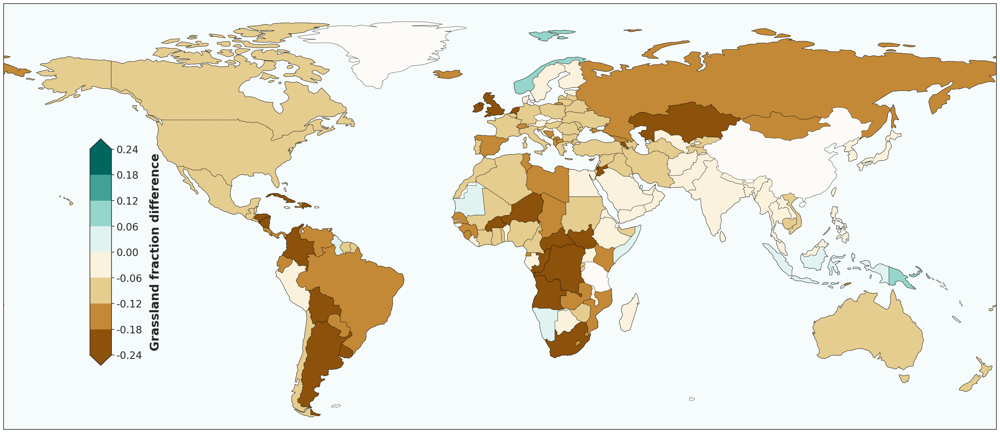

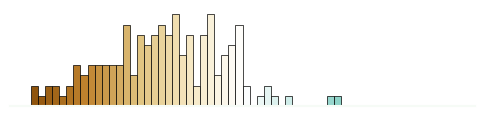

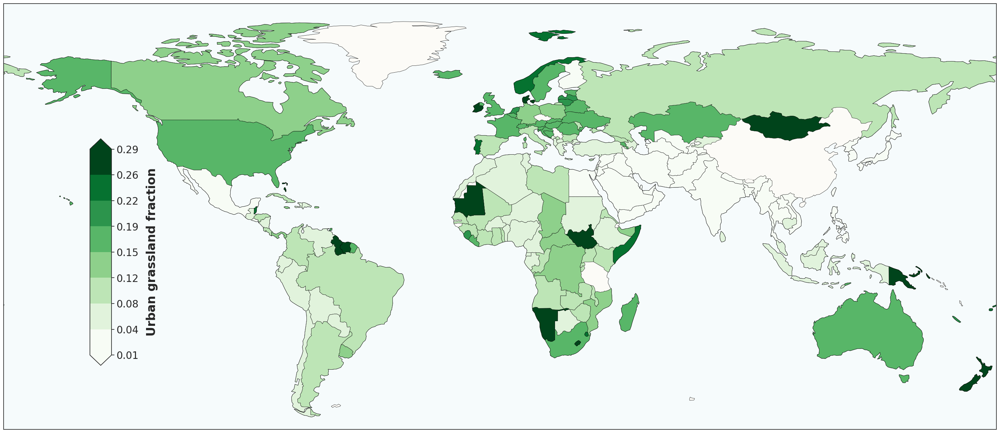

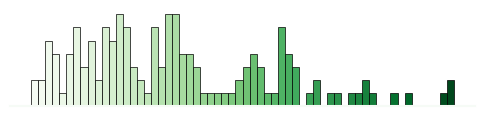

In [14]:
import sys
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import LinearSegmentedColormap, BoundaryNorm
from matplotlib.cm import ScalarMappable
from scipy import stats

# ------------------------------ CONFIG ---------------------------------------
CSV_PATH    = Path('/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv')
SHAPE_PATH  = Path('/content/ne_110m_admin_0_countries.shp')

OUT_DIR        = Path('/content/')
OUT_MAP_DIFF   = str(OUT_DIR / 'Sup_grass_country_diff_Map.pdf')
OUT_HIST_DIFF  = str(OUT_DIR / 'Sup_grass_country_diff_Hist.pdf')
OUT_MAP_UABS   = str(OUT_DIR / 'Sup_grass_country_abs_Map.pdf')
OUT_HIST_UABS  = str(OUT_DIR / 'Sup_grass_country_abs_Hist.pdf')

MIN_CITIES       = 3
NUM_COLOR_BINS   = 8
NUM_HIST_BINS    = 60

# Palettes
DIVERGING_COLS  = ['#8c510a','#bf812d','#dfc27d','#f6e8c3','#ffffff','#c7eae5','#80cdc1','#35978f','#01665e']
SEQUENTIAL_COLS = ['#f7fcf5','#e5f5e0','#c7e9c0','#a1d99b','#74c476','#41ab5d','#238b45','#006d2c','#00441b']

# ------------------------------ HELPERS --------------------------------------
def _std_name(series: pd.Series) -> pd.Series:
    return (series.str.lower()
                 .str.replace("&","and")
                 .str.replace("-", " ")
                 .str.replace("[.,]", "", regex=True)
                 .str.strip())

def _kish_weighted_mean_se(x: np.ndarray, w: np.ndarray):
    """Return (mu_w, se_w, n_eff, n_raw, W_sum)."""
    x = np.asarray(x, float); w = np.asarray(w, float)
    m = np.isfinite(x) & np.isfinite(w) & (w > 0)
    x, w = x[m], w[m]
    n_raw = int(x.size)
    if n_raw == 0:
        return (np.nan, np.nan, 0.0, 0, 0.0)
    W = float(w.sum())
    mu_w = float((w * x).sum() / W)
    w2 = float((w * w).sum())
    n_eff = (W * W) / w2 if w2 > 0 else 0.0
    var_w = float((w * (x - mu_w) ** 2).sum() / W)
    se_w = float(np.sqrt(var_w / max(n_eff, 1.0))) if np.isfinite(var_w) else np.nan
    return (mu_w, se_w, n_eff, n_raw, W)

def _build_discrete_norm(bounds, colors):
    cmap = LinearSegmentedColormap.from_list('custom', colors, N=256)
    norm = BoundaryNorm(bounds, ncolors=256)
    return cmap, norm

def _styled_map(world_gdf, column, bounds, colors, out_path, label):
    cmap, norm = _build_discrete_norm(bounds, colors)
    fig, ax = plt.subplots(figsize=(30, 18),
                           subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')

    world_gdf.plot(column=column, cmap=cmap, norm=norm,
                   ax=ax, edgecolor='black', linewidth=0.4,
                   missing_kwds={'color':'lightgrey','label':'No data'})

    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())
    cbar_ax = fig.add_axes([0.13, 0.27, 0.02, 0.35])
    sm = ScalarMappable(norm=norm, cmap=cmap); sm._A = []
    cbar = plt.colorbar(sm, cax=cbar_ax, orientation='vertical', extend='both')
    cbar.set_label(label, fontsize=24, labelpad=15, fontweight='bold')
    cbar.set_ticks(bounds)
    cbar.set_ticklabels([f'{b:.2f}' for b in bounds])
    cbar.ax.tick_params(labelsize=20)

    plt.subplots_adjust(left=0.05, right=0.97, top=0.95, bottom=0.05)
    OUT_DIR.mkdir(parents=True, exist_ok=True)
    plt.savefig(out_path, dpi=400, bbox_inches='tight', format='pdf', transparent=True)
    plt.show()

def _minimalist_hist(series: pd.Series, bounds_arr, bins, colors, out_path):
    series = series[(series >= bounds_arr[0]) & (series <= bounds_arr[-1])]
    if series.empty:
        print("No data in histogram range – skipped."); return
    cmap, _ = _build_discrete_norm(bounds_arr, colors)
    norm_h = plt.Normalize(vmin=bounds_arr[0], vmax=bounds_arr[-1])
    fig, ax = plt.subplots(figsize=(6, 1.25))
    counts, edges, patches = ax.hist(series,
                                     bins=np.linspace(bounds_arr[0], bounds_arr[-1], bins + 1),
                                     edgecolor='black', linewidth=0.5)
    for p, l, r in zip(patches, edges[:-1], edges[1:]):
        p.set_facecolor(cmap(norm_h((l + r) / 2)))
    ax.set_xticks([]); ax.set_yticks([])
    for s in ax.spines.values(): s.set_visible(False)
    ax.spines['bottom'].set_visible(True); ax.spines['bottom'].set_color('#f6fbf6'); ax.spines['bottom'].set_linewidth(1.5)
    fig.patch.set_alpha(0); ax.patch.set_alpha(0)
    plt.savefig(out_path, dpi=400, bbox_inches='tight', format='pdf', transparent=True)
    plt.show()

# ------------------------------ LOAD & PREP ----------------------------------
if not CSV_PATH.is_file():
    sys.exit(f"ERROR: CSV not found → {CSV_PATH}")
df = pd.read_csv(CSV_PATH, low_memory=False)

REQ = ["grassland_area_urban","grassland_area_rural","Urban_Area","Buffer_area","NAME_EN"]
missing = [c for c in REQ if c not in df.columns]
if missing:
    sys.exit(f"ERROR: missing column(s) {missing!r} in CSV")

for col in ["grassland_area_urban","grassland_area_rural","Urban_Area","Buffer_area"]:
    df[col] = pd.to_numeric(df[col], errors='coerce')

df.dropna(subset=REQ, inplace=True)
df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()

df['urban_frac'] = df['grassland_area_urban'] / df['Urban_Area']
df['rural_frac'] = df['grassland_area_rural'] / df['Buffer_area']
df['diff']       = df['urban_frac'] - df['rural_frac']
df['w_diff']     = df['Urban_Area'] + df['Buffer_area']  # for diff weighting

# ------------------------- COUNTRY AGGREGATION (WEIGHTED) ---------------------
counts = df['NAME_EN'].value_counts()
countries_ok = counts[counts >= MIN_CITIES].index
print(f"Keeping {len(countries_ok)} countries with ≥{MIN_CITIES} cities for analysis.")

def _aggregate_country(g: pd.DataFrame) -> pd.Series:
    mu_u, se_u, n_eff_u, _, W_u = _kish_weighted_mean_se(g['urban_frac'].to_numpy(),
                                                         g['Urban_Area'].to_numpy())
    mu_r, se_r, n_eff_r, _, W_r = _kish_weighted_mean_se(g['rural_frac'].to_numpy(),
                                                         g['Buffer_area'].to_numpy())
    mu_d, se_d, n_eff_d, n_raw, W_d = _kish_weighted_mean_se(g['diff'].to_numpy(),
                                                             g['w_diff'].to_numpy())
    return pd.Series({
        'urban_frac_country' : mu_u,   'urban_se_country' : se_u, 'urban_neff_country' : n_eff_u, 'urban_W' : W_u,
        'rural_frac_country' : mu_r,   'rural_se_country' : se_r, 'rural_neff_country' : n_eff_r, 'rural_W' : W_r,
        'mean_diff_country'  : mu_d,   'diff_se_country'  : se_d, 'diff_neff_country'  : n_eff_d, 'diff_W'  : W_d,
        'n_cities'           : int(n_raw)
    })

country = (df[df['NAME_EN'].isin(countries_ok)]
           .groupby('NAME_EN', as_index=False).apply(_aggregate_country))

if country.empty:
    sys.exit("ERROR: No countries after weighted aggregation.")

# ------------------ PRINT REQUESTED TOP/BOTTOM SUMMARIES ----------------------
def _print_table(title: str, subdf: pd.DataFrame, cols: list[str]):
    print(f"\n{title}")
    print(subdf[cols].to_string(index=False))

# Top/Bottom by weighted urban grassland fraction
urban_cols = ['NAME_EN','n_cities','urban_frac_country']
top3_urban = country.nlargest(3, 'urban_frac_country')[urban_cols]
bot3_urban = country.nsmallest(3, 'urban_frac_country')[urban_cols]
_print_table("Top 3 — weighted urban grassland fraction (μ̄_u)", top3_urban, urban_cols)
_print_table("Bottom 3 — weighted urban grassland fraction (μ̄_u)", bot3_urban, urban_cols)

# Top/Bottom by weighted rural grassland fraction (useful for context)
rural_cols = ['NAME_EN','n_cities','rural_frac_country']
top3_rural = country.nlargest(3, 'rural_frac_country')[rural_cols]
bot3_rural = country.nsmallest(3, 'rural_frac_country')[rural_cols]
_print_table("Top 3 — weighted rural grassland fraction (μ̄_r)", top3_rural, rural_cols)
_print_table("Bottom 3 — weighted rural grassland fraction (μ̄_r)", bot3_rural, rural_cols)

# Most positive / most negative by weighted difference
diff_cols = ['NAME_EN','n_cities','mean_diff_country']
pos3_diff = country.nlargest(3, 'mean_diff_country')[diff_cols]
neg3_diff = country.nsmallest(3, 'mean_diff_country')[diff_cols]
_print_table("Most positive 3 — weighted (urban − rural) grassland difference (μ̄_Δ)", pos3_diff, diff_cols)
_print_table("Most negative 3 — weighted (urban − rural) grassland difference (μ̄_Δ)", neg3_diff, diff_cols)

# ------------------ ACROSS-COUNTRY SUMMARY (optional console) ----------------
u_series, u_wts = country['urban_frac_country'].astype(float), country['urban_W'].astype(float)
r_series, r_wts = country['rural_frac_country'].astype(float), country['rural_W'].astype(float)
d_series, d_wts = country['mean_diff_country'].astype(float), country['diff_W'].astype(float)

mu_u_w, se_u_w, n_eff_u_all, _, _ = _kish_weighted_mean_se(u_series.to_numpy(), u_wts.to_numpy())
mu_r_w, se_r_w, n_eff_r_all, _, _ = _kish_weighted_mean_se(r_series.to_numpy(), r_wts.to_numpy())
mu_d_w, se_d_w, n_eff_d_all, _, _ = _kish_weighted_mean_se(d_series.to_numpy(), d_wts.to_numpy())

print("\nAcross-country weighted means (console):")
print(f"  Urban μ̄_u={mu_u_w:.4f} (SE={se_u_w:.4f}, n_eff={n_eff_u_all:.1f})")
print(f"  Rural μ̄_r={mu_r_w:.4f} (SE={se_r_w:.4f}, n_eff={n_eff_r_all:.1f})")
print(f"  Diff  μ̄_Δ={mu_d_w:.4f} (SE={se_d_w:.4f}, n_eff={n_eff_d_all:.1f})")

# ------------------------------ MAPS (optional) ------------------------------
if not SHAPE_PATH.is_file():
    sys.exit(f"ERROR: shapefile not found → {SHAPE_PATH}")

world = gpd.read_file(SHAPE_PATH)
world = world[world.get('ADMIN', '') != 'Antarctica']
country['std_name'] = _std_name(country['NAME_EN'])
world['std_name']   = _std_name(world.get('ADMIN', world.get('NAME_EN')))

# Difference map
merged_diff = world.merge(country[['std_name','mean_diff_country']], how='left', on='std_name').dropna(subset=['mean_diff_country'])
if not merged_diff.empty:
    vals_d = merged_diff['mean_diff_country'].to_numpy()
    abs_lim_d = max(np.percentile(np.abs(vals_d), 95), 0.1)
    bounds_d = np.linspace(-abs_lim_d, abs_lim_d, NUM_COLOR_BINS + 1)
    _styled_map(merged_diff, 'mean_diff_country', bounds_d, DIVERGING_COLS,
                out_path=OUT_MAP_DIFF, label='Grassland fraction difference')
    _minimalist_hist(merged_diff['mean_diff_country'], bounds_d, NUM_HIST_BINS, DIVERGING_COLS, OUT_HIST_DIFF)
else:
    print("[WARN] No countries matched the shapefile for difference map.")

# Urban absolute map
merged_uabs = world.merge(country[['std_name','urban_frac_country']], how='left', on='std_name').dropna(subset=['urban_frac_country'])
if not merged_uabs.empty:
    vals_u = merged_uabs['urban_frac_country'].to_numpy()
    low_u, high_u = max(0.0, np.percentile(vals_u, 5)), min(1.0, np.percentile(vals_u, 95))
    bounds_u = np.linspace(low_u, high_u, NUM_COLOR_BINS + 1)
    _styled_map(merged_uabs, 'urban_frac_country', bounds_u, SEQUENTIAL_COLS,
                out_path=OUT_MAP_UABS, label='Urban grassland fraction')
    _minimalist_hist(merged_uabs['urban_frac_country'], bounds_u, NUM_HIST_BINS, SEQUENTIAL_COLS, OUT_HIST_UABS)
else:
    print("[WARN] No countries matched the shapefile for urban absolute map.")


/tmp/ipython-input-452394989.py:313: DtypeWarning: Columns (57,59,60,62,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)



Map saved to: /content/drive/MyDrive/UrbanVegetation/FiguresV2/EDFig5A.pdf
Summary stats saved to: /content/drive/MyDrive/UrbanVegetation/FiguresV2/EDFig5A__summary_stats.csv


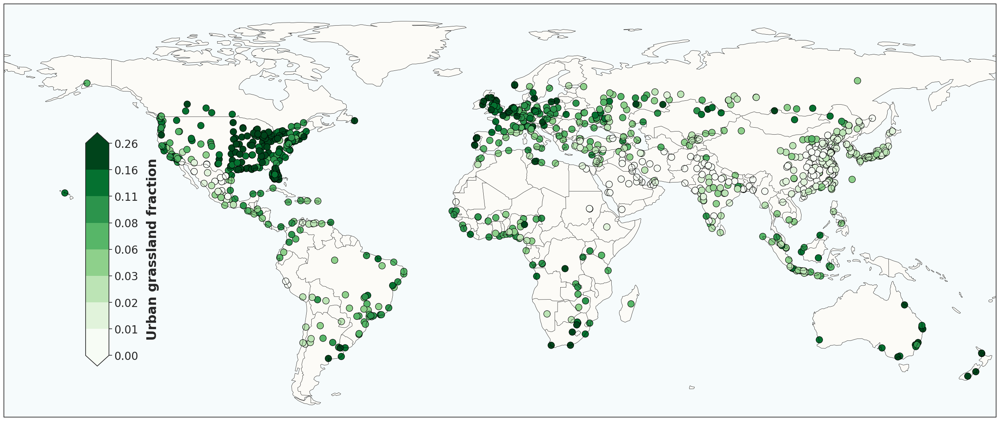

Histogram saved → /content/drive/MyDrive/UrbanVegetation/FiguresV2/EDFig5A_hist.pdf


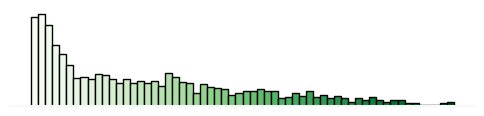

In [15]:
import os
import sys
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd  # not used below but kept since you had it
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm

# ====================== Stats helpers ======================

def _safe_stats(series: pd.Series) -> dict:
    """Return n, mean, and stderr for a numeric series."""
    s = pd.to_numeric(series, errors="coerce").dropna()
    n = int(s.shape[0])
    if n == 0:
        return {"n": 0, "mean": np.nan, "stderr": np.nan}
    if n >= 2:
        std = float(s.std(ddof=1))
        stderr = std / math.sqrt(n)
    else:
        std = 0.0
        stderr = float("nan")
    return {"n": n, "mean": float(s.mean()), "stderr": float(stderr)}

def _write_summary_csv(summary_df: pd.DataFrame, output_path: str) -> str:
    """Write the summary table next to the figure if output_path is provided."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    os.makedirs(out_dir, exist_ok=True)
    base = os.path.splitext(os.path.basename(output_path))[0]
    csv_path = os.path.join(out_dir, f"{base}__summary_stats.csv")
    summary_df.to_csv(csv_path, index=False)
    return csv_path

def _hist_path_from(output_path: str) -> str:
    """Build a sibling histogram path from the map output path."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    base = os.path.splitext(os.path.basename(output_path))[0]
    return os.path.join(out_dir, f"{base}_hist.pdf")

# ====================== Breaks engine ======================

def _nice_number(x: float, round_: bool = True) -> float:
    """
    Return a 'nice' number approximately equal to x.
    R-like pretty helper: 1, 2, or 5 times a power of 10.
    """
    if x <= 0 or not np.isfinite(x):
        return 0.0
    expv = math.floor(math.log10(x))
    f = x / 10**expv  # between [1, 10)
    if round_:
        if f < 1.5:
            nf = 1
        elif f < 3:
            nf = 2
        elif f < 7:
            nf = 5
        else:
            nf = 10
    else:
        if f <= 1:
            nf = 1
        elif f <= 2:
            nf = 2
        elif f <= 5:
            nf = 5
        else:
            nf = 10
    return nf * 10**expv

def pretty_breaks(data_min: float, data_max: float, n_classes: int) -> np.ndarray:
    """
    Compute 'pretty' equal-interval breaks with rounded tick marks.
    """
    if not np.isfinite(data_min) or not np.isfinite(data_max):
        raise ValueError("Non-finite data range for pretty breaks.")
    if data_min == data_max:
        # Degenerate: expand a tiny bit
        delta = abs(data_min) if data_min != 0 else 1.0
        data_min -= 0.5 * delta
        data_max += 0.5 * delta

    raw_step = (data_max - data_min) / max(1, n_classes)
    step = _nice_number(raw_step, round_=True)
    lo = math.floor(data_min / step) * step
    hi = math.ceil(data_max / step) * step
    k = int(round((hi - lo) / step))
    # Ensure k == n_classes; if not, we still return nice ticks covering range
    bounds = lo + step * np.arange(k + 1)
    if len(bounds) < n_classes + 1:
        # extend one more on the high end if needed
        bounds = np.append(bounds, bounds[-1] + step)
    elif len(bounds) > n_classes + 1:
        # thin (keep endpoints and downsample internal ticks)
        keep_idx = np.linspace(0, len(bounds) - 1, num=n_classes + 1, dtype=int)
        bounds = bounds[keep_idx]
    return bounds.astype(float)

def quantile_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    qs = np.linspace(0.0, 1.0, n_classes + 1)
    return np.quantile(values, qs)

def equal_breaks(dmin: float, dmax: float, n_classes: int) -> np.ndarray:
    return np.linspace(dmin, dmax, n_classes + 1)

def jenks_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    """
    Fisher–Jenks optimal breaks (O(n*k) DP). No external deps.
    Returns sorted bounds length n_classes+1 (min..max).
    """
    x = np.sort(values[np.isfinite(values)])
    n = x.size
    k = max(1, n_classes)

    if n == 0:
        raise ValueError("No finite values for Jenks.")
    if k >= n:
        # Every value its own class; fall back to unique edges
        return np.unique(np.concatenate(([x[0]], x))).astype(float)

    # Precompute cumulative sums for fast variance ranges
    csum = np.zeros(n + 1)
    csum2 = np.zeros(n + 1)
    csum[1:] = np.cumsum(x)
    csum2[1:] = np.cumsum(x * x)

    def range_var(i: int, j: int) -> float:
        # variance of x[i..j] inclusive
        m = j - i + 1
        s = csum[j + 1] - csum[i]
        s2 = csum2[j + 1] - csum2[i]
        mean = s / m
        return s2 - m * mean * mean

    # DP tables
    mat = np.full((k + 1, n), np.inf)  # variance
    idx = np.full((k + 1, n), -1, dtype=int)  # split index
    for i in range(n):
        mat[1, i] = range_var(0, i)
        idx[1, i] = 0

    for kk in range(2, k + 1):
        for i in range(kk - 1, n):
            best = np.inf
            best_j = -1
            j_start = kk - 2
            j_end = i - 1
            for j in range(j_start, j_end + 1):
                v = mat[kk - 1, j] + range_var(j + 1, i)
                if v < best:
                    best = v
                    best_j = j
            mat[kk, i] = best
            idx[kk, i] = best_j

    # backtrack to get class edges
    breaks_idx = [n - 1]
    kk = k
    last = n - 1
    while kk > 1:
        j = idx[kk, last]
        breaks_idx.append(j)
        last = j
        kk -= 1
    breaks_idx.append(-1)
    breaks_idx = sorted(breaks_idx)

    bounds = [x[0]]
    for a, b in zip(breaks_idx[:-1], breaks_idx[1:]):
        bounds.append(x[b + 1])
    bounds[-1] = x[-1]
    return np.array(bounds, dtype=float)

def compute_bounds(values: np.ndarray,
                   n_classes: int = 8,
                   method: str = "quantile",
                   robust_clip: bool = True,
                   low_pct: float = 2.0,
                   high_pct: float = 98.0) -> np.ndarray:
    """
    Compute class bounds for a 1-D numeric array.
    """
    v = values[np.isfinite(values)]
    if v.size == 0:
        raise ValueError("No finite values to compute bounds.")

    # Optional robust clipping
    if robust_clip:
        lo = np.percentile(v, low_pct)
        hi = np.percentile(v, high_pct)
        v = v[(v >= lo) & (v <= hi)]
        if v.size == 0:
            raise ValueError("All values removed by robust clipping.")

    dmin, dmax = float(v.min()), float(v.max())
    if dmin == dmax:
        # Expand a touch to avoid zero-width bins
        eps = 1e-6 * (abs(dmin) + 1.0)
        dmin -= eps
        dmax += eps

    method = method.lower()
    if method == "quantile":
        bounds = quantile_breaks(v, n_classes)
    elif method == "equal":
        bounds = equal_breaks(dmin, dmax, n_classes)
    elif method == "pretty":
        bounds = pretty_breaks(dmin, dmax, n_classes)
    elif method == "jenks":
        try:
            bounds = jenks_breaks(v, n_classes)
        except Exception:
            # Fallback if DP fails for pathological inputs
            bounds = quantile_breaks(v, n_classes)
    else:
        raise ValueError(f"Unknown break method: {method}")

    # Ensure strictly increasing & unique (collapse tiny diffs)
    bounds = np.array(bounds, dtype=float)
    bounds[0] = min(bounds[0], dmin)
    bounds[-1] = max(bounds[-1], dmax)
    bounds = np.unique(np.round(bounds, 10))
    if bounds.size < 2:
        # guard
        bounds = np.array([dmin, dmax], dtype=float)
    return bounds

# ====================== Minimalist histogram ======================

def create_frequency_histogram(
    data_series: pd.Series,
    lower_bound: float,
    upper_bound: float,
    num_bins: int,
    cmap,
    out_path: str
) -> None:
    """
    Draw a minimalist frequency histogram, coloring each bar by the
    continuous colormap at the bin mid-point. Transparent background,
    hidden ticks/spines except a subtle bottom spine.
    """
    try:
        s = pd.to_numeric(data_series, errors="coerce").dropna()
        filtered = s[(s >= lower_bound) & (s <= upper_bound)]
    except Exception as e:
        print(f"Histogram input error: {e}")
        return

    if filtered.empty:
        print("No data in bounds for histogram.")
        return

    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)
    norm = plt.Normalize(vmin=lower_bound, vmax=upper_bound)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        _, bin_edges, patches = ax.hist(filtered, bins=bins, edgecolor='black')
    except Exception as e:
        print(f"Error generating histogram: {e}")
        plt.close(fig)
        return

    # Color bars by bin mid-point
    for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
        mid = 0.5 * (left + right)
        patch.set_facecolor(cmap(norm(mid)))

    # Minimal look
    ax.set_xticks([]); ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbf7')
    ax.spines['bottom'].set_linewidth(1.5)
    fig.patch.set_alpha(0)
    ax.patch.set_alpha(0)

    try:
        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram saved → {out_path}")
    except Exception as e:
        print(f"Error saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)

# ====================== Main plotting ======================

def analyze_and_plot_combined(file_path,
                              output_path,
                              n_classes: int = 8,
                              break_method: str = "quantile",
                              robust_clip: bool = True,
                              pct_low: float = 2.0,
                              pct_high: float = 98.0,
                              hist_bins: int = 60):
    """
    Loads data, computes urban grassland fraction, maps it with chosen breaks,
    and writes a palette-matched minimalist histogram beside the map.
    """
    # 1) Load & validate
    try:
        df = pd.read_csv(file_path)
        df = df.nlargest(1000, 'Urban_Area').copy()
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # 2) Required columns
    required_columns = [
        "grassland_area_urban", "Urban_Area", "Buffer_area", "lat", "lon"
    ]
    for col in required_columns:
        if col not in df.columns:
            raise ValueError(f"Required column '{col}' not found in data.")
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=required_columns)

    # 3) Denominators and fractions
    df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()
    if df.empty:
        raise RuntimeError("No rows with Urban_Area > 0 AND Buffer_area > 0.")

    df["grassland_fraction_urban"] = (
        df["grassland_area_urban"] / df["Urban_Area"]
    ).clip(lower=0, upper=1)  # defensive clip to [0,1]

    # 4) Compute class bounds with chosen method
    vals = df["grassland_fraction_urban"].to_numpy()
    bounds = compute_bounds(
        vals,
        n_classes=n_classes,
        method=break_method,
        robust_clip=robust_clip,
        low_pct=pct_low,
        high_pct=pct_high
    )

    # If robust clipping removed tails, reflect via extend on colorbar
    extend = "neither"
    if robust_clip:
        vmin_raw, vmax_raw = float(np.nanmin(vals)), float(np.nanmax(vals))
        if bounds[0] > vmin_raw and bounds[-1] < vmax_raw:
            extend = "both"
        elif bounds[0] > vmin_raw:
            extend = "min"
        elif bounds[-1] < vmax_raw:
            extend = "max"

    # 5) Colormap & norm (discrete for the map)
    n_bins = max(1, len(bounds) - 1)
    cmap_seq_discrete = plt.get_cmap('Greens', n_bins)
    norm_seq = BoundaryNorm(boundaries=bounds, ncolors=n_bins, clip=False)

    # 6) Plot (map)
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5)
    ax.add_feature(cfeature.OCEAN, facecolor="lightblue", alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor="#fcfbf7")
    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    sc = ax.scatter(
        df["lon"], df["lat"],
        c=df["grassland_fraction_urban"],
        cmap=cmap_seq_discrete, norm=norm_seq,
        s=150, edgecolors="black", linewidths=0.8,
        transform=ccrs.PlateCarree()
    )

    # 7) Colorbar
    cax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cb = plt.colorbar(sc, cax=cax, orientation="vertical", extend=extend)
    cb.set_label("Urban grassland fraction", fontsize=24, labelpad=15, weight="bold")
    cb.ax.tick_params(labelsize=20)
    cb.set_ticks(bounds)
    cb.set_ticklabels([f"{b:.2f}" for b in bounds])

    # 8) Summary CSV (optional)
    summary = {
        "metric": ["grassland_fraction_urban"],
        **_safe_stats(df["grassland_fraction_urban"])
    }
    summary_df = pd.DataFrame([summary])
    csv_out = _write_summary_csv(summary_df, output_path)

    # 9) Save map
    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)
    if output_path:
        os.makedirs(os.path.dirname(output_path), exist_ok=True)
        try:
            plt.savefig(output_path, dpi=400, bbox_inches="tight", format='pdf', transparent=True)
            print(f"\nMap saved to: {output_path}")
            if csv_out:
                print(f"Summary stats saved to: {csv_out}")
        except Exception as e:
            print(f"Error saving map: {e}")
    plt.show()

    # 10) Histogram using a *continuous* version of the same palette & bounds
    # Use a high-resolution continuous colormap seeded from 'Greens'
    cmap_seq_cont = plt.get_cmap('Greens')
    hist_out = _hist_path_from(output_path)
    if hist_out:
        create_frequency_histogram(
            data_series=df["grassland_fraction_urban"],
            lower_bound=bounds[0],
            upper_bound=bounds[-1],
            num_bins=hist_bins,
            cmap=cmap_seq_cont,
            out_path=hist_out
        )

# ====================== CLI ======================

if __name__ == "__main__":
    FILE_PATH = "/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv"
    OUTPUT_DIR = "/content/drive/MyDrive/UrbanVegetation/FiguresV2/"
    OUTPUT_FILE = os.path.join(OUTPUT_DIR, "EDFig5A.pdf")

    # User-tunable parameters
    N_CLASSES    = 8
    BREAK_METHOD = "quantile"  # options: 'quantile', 'equal', 'pretty', 'jenks'
    ROBUST_CLIP  = True        # clip to percentiles before computing breaks
    PCT_LOW      = 2.0
    PCT_HIGH     = 98.0
    HIST_BINS    = 60

    try:
        analyze_and_plot_combined(
            file_path=FILE_PATH,
            output_path=OUTPUT_FILE,
            n_classes=N_CLASSES,
            break_method=BREAK_METHOD,
            robust_clip=ROBUST_CLIP,
            pct_low=PCT_LOW,
            pct_high=PCT_HIGH,
            hist_bins=HIST_BINS
        )
    except (FileNotFoundError, ValueError, RuntimeError) as e:
        print(f"An error occurred: {e}", file=sys.stderr)
        sys.exit(1)


/tmp/ipython-input-2337912484.py:313: DtypeWarning: Columns (57,59,60,62,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)



Map saved to: /content/SDF1A.pdf
Summary stats saved to: /content/SDF1A__summary_stats.csv


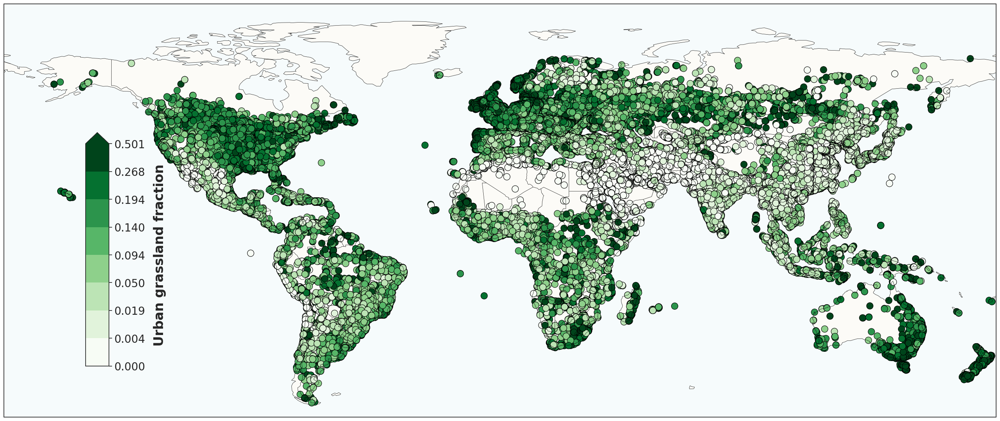

Histogram saved → /content/SDF1A__hist.pdf


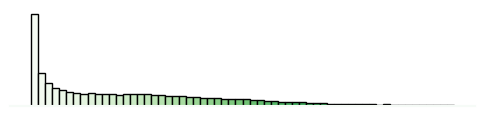

In [16]:
import os
import sys
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd  # not used below but kept since you had it
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm

# ====================== Stats helpers ======================

def _safe_stats(series: pd.Series) -> dict:
    """Return n, mean, and stderr for a numeric series."""
    s = pd.to_numeric(series, errors="coerce").dropna()
    n = int(s.shape[0])
    if n == 0:
        return {"n": 0, "mean": np.nan, "stderr": np.nan}
    if n >= 2:
        std = float(s.std(ddof=1))
        stderr = std / math.sqrt(n)
    else:
        std = 0.0
        stderr = float("nan")
    return {"n": n, "mean": float(s.mean()), "stderr": float(stderr)}

def _write_summary_csv(summary_df: pd.DataFrame, output_path: str) -> str:
    """Write the summary table next to the figure if output_path is provided."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    os.makedirs(out_dir, exist_ok=True)
    base = os.path.splitext(os.path.basename(output_path))[0]
    csv_path = os.path.join(out_dir, f"{base}__summary_stats.csv")
    summary_df.to_csv(csv_path, index=False)
    return csv_path

def _hist_path_from(output_path: str) -> str:
    """Build a sibling histogram path from the map output path."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    base = os.path.splitext(os.path.basename(output_path))[0]
    return os.path.join(out_dir, f"{base}__hist.pdf")

# ====================== Breaks engine ======================

def _nice_number(x: float, round_: bool = True) -> float:
    """
    Return a 'nice' number approximately equal to x.
    R-like pretty helper: 1, 2, or 5 times a power of 10.
    """
    if x <= 0 or not np.isfinite(x):
        return 0.0
    expv = math.floor(math.log10(x))
    f = x / 10**expv  # between [1, 10)
    if round_:
        if f < 1.5:
            nf = 1
        elif f < 3:
            nf = 2
        elif f < 7:
            nf = 5
        else:
            nf = 10
    else:
        if f <= 1:
            nf = 1
        elif f <= 2:
            nf = 2
        elif f <= 5:
            nf = 5
        else:
            nf = 10
    return nf * 10**expv

def pretty_breaks(data_min: float, data_max: float, n_classes: int) -> np.ndarray:
    """
    Compute 'pretty' equal-interval breaks with rounded tick marks.
    """
    if not np.isfinite(data_min) or not np.isfinite(data_max):
        raise ValueError("Non-finite data range for pretty breaks.")
    if data_min == data_max:
        # Degenerate: expand a tiny bit
        delta = abs(data_min) if data_min != 0 else 1.0
        data_min -= 0.5 * delta
        data_max += 0.5 * delta

    raw_step = (data_max - data_min) / max(1, n_classes)
    step = _nice_number(raw_step, round_=True)
    lo = math.floor(data_min / step) * step
    hi = math.ceil(data_max / step) * step
    k = int(round((hi - lo) / step))
    # Ensure k == n_classes; if not, we still return nice ticks covering range
    bounds = lo + step * np.arange(k + 1)
    if len(bounds) < n_classes + 1:
        # extend one more on the high end if needed
        bounds = np.append(bounds, bounds[-1] + step)
    elif len(bounds) > n_classes + 1:
        # thin (keep endpoints and downsample internal ticks)
        keep_idx = np.linspace(0, len(bounds) - 1, num=n_classes + 1, dtype=int)
        bounds = bounds[keep_idx]
    return bounds.astype(float)

def quantile_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    qs = np.linspace(0.0, 1.0, n_classes + 1)
    return np.quantile(values, qs)

def equal_breaks(dmin: float, dmax: float, n_classes: int) -> np.ndarray:
    return np.linspace(dmin, dmax, n_classes + 1)

def jenks_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    """
    Fisher–Jenks optimal breaks (O(n*k) DP). No external deps.
    Returns sorted bounds length n_classes+1 (min..max).
    """
    x = np.sort(values[np.isfinite(values)])
    n = x.size
    k = max(1, n_classes)

    if n == 0:
        raise ValueError("No finite values for Jenks.")
    if k >= n:
        # Every value its own class; fall back to unique edges
        return np.unique(np.concatenate(([x[0]], x))).astype(float)

    # Precompute cumulative sums for fast variance ranges
    csum = np.zeros(n + 1)
    csum2 = np.zeros(n + 1)
    csum[1:] = np.cumsum(x)
    csum2[1:] = np.cumsum(x * x)

    def range_var(i: int, j: int) -> float:
        # variance of x[i..j] inclusive
        m = j - i + 1
        s = csum[j + 1] - csum[i]
        s2 = csum2[j + 1] - csum2[i]
        mean = s / m
        return s2 - m * mean * mean

    # DP tables
    mat = np.full((k + 1, n), np.inf)  # variance
    idx = np.full((k + 1, n), -1, dtype=int)  # split index
    for i in range(n):
        mat[1, i] = range_var(0, i)
        idx[1, i] = 0

    for kk in range(2, k + 1):
        for i in range(kk - 1, n):
            best = np.inf
            best_j = -1
            j_start = kk - 2
            j_end = i - 1
            for j in range(j_start, j_end + 1):
                v = mat[kk - 1, j] + range_var(j + 1, i)
                if v < best:
                    best = v
                    best_j = j
            mat[kk, i] = best
            idx[kk, i] = best_j

    # backtrack to get class edges
    breaks_idx = [n - 1]
    kk = k
    last = n - 1
    while kk > 1:
        j = idx[kk, last]
        breaks_idx.append(j)
        last = j
        kk -= 1
    breaks_idx.append(-1)
    breaks_idx = sorted(breaks_idx)

    bounds = [x[0]]
    for a, b in zip(breaks_idx[:-1], breaks_idx[1:]):
        bounds.append(x[b + 1])
    bounds[-1] = x[-1]
    return np.array(bounds, dtype=float)

def compute_bounds(values: np.ndarray,
                   n_classes: int = 8,
                   method: str = "quantile",
                   robust_clip: bool = True,
                   low_pct: float = 2.0,
                   high_pct: float = 98.0) -> np.ndarray:
    """
    Compute class bounds for a 1-D numeric array.
    """
    v = values[np.isfinite(values)]
    if v.size == 0:
        raise ValueError("No finite values to compute bounds.")

    # Optional robust clipping
    if robust_clip:
        lo = np.percentile(v, low_pct)
        hi = np.percentile(v, high_pct)
        v = v[(v >= lo) & (v <= hi)]
        if v.size == 0:
            raise ValueError("All values removed by robust clipping.")

    dmin, dmax = float(v.min()), float(v.max())
    if dmin == dmax:
        # Expand a touch to avoid zero-width bins
        eps = 1e-6 * (abs(dmin) + 1.0)
        dmin -= eps
        dmax += eps

    method = method.lower()
    if method == "quantile":
        bounds = quantile_breaks(v, n_classes)
    elif method == "equal":
        bounds = equal_breaks(dmin, dmax, n_classes)
    elif method == "pretty":
        bounds = pretty_breaks(dmin, dmax, n_classes)
    elif method == "jenks":
        try:
            bounds = jenks_breaks(v, n_classes)
        except Exception:
            # Fallback if DP fails for pathological inputs
            bounds = quantile_breaks(v, n_classes)
    else:
        raise ValueError(f"Unknown break method: {method}")

    # Ensure strictly increasing & unique (collapse tiny diffs)
    bounds = np.array(bounds, dtype=float)
    bounds[0] = min(bounds[0], dmin)
    bounds[-1] = max(bounds[-1], dmax)
    bounds = np.unique(np.round(bounds, 10))
    if bounds.size < 2:
        # guard
        bounds = np.array([dmin, dmax], dtype=float)
    return bounds

# ====================== Minimalist histogram ======================

def create_frequency_histogram(
    data_series: pd.Series,
    lower_bound: float,
    upper_bound: float,
    num_bins: int,
    cmap,
    out_path: str
) -> None:
    """
    Draw a minimalist frequency histogram, coloring each bar by the
    continuous colormap at the bin mid-point. Transparent background,
    hidden ticks/spines except a subtle bottom spine.
    """
    try:
        s = pd.to_numeric(data_series, errors="coerce").dropna()
        filtered = s[(s >= lower_bound) & (s <= upper_bound)]
    except Exception as e:
        print(f"Histogram input error: {e}")
        return

    if filtered.empty:
        print("No data in bounds for histogram.")
        return

    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)
    norm = plt.Normalize(vmin=lower_bound, vmax=upper_bound)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        _, bin_edges, patches = ax.hist(filtered, bins=bins, edgecolor='black')
    except Exception as e:
        print(f"Error generating histogram: {e}")
        plt.close(fig)
        return

    # Color bars by bin mid-point
    for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
        mid = 0.5 * (left + right)
        patch.set_facecolor(cmap(norm(mid)))

    # Minimal look
    ax.set_xticks([]); ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbf7')
    ax.spines['bottom'].set_linewidth(1.5)
    fig.patch.set_alpha(0)
    ax.patch.set_alpha(0)

    try:
        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram saved → {out_path}")
    except Exception as e:
        print(f"Error saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)

# ====================== Main plotting ======================

def analyze_and_plot_combined(file_path,
                              output_path,
                              n_classes: int = 8,
                              break_method: str = "quantile",
                              robust_clip: bool = True,
                              pct_low: float = 2.0,
                              pct_high: float = 98.0,
                              hist_bins: int = 60):
    """
    Loads data, computes urban grassland fraction, maps it with chosen breaks,
    and writes a palette-matched minimalist histogram beside the map.
    """
    # 1) Load & validate
    try:
        df = pd.read_csv(file_path)
        # df = df.nlargest(1000, 'Urban_Area').copy()
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # 2) Required columns
    required_columns = [
        "grassland_area_urban", "Urban_Area", "Buffer_area", "lat", "lon"
    ]
    for col in required_columns:
        if col not in df.columns:
            raise ValueError(f"Required column '{col}' not found in data.")
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=required_columns)

    # 3) Denominators and fractions
    df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()
    if df.empty:
        raise RuntimeError("No rows with Urban_Area > 0 AND Buffer_area > 0.")

    df["grassland_fraction_urban"] = (
        df["grassland_area_urban"] / df["Urban_Area"]
    ).clip(lower=0.0001, upper=1)  # defensive clip to [0,1]

    # 4) Compute class bounds with chosen method
    vals = df["grassland_fraction_urban"].to_numpy()
    bounds = compute_bounds(
        vals,
        n_classes=n_classes,
        method=break_method,
        robust_clip=robust_clip,
        low_pct=pct_low,
        high_pct=pct_high
    )

    # If robust clipping removed tails, reflect via extend on colorbar
    extend = "neither"
    if robust_clip:
        vmin_raw, vmax_raw = float(np.nanmin(vals)), float(np.nanmax(vals))
        if bounds[0] > vmin_raw and bounds[-1] < vmax_raw:
            extend = "both"
        elif bounds[0] > vmin_raw:
            extend = "min"
        elif bounds[-1] < vmax_raw:
            extend = "max"

    # 5) Colormap & norm (discrete for the map)
    n_bins = max(1, len(bounds) - 1)
    cmap_seq_discrete = plt.get_cmap('Greens', n_bins)
    norm_seq = BoundaryNorm(boundaries=bounds, ncolors=n_bins, clip=False)

    # 6) Plot (map)
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5)
    ax.add_feature(cfeature.OCEAN, facecolor="lightblue", alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor="#fcfbf7")
    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    sc = ax.scatter(
        df["lon"], df["lat"],
        c=df["grassland_fraction_urban"],
        cmap=cmap_seq_discrete, norm=norm_seq,
        s=150, edgecolors="black", linewidths=0.8,
        transform=ccrs.PlateCarree()
    )

    # 7) Colorbar
    cax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cb = plt.colorbar(sc, cax=cax, orientation="vertical", extend=extend)
    cb.set_label("Urban grassland fraction", fontsize=24, labelpad=15, weight="bold")
    cb.ax.tick_params(labelsize=20)
    cb.set_ticks(bounds)
    cb.set_ticklabels([f"{b:.3f}" for b in bounds])

    # 8) Summary CSV (optional)
    summary = {
        "metric": ["grassland_fraction_urban"],
        **_safe_stats(df["grassland_fraction_urban"])
    }
    summary_df = pd.DataFrame([summary])
    csv_out = _write_summary_csv(summary_df, output_path)

    # 9) Save map
    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)
    if output_path:
        os.makedirs(os.path.dirname(output_path), exist_ok=True)
        try:
            plt.savefig(output_path, dpi=400, bbox_inches="tight", format='pdf', transparent=True)
            print(f"\nMap saved to: {output_path}")
            if csv_out:
                print(f"Summary stats saved to: {csv_out}")
        except Exception as e:
            print(f"Error saving map: {e}")
    plt.show()

    # 10) Histogram using a *continuous* version of the same palette & bounds
    # Use a high-resolution continuous colormap seeded from 'Greens'
    cmap_seq_cont = plt.get_cmap('Greens')
    hist_out = _hist_path_from(output_path)
    if hist_out:
        create_frequency_histogram(
            data_series=df["grassland_fraction_urban"],
            lower_bound=bounds[0],
            upper_bound=bounds[-1],
            num_bins=hist_bins,
            cmap=cmap_seq_cont,
            out_path=hist_out
        )

# ====================== CLI ======================

if __name__ == "__main__":
    FILE_PATH = "/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv"
    OUTPUT_DIR = "/content/"
    OUTPUT_FILE = os.path.join(OUTPUT_DIR, "SDF1A.pdf")

    # User-tunable parameters
    N_CLASSES    = 8
    BREAK_METHOD = "quantile"  # options: 'quantile', 'equal', 'pretty', 'jenks'
    ROBUST_CLIP  = True        # clip to percentiles before computing breaks
    PCT_LOW      = 2.0
    PCT_HIGH     = 98.0
    HIST_BINS    = 60

    try:
        analyze_and_plot_combined(
            file_path=FILE_PATH,
            output_path=OUTPUT_FILE,
            n_classes=N_CLASSES,
            break_method=BREAK_METHOD,
            robust_clip=ROBUST_CLIP,
            pct_low=PCT_LOW,
            pct_high=PCT_HIGH,
            hist_bins=HIST_BINS
        )
    except (FileNotFoundError, ValueError, RuntimeError) as e:
        print(f"An error occurred: {e}", file=sys.stderr)
        sys.exit(1)


Map saved → /content/EDFig5A_map.pdf


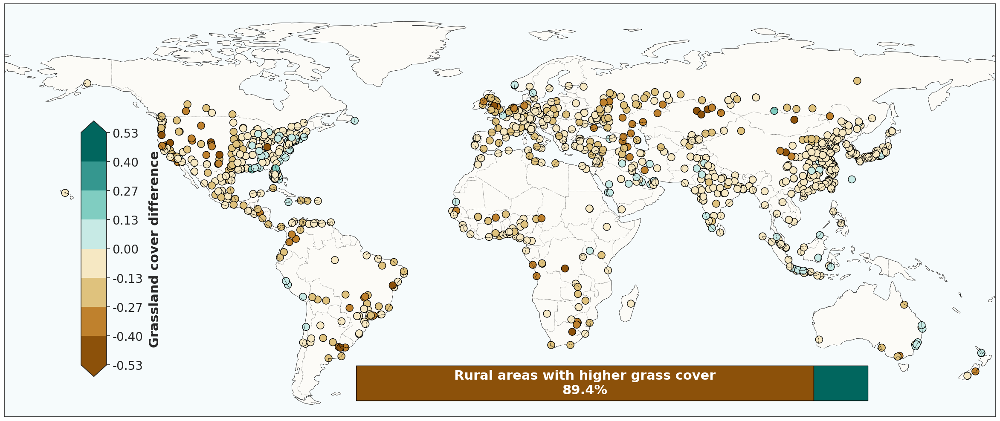

Histogram successfully saved to /content/EDFig5A_hist.pdf


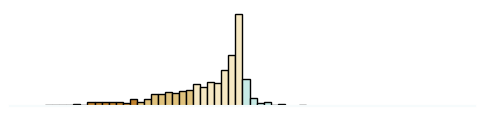

In [17]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import ListedColormap, BoundaryNorm, LinearSegmentedColormap

# -------------------------
# CONFIG (edit if desired)
# -------------------------
INPUT_PATH      = '/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv'
OUT_DIR         = '/content/'
OUT_MAP_PDF     = os.path.join(OUT_DIR, 'EDFig5A_map.pdf')
OUT_HIST_PDF    = os.path.join(OUT_DIR, 'EDFig5A_hist.pdf')
TOP_N_BY_URBAN  = 1000
CLIP_TO_UNIT    = True   # keep only [-1, 1] after normalization
NBINS_HIST      = 60

# Even-length diverging palette (no center white), symmetric around 0 (like your example)
DIVERGING_COLS = [
    '#8c510a', '#bf812d', '#dfc27d', '#f6e8c3',  # negative side (brown-ish)
    '#c7eae5', '#80cdc1', '#35978f', '#01665e'   # positive side (teal-ish)
]
NEG_COLOR = '#8c510a'   # for "rural > urban" bar segment
POS_COLOR = '#01665e'   # for "urban > rural" bar segment

REQUIRED_COLUMNS = [
    'grassland_area_urban', 'grassland_area_rural',
    'Urban_Area', 'Buffer_area', 'lat', 'lon'
]


def _validate_and_cast(df: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    """Ensure required columns exist and are numeric; drop rows with missing."""
    missing = [c for c in REQUIRED_COLUMNS if c not in df.columns]
    if missing:
        raise ValueError(f"Required column(s) missing: {missing}")

    for c in REQUIRED_COLUMNS:
        df[c] = pd.to_numeric(df[c], errors='coerce')

    df = df.dropna(subset=REQUIRED_COLUMNS).copy()

    # Avoid divide-by-zero in normalization
    df = df[(df['Urban_Area'] > 0) & (df['Buffer_area'] > 0)].copy()
    if df.empty:
        raise ValueError("No valid rows after removing zero/NaN areas.")

    return df


def _compute_difference(df: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    """Compute normalized fractions and difference (urban - rural)."""
    df['grassland_urban_normalized'] = df['grassland_area_urban'] / df['Urban_Area']
    df['grassland_rural_normalized'] = df['grassland_area_rural'] / df['Buffer_area']
    df['grassland_difference'] = (
        df['grassland_urban_normalized'] - df['grassland_rural_normalized']
    )
    return df


def _symmetric_bounds(values: np.ndarray, n_colors: int) -> np.ndarray:
    """
    Build symmetric discrete bounds around 0 using an *even* number of colors.
    len(colors)+1 edges => odd number of edges; 0 becomes a boundary internally.
    """
    if n_colors % 2 != 0:
        raise ValueError("DIVERGING_COLS must have an *even* length.")
    if values.size == 0:
        raise ValueError("No values provided for bounds.")
    vmin = np.nanmin(values)
    vmax = np.nanmax(values)
    abs_max = float(max(abs(vmin), abs(vmax), 1e-12))  # guard if all zeros
    return np.linspace(-abs_max, abs_max, n_colors + 1)


def create_frequency_histogram_discrete(
    data_series: pd.Series,
    bounds: np.ndarray,
    cmap_discrete: ListedColormap,
    norm_discrete: BoundaryNorm,
    num_bins: int,
    out_path: str,
) -> None:
    """
    Minimalist frequency histogram of urban–rural differences (or any diff variable).

    - X range is clipped to `bounds[0] .. bounds[-1]`
    - Colors use the SAME discrete colormap + BoundaryNorm as the map/colorbar.
    - Each bar is colored by the discrete class of its bin midpoint.
    """

    lower_bound = float(bounds[0])
    upper_bound = float(bounds[-1])

    # Filter to the same numeric range as the map/cbar
    filtered = data_series[(data_series >= lower_bound) & (data_series <= upper_bound)]
    if filtered.empty:
        print("No data available within specified bounds for histogram.")
        return

    # Histogram bins: many more than the color classes, but within the same range
    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        counts, bin_edges, patches = ax.hist(
            filtered,
            bins=bins,
            edgecolor='black'
        )

        # Color each bin according to its midpoint, using the SAME discrete norm & cmap
        for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
            midpoint = 0.5 * (left + right)
            color = cmap_discrete(norm_discrete(midpoint))  # index into the discrete cmap
            patch.set_facecolor(color)

        # Minimalist styling
        ax.set_xticks([])
        ax.set_yticks([])
        for spine in ax.spines.values():
            spine.set_visible(False)
        ax.spines['bottom'].set_visible(True)
        ax.spines['bottom'].set_color('#f6fbfc')
        ax.spines['bottom'].set_linewidth(1.5)

        fig.patch.set_alpha(0)
        ax.patch.set_alpha(0)

        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram successfully saved to {out_path}")
    except Exception as e:
        print(f"Error generating/saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)


def analyze_grassland_difference(file_path: str):
    """Main analysis + plotting routine."""
    # ---- I/O & validation ----
    try:
        gdf = gpd.read_file(file_path)
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    gdf = _validate_and_cast(gdf)
    gdf = gdf.nlargest(TOP_N_BY_URBAN, 'Urban_Area').copy()
    gdf = _compute_difference(gdf)

    if CLIP_TO_UNIT:
        gdf = gdf[(gdf['grassland_difference'] >= -1) & (gdf['grassland_difference'] <= 1)].copy()

    if gdf.empty:
        raise ValueError("No rows remain after filtering. Check inputs and filters.")

    vals = gdf['grassland_difference'].to_numpy()
    discrete_bounds = _symmetric_bounds(vals, n_colors=len(DIVERGING_COLS))
    cmap_discrete = ListedColormap(DIVERGING_COLS)
    discrete_norm = BoundaryNorm(discrete_bounds, len(DIVERGING_COLS))

    # ---- Map ----
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.LAND,  facecolor='#fcfbf7')
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS,  linewidth=0.5, linestyle=':')

    sc = ax.scatter(
        gdf['lon'], gdf['lat'],
        c=gdf['grassland_difference'],
        cmap=cmap_discrete,
        norm=discrete_norm,
        s=150, alpha=1,
        edgecolors='black', linewidths=1,
        transform=ccrs.PlateCarree()
    )

    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    # Colorbar: ticks = bin edges for clear classing
    cbar_ax = fig.add_axes([0.185, 0.3, 0.02, 0.3])
    cbar = plt.colorbar(sc, cax=cbar_ax, orientation='vertical', extend='both')
    cbar.set_label('Grassland cover difference', fontsize=22, labelpad=10, weight='bold')
    cbar.ax.tick_params(labelsize=20)
    cbar.set_ticks(discrete_bounds)
    cbar.set_ticklabels([f"{x:.2f}" for x in discrete_bounds])

    # ---- Inset stacked bar (Urban-right, Rural-left semantics preserved) ----
    urban_count = int((gdf['grassland_difference'] > 0).sum())
    rural_count = int((gdf['grassland_difference'] < 0).sum())
    total = int(len(gdf))
    if total == 0:
        raise ValueError("No observations available to compute percentages.")

    p_urban = 100.0 * urban_count / total
    p_rural = 100.0 * rural_count / total

    # ---- Inset stacked bar (Rural-left, Urban-right) ----
    bax = fig.add_axes([0.40, 0.27, 0.42, 0.045])
    bax.set_axis_off()

    # Rural segment first (on the left)
    bax.barh([''], [p_rural], color=NEG_COLOR, edgecolor='black', height=0.4)

    # Urban segment stacked after rural (on the right)
    bax.barh([''], [p_urban], color=POS_COLOR, edgecolor='black', height=0.4, left=p_rural)

    # Labels positioned relative to segment centers
    bax.text(p_rural / 2.0, 0,
            f"Rural areas with higher grass cover\n{p_rural:.1f}%",
            ha='center', va='center', fontsize=22, color='white', weight='bold')

    bax.text(p_rural + p_urban / 2.0, 0,
            f"",
            ha='center', va='center', fontsize=22, color='white', weight='bold')


    # ---- Save & show map ----
    os.makedirs(OUT_DIR, exist_ok=True)
    try:
        plt.savefig(OUT_MAP_PDF, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Map saved → {OUT_MAP_PDF}")
    except Exception as e:
        print(f"Error saving map: {e}")
    finally:
        plt.show()
        plt.close(fig)


    create_frequency_histogram_discrete(
        data_series=gdf['grassland_difference'],
        bounds=discrete_bounds,
        cmap_discrete=cmap_discrete,
        norm_discrete=discrete_norm,
        num_bins=NBINS_HIST,
        out_path=OUT_HIST_PDF
    )

if __name__ == "__main__":
    try:
        analyze_grassland_difference(INPUT_PATH)
    except Exception as exc:
        print(f"An error occurred during analysis: {exc}")


Map saved → /content/S2AFig_map.pdf


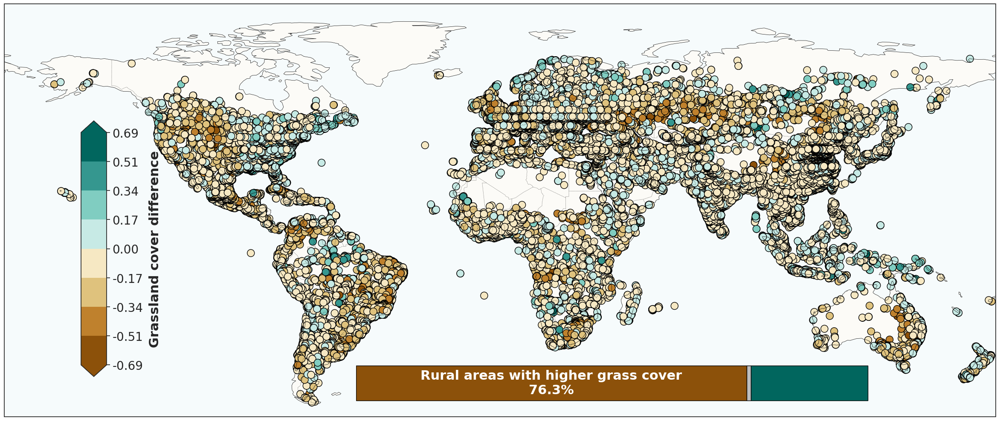

Histogram successfully saved to /content/S2AFig_hist.pdf


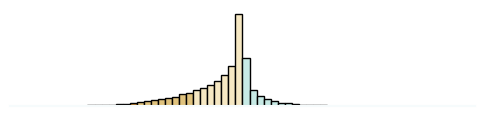

In [18]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import ListedColormap, BoundaryNorm

# -------------------------
# CONFIG (edit if desired)
# -------------------------
INPUT_PATH      = '/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv'
OUT_DIR         = '/content/'
OUT_MAP_PDF     = os.path.join(OUT_DIR, 'S2AFig_map.pdf')
OUT_HIST_PDF    = os.path.join(OUT_DIR, 'S2AFig_hist.pdf')
TOP_N_BY_URBAN  = 83102
CLIP_TO_UNIT    = True   # keep only [-1, 1] after normalization
NBINS_HIST      = 60

# Even-length diverging palette (no center white), symmetric around 0
DIVERGING_COLS = [
    '#8c510a', '#bf812d', '#dfc27d', '#f6e8c3',  # negative side (brown-ish)
    '#c7eae5', '#80cdc1', '#35978f', '#01665e'   # positive side (teal-ish)
]
NEG_COLOR = '#8c510a'   # for "rural > urban" bar segment
POS_COLOR = '#01665e'   # for "urban > rural" bar segment
EQ_COLOR  = '#bdbdbd'   # for "urban == rural" middle bar, if > 0

REQUIRED_COLUMNS = [
    'grassland_area_urban', 'grassland_area_rural',
    'Urban_Area', 'Buffer_area', 'lat', 'lon'
]


def _validate_and_cast(df: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    """Ensure required columns exist and are numeric; drop rows with missing."""
    missing = [c for c in REQUIRED_COLUMNS if c not in df.columns]
    if missing:
        raise ValueError(f"Required column(s) missing: {missing}")

    for c in REQUIRED_COLUMNS:
        df[c] = pd.to_numeric(df[c], errors='coerce')

    df = df.dropna(subset=REQUIRED_COLUMNS).copy()

    # Avoid divide-by-zero in normalization
    df = df[(df['Urban_Area'] > 0) & (df['Buffer_area'] > 0)].copy()
    if df.empty:
        raise ValueError("No valid rows after removing zero/NaN areas.")

    return df


def _compute_difference(df: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    """Compute normalized fractions and difference (urban - rural)."""
    df['grassland_urban_normalized'] = df['grassland_area_urban'] / df['Urban_Area']
    df['grassland_rural_normalized'] = df['grassland_area_rural'] / df['Buffer_area']
    df['grassland_difference'] = (
        df['grassland_urban_normalized'] - df['grassland_rural_normalized']
    )
    return df


def _symmetric_bounds(values: np.ndarray, n_colors: int) -> np.ndarray:
    """
    Build symmetric discrete bounds around 0 using an *even* number of colors.
    len(colors)+1 edges => 0 becomes an internal boundary.
    """
    if n_colors % 2 != 0:
        raise ValueError("DIVERGING_COLS must have an *even* length.")
    if values.size == 0:
        raise ValueError("No values provided for bounds.")
    vmin = np.nanmin(values)
    vmax = np.nanmax(values)
    abs_max = float(max(abs(vmin), abs(vmax), 1e-12))  # guard if all zeros
    return np.linspace(-abs_max, abs_max, n_colors + 1)


def create_frequency_histogram_discrete(
    data_series: pd.Series,
    bounds: np.ndarray,
    cmap_discrete: ListedColormap,
    norm_discrete: BoundaryNorm,
    num_bins: int,
    out_path: str,
) -> None:
    """
    Minimalist frequency histogram of urban–rural differences (or any diff variable).

    - X range is clipped to `bounds[0] .. bounds[-1]`
    - Colors use the SAME discrete colormap + BoundaryNorm as the map/colorbar.
    - Each bar is colored by the discrete class of its bin midpoint.
    """

    lower_bound = float(bounds[0])
    upper_bound = float(bounds[-1])

    # Filter to the same numeric range as the map/cbar
    filtered = data_series[(data_series >= lower_bound) & (data_series <= upper_bound)]
    if filtered.empty:
        print("No data available within specified bounds for histogram.")
        return

    # Histogram bins: many more than the color classes, but within the same range
    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        counts, bin_edges, patches = ax.hist(
            filtered,
            bins=bins,
            edgecolor='black'
        )

        # Color each bin according to its midpoint, using the SAME discrete norm & cmap
        for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
            midpoint = 0.5 * (left + right)
            color = cmap_discrete(norm_discrete(midpoint))  # index into the discrete cmap
            patch.set_facecolor(color)

        # Minimalist styling
        ax.set_xticks([])
        ax.set_yticks([])
        for spine in ax.spines.values():
            spine.set_visible(False)
        ax.spines['bottom'].set_visible(True)
        ax.spines['bottom'].set_color('#f6fbfc')
        ax.spines['bottom'].set_linewidth(1.5)

        fig.patch.set_alpha(0)
        ax.patch.set_alpha(0)

        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram successfully saved to {out_path}")
    except Exception as e:
        print(f"Error generating/saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)


def analyze_grassland_difference(file_path: str):
    """Main analysis + plotting routine."""
    # ---- I/O & validation ----
    try:
        gdf = gpd.read_file(file_path)
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    gdf = _validate_and_cast(gdf)
    gdf = gdf.nlargest(TOP_N_BY_URBAN, 'Urban_Area').copy()
    gdf = _compute_difference(gdf)

    if CLIP_TO_UNIT:
        gdf = gdf[
            (gdf['grassland_difference'] >= -1) &
            (gdf['grassland_difference'] <= 1)
        ].copy()

    if gdf.empty:
        raise ValueError("No rows remain after filtering. Check inputs and filters.")

    # ---- For the MAP only: drop cities with exactly zero difference ----
    gdf_map = gdf[gdf['grassland_difference'] != 0].copy()
    if gdf_map.empty:
        raise ValueError("No non-zero grassland differences for map after filtering.")

    vals = gdf_map['grassland_difference'].to_numpy()
    discrete_bounds = _symmetric_bounds(vals, n_colors=len(DIVERGING_COLS))
    cmap_discrete = ListedColormap(DIVERGING_COLS)
    discrete_norm = BoundaryNorm(discrete_bounds, len(DIVERGING_COLS), clip=True)

    # ---- Map ----
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.LAND,  facecolor='#fcfbf7')
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS,  linewidth=0.5, linestyle=':')

    sc = ax.scatter(
        gdf_map['lon'], gdf_map['lat'],
        c=gdf_map['grassland_difference'],
        cmap=cmap_discrete,
        norm=discrete_norm,
        s=150, alpha=1,
        edgecolors='black', linewidths=1,
        transform=ccrs.PlateCarree()
    )

    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    # Colorbar: ticks = bin edges for clear classing
    cbar_ax = fig.add_axes([0.185, 0.3, 0.02, 0.3])
    cbar = plt.colorbar(sc, cax=cbar_ax, orientation='vertical', extend='both')
    cbar.set_label('Grassland cover difference', fontsize=22, labelpad=10, weight='bold')
    cbar.ax.tick_params(labelsize=20)
    cbar.set_ticks(discrete_bounds)
    cbar.set_ticklabels([f"{x:.2f}" for x in discrete_bounds])

    # ---- Inset stacked bar: use ALL cities (including zeros) ----
    urban_count = int((gdf['grassland_difference'] > 0).sum())
    rural_count = int((gdf['grassland_difference'] < 0).sum())
    equal_count = int((gdf['grassland_difference'] == 0).sum())
    total = int(len(gdf))
    if total == 0:
        raise ValueError("No observations available to compute percentages.")

    p_urban = 100.0 * urban_count / total
    p_rural = 100.0 * rural_count / total
    p_equal = 100.0 * equal_count / total

    bax = fig.add_axes([0.40, 0.27, 0.42, 0.045])
    bax.set_axis_off()

    # Rural segment first (on the left)
    bax.barh([''], [p_rural], color=NEG_COLOR, edgecolor='black', height=0.4)

    # Middle grey segment for U == R (only if > 0)
    if p_equal > 0:
        bax.barh([''], [p_equal], color=EQ_COLOR, edgecolor='black',
                 height=0.4, left=p_rural)
        urban_left = p_rural + p_equal
    else:
        urban_left = p_rural

    # Urban segment stacked after (on the right)
    bax.barh([''], [p_urban], color=POS_COLOR, edgecolor='black',
             height=0.4, left=urban_left)

    # Labels positioned relative to segment centers
    bax.text(p_rural / 2.0, 0,
             f"Rural areas with higher grass cover\n{p_rural:.1f}%",
             ha='center', va='center', fontsize=22, color='white', weight='bold')

    bax.text(urban_left + p_urban / 2.0, 0,
             f"",
             ha='center', va='center', fontsize=22, color='white', weight='bold')

    # ---- Save & show map ----
    os.makedirs(OUT_DIR, exist_ok=True)
    try:
        plt.savefig(OUT_MAP_PDF, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Map saved → {OUT_MAP_PDF}")
    except Exception as e:
        print(f"Error saving map: {e}")
    finally:
        plt.show()
        plt.close(fig)

    # ---- Histogram with the SAME discrete palette as the map ----
    create_frequency_histogram_discrete(
        data_series=gdf['grassland_difference'],
        bounds=discrete_bounds,
        cmap_discrete=cmap_discrete,
        norm_discrete=discrete_norm,
        num_bins=NBINS_HIST,
        out_path=OUT_HIST_PDF
    )


if __name__ == "__main__":
    try:
        analyze_grassland_difference(INPUT_PATH)
    except Exception as exc:
        print(f"An error occurred during analysis: {exc}")


#Cropland

Keeping 167 countries with ≥3 cities for analysis.


/tmp/ipython-input-2609033306.py:145: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .groupby('NAME_EN', as_index=False).apply(_aggregate_country))



Top 3 — weighted urban cropland fraction (μ̄_u)
   NAME_EN  n_cities  urban_frac_country
   Eritrea      39.0            0.462189
     Nepal      21.0            0.281342
Madagascar      43.0            0.274262

Bottom 3 — weighted urban cropland fraction (μ̄_u)
      NAME_EN  n_cities  urban_frac_country
         Fiji       3.0            0.000852
New Caledonia       3.0            0.001317
       Belize       4.0            0.001318

Top 3 — weighted rural cropland fraction (μ̄_r)
    NAME_EN  n_cities  rural_frac_country
 Uzbekistan     521.0            0.471359
    Moldova     571.0            0.464466
North Korea     197.0            0.460491

Bottom 3 — weighted rural cropland fraction (μ̄_r)
         NAME_EN  n_cities  rural_frac_country
Papua New Guinea      43.0            0.001327
           Gabon      19.0            0.001646
     The Bahamas       5.0            0.001758

Most positive 3 — weighted (urban − rural) cropland difference (μ̄_Δ)
   NAME_EN  n_cities  mean_diff

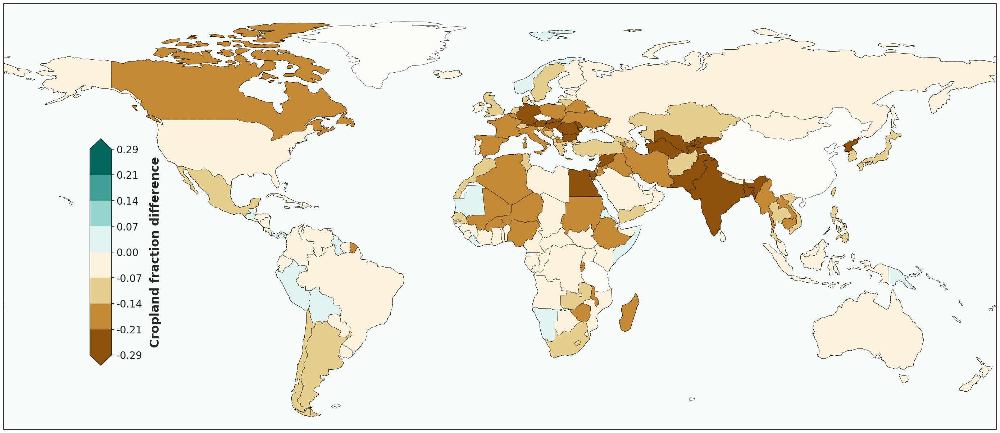

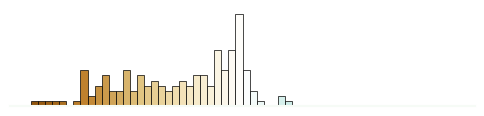

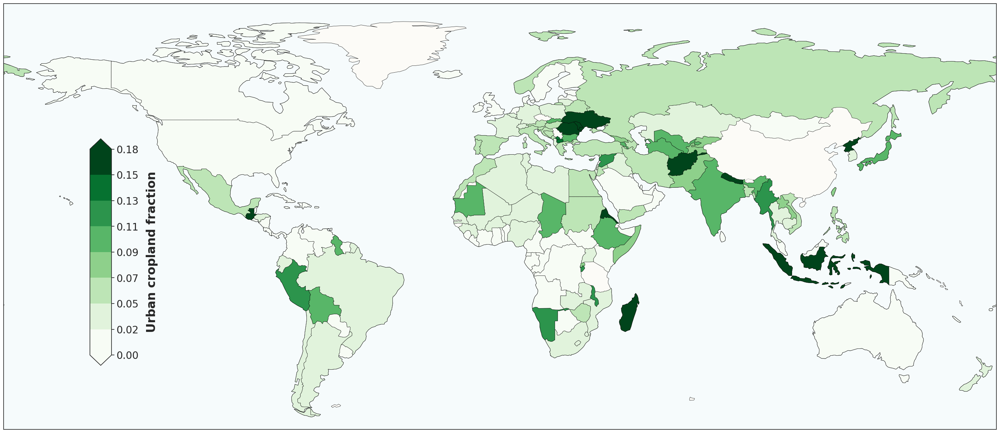

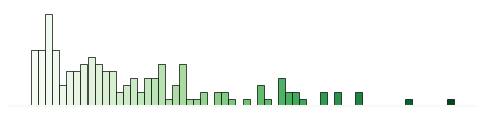

In [19]:
import sys
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import LinearSegmentedColormap, BoundaryNorm
from matplotlib.cm import ScalarMappable

# ------------------------------ CONFIG ---------------------------------------
CSV_PATH    = Path('/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv')
SHAPE_PATH  = Path('/content/ne_110m_admin_0_countries.shp')

OUT_DIR        = Path('/content/')
OUT_MAP_DIFF   = str(OUT_DIR / 'Sup_crop_country_diff_Map.pdf')
OUT_HIST_DIFF  = str(OUT_DIR / 'Sup_crop_country_diff_Hist.pdf')
OUT_MAP_UABS   = str(OUT_DIR / 'Sup_crop_country_abs_Map.pdf')
OUT_HIST_UABS  = str(OUT_DIR / 'Sup_crop_country_abs_Hist.pdf')

MIN_CITIES       = 3
NUM_COLOR_BINS   = 8
NUM_HIST_BINS    = 60

# Palettes (diverging for difference; sequential green for absolute)
DIVERGING_COLS  = ['#8c510a','#bf812d','#dfc27d','#f6e8c3','#ffffff','#c7eae5','#80cdc1','#35978f','#01665e']
SEQUENTIAL_COLS = ['#f7fcf5','#e5f5e0','#c7e9c0','#a1d99b','#74c476','#41ab5d','#238b45','#006d2c','#00441b']

# ------------------------------ HELPERS --------------------------------------
def _std_name(series: pd.Series) -> pd.Series:
    return (series.str.lower()
                 .str.replace("&","and")
                 .str.replace("-", " ")
                 .str.replace("[.,]", "", regex=True)
                 .str.strip())

def _kish_weighted_mean_se(x: np.ndarray, w: np.ndarray):
    """Return (mu_w, se_w, n_eff, n_raw, W_sum)."""
    x = np.asarray(x, float); w = np.asarray(w, float)
    m = np.isfinite(x) & np.isfinite(w) & (w > 0)
    x, w = x[m], w[m]
    n_raw = int(x.size)
    if n_raw == 0:
        return (np.nan, np.nan, 0.0, 0, 0.0)
    W = float(w.sum())
    mu_w = float((w * x).sum() / W)
    w2 = float((w * w).sum())
    n_eff = (W * W) / w2 if w2 > 0 else 0.0
    var_w = float((w * (x - mu_w) ** 2).sum() / W)
    se_w = float(np.sqrt(var_w / max(n_eff, 1.0))) if np.isfinite(var_w) else np.nan
    return (mu_w, se_w, n_eff, n_raw, W)

def _build_discrete_norm(bounds, colors):
    cmap = LinearSegmentedColormap.from_list('custom', colors, N=256)
    norm = BoundaryNorm(bounds, ncolors=256)
    return cmap, norm

def _styled_map(world_gdf, column, bounds, colors, out_path, label):
    cmap, norm = _build_discrete_norm(bounds, colors)
    fig, ax = plt.subplots(figsize=(30, 18),
                           subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')

    world_gdf.plot(column=column, cmap=cmap, norm=norm,
                   ax=ax, edgecolor='black', linewidth=0.4,
                   missing_kwds={'color':'lightgrey','label':'No data'})

    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())
    cbar_ax = fig.add_axes([0.13, 0.27, 0.02, 0.35])
    sm = ScalarMappable(norm=norm, cmap=cmap); sm._A = []
    cbar = plt.colorbar(sm, cax=cbar_ax, orientation='vertical', extend='both')
    cbar.set_label(label, fontsize=24, labelpad=15, fontweight='bold')
    cbar.set_ticks(bounds); cbar.set_ticklabels([f'{b:.2f}' for b in bounds])
    cbar.ax.tick_params(labelsize=20)

    plt.subplots_adjust(left=0.05, right=0.97, top=0.95, bottom=0.05)
    OUT_DIR.mkdir(parents=True, exist_ok=True)
    plt.savefig(out_path, dpi=400, bbox_inches='tight', format='pdf', transparent=True)
    plt.show()

def _minimalist_hist(series: pd.Series, bounds_arr, bins, colors, out_path):
    series = series[(series >= bounds_arr[0]) & (series <= bounds_arr[-1])]
    if series.empty:
        print("No data in histogram range – skipped."); return
    cmap, _ = _build_discrete_norm(bounds_arr, colors)
    norm_h = plt.Normalize(vmin=bounds_arr[0], vmax=bounds_arr[-1])
    fig, ax = plt.subplots(figsize=(6, 1.25))
    counts, edges, patches = ax.hist(series,
                                     bins=np.linspace(bounds_arr[0], bounds_arr[-1], bins + 1),
                                     edgecolor='black', linewidth=0.5)
    for p, l, r in zip(patches, edges[:-1], edges[1:]):
        p.set_facecolor(cmap(norm_h((l + r) / 2)))
    ax.set_xticks([]); ax.set_yticks([])
    for s in ax.spines.values(): s.set_visible(False)
    ax.spines['bottom'].set_visible(True); ax.spines['bottom'].set_color('#f6fbf6'); ax.spines['bottom'].set_linewidth(1.5)
    fig.patch.set_alpha(0); ax.patch.set_alpha(0)
    plt.savefig(out_path, dpi=400, bbox_inches='tight', format='pdf', transparent=True)
    plt.show()

# ------------------------------ LOAD & PREP ----------------------------------
if not CSV_PATH.is_file():
    sys.exit(f"ERROR: CSV not found → {CSV_PATH}")
df = pd.read_csv(CSV_PATH, low_memory=False)

REQ = ["cropland_area_urban","cropland_area_rural","Urban_Area","Buffer_area","NAME_EN"]
missing = [c for c in REQ if c not in df.columns]
if missing:
    sys.exit(f"ERROR: missing column(s) {missing!r} in CSV")

for col in ["cropland_area_urban","cropland_area_rural","Urban_Area","Buffer_area"]:
    df[col] = pd.to_numeric(df[col], errors='coerce')

df.dropna(subset=REQ, inplace=True)
df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()

df['urban_frac'] = df['cropland_area_urban'] / df['Urban_Area']
df['rural_frac'] = df['cropland_area_rural'] / df['Buffer_area']
df['diff']       = df['urban_frac'] - df['rural_frac']
df['w_diff']     = df['Urban_Area'] + df['Buffer_area']  # for diff weighting

# ------------------------- COUNTRY AGGREGATION (WEIGHTED) ---------------------
counts = df['NAME_EN'].value_counts()
countries_ok = counts[counts >= MIN_CITIES].index
print(f"Keeping {len(countries_ok)} countries with ≥{MIN_CITIES} cities for analysis.")

def _aggregate_country(g: pd.DataFrame) -> pd.Series:
    mu_u, se_u, n_eff_u, _, W_u = _kish_weighted_mean_se(g['urban_frac'].to_numpy(),
                                                         g['Urban_Area'].to_numpy())
    mu_r, se_r, n_eff_r, _, W_r = _kish_weighted_mean_se(g['rural_frac'].to_numpy(),
                                                         g['Buffer_area'].to_numpy())
    mu_d, se_d, n_eff_d, n_raw, W_d = _kish_weighted_mean_se(g['diff'].to_numpy(),
                                                             g['w_diff'].to_numpy())
    return pd.Series({
        'urban_frac_country' : mu_u,   'urban_se_country' : se_u, 'urban_neff_country' : n_eff_u, 'urban_W' : W_u,
        'rural_frac_country' : mu_r,   'rural_se_country' : se_r, 'rural_neff_country' : n_eff_r, 'rural_W' : W_r,
        'mean_diff_country'  : mu_d,   'diff_se_country'  : se_d, 'diff_neff_country'  : n_eff_d, 'diff_W'  : W_d,
        'n_cities'           : int(n_raw)
    })

country = (df[df['NAME_EN'].isin(countries_ok)]
           .groupby('NAME_EN', as_index=False).apply(_aggregate_country))

if country.empty:
    sys.exit("ERROR: No countries after weighted aggregation.")

# ------------------ PRINT REQUESTED TOP/BOTTOM SUMMARIES ----------------------
def _print_table(title: str, subdf: pd.DataFrame, cols: list[str]):
    print(f"\n{title}")
    print(subdf[cols].to_string(index=False))

# Top/Bottom by weighted urban cropland fraction
urban_cols = ['NAME_EN','n_cities','urban_frac_country']
top3_urban = country.nlargest(3, 'urban_frac_country')[urban_cols]
bot3_urban = country.nsmallest(3, 'urban_frac_country')[urban_cols]
_print_table("Top 3 — weighted urban cropland fraction (μ̄_u)", top3_urban, urban_cols)
_print_table("Bottom 3 — weighted urban cropland fraction (μ̄_u)", bot3_urban, urban_cols)

# Top/Bottom by weighted rural cropland fraction
rural_cols = ['NAME_EN','n_cities','rural_frac_country']
top3_rural = country.nlargest(3, 'rural_frac_country')[rural_cols]
bot3_rural = country.nsmallest(3, 'rural_frac_country')[rural_cols]
_print_table("Top 3 — weighted rural cropland fraction (μ̄_r)", top3_rural, rural_cols)
_print_table("Bottom 3 — weighted rural cropland fraction (μ̄_r)", bot3_rural, rural_cols)

# Most positive / most negative by weighted difference
diff_cols = ['NAME_EN','n_cities','mean_diff_country']
pos3_diff = country.nlargest(3, 'mean_diff_country')[diff_cols]
neg3_diff = country.nsmallest(3, 'mean_diff_country')[diff_cols]
_print_table("Most positive 3 — weighted (urban − rural) cropland difference (μ̄_Δ)", pos3_diff, diff_cols)
_print_table("Most negative 3 — weighted (urban − rural) cropland difference (μ̄_Δ)", neg3_diff, diff_cols)

# ------------------ ACROSS-COUNTRY SUMMARY (optional console) ----------------
u_series, u_wts = country['urban_frac_country'].astype(float), country['urban_W'].astype(float)
r_series, r_wts = country['rural_frac_country'].astype(float), country['rural_W'].astype(float)
d_series, d_wts = country['mean_diff_country'].astype(float), country['diff_W'].astype(float)

mu_u_w, se_u_w, n_eff_u_all, _, _ = _kish_weighted_mean_se(u_series.to_numpy(), u_wts.to_numpy())
mu_r_w, se_r_w, n_eff_r_all, _, _ = _kish_weighted_mean_se(r_series.to_numpy(), r_wts.to_numpy())
mu_d_w, se_d_w, n_eff_d_all, _, _ = _kish_weighted_mean_se(d_series.to_numpy(), d_wts.to_numpy())

print("\nAcross-country weighted means (console):")
print(f"  Urban μ̄_u={mu_u_w:.4f} (SE={se_u_w:.4f}, n_eff={n_eff_u_all:.1f})")
print(f"  Rural μ̄_r={mu_r_w:.4f} (SE={se_r_w:.4f}, n_eff={n_eff_r_all:.1f})")
print(f"  Diff  μ̄_Δ={mu_d_w:.4f} (SE={se_d_w:.4f}, n_eff={n_eff_d_all:.1f})")

# ------------------------------ MAPS (optional) ------------------------------
if not SHAPE_PATH.is_file():
    sys.exit(f"ERROR: shapefile not found → {SHAPE_PATH}")

world = gpd.read_file(SHAPE_PATH)
world = world[world.get('ADMIN', '') != 'Antarctica']
country['std_name'] = _std_name(country['NAME_EN'])
world['std_name']   = _std_name(world.get('ADMIN', world.get('NAME_EN')))

# Difference map
merged_diff = world.merge(country[['std_name','mean_diff_country']], how='left', on='std_name').dropna(subset=['mean_diff_country'])
if not merged_diff.empty:
    vals_d = merged_diff['mean_diff_country'].to_numpy()
    abs_lim_d = max(np.percentile(np.abs(vals_d), 95), 0.1)
    bounds_d = np.linspace(-abs_lim_d, abs_lim_d, NUM_COLOR_BINS + 1)
    _styled_map(merged_diff, 'mean_diff_country', bounds_d, DIVERGING_COLS,
                out_path=OUT_MAP_DIFF, label='Cropland fraction difference')
    _minimalist_hist(merged_diff['mean_diff_country'], bounds_d, NUM_HIST_BINS, DIVERGING_COLS, OUT_HIST_DIFF)
else:
    print("[WARN] No countries matched the shapefile for difference map.")

# Urban absolute map
merged_uabs = world.merge(country[['std_name','urban_frac_country']], how='left', on='std_name').dropna(subset=['urban_frac_country'])
if not merged_uabs.empty:
    vals_u = merged_uabs['urban_frac_country'].to_numpy()
    low_u, high_u = max(0.0, np.percentile(vals_u, 5)), min(1.0, np.percentile(vals_u, 95))
    bounds_u = np.linspace(low_u, high_u, NUM_COLOR_BINS + 1)
    _styled_map(merged_uabs, 'urban_frac_country', bounds_u, SEQUENTIAL_COLS,
                out_path=OUT_MAP_UABS, label='Urban cropland fraction')
    _minimalist_hist(merged_uabs['urban_frac_country'], bounds_u, NUM_HIST_BINS, SEQUENTIAL_COLS, OUT_HIST_UABS)
else:
    print("[WARN] No countries matched the shapefile for urban absolute map.")


Keeping 167 countries with >= 3 cities
Map saved to -> /content/Fig2_Country_Urban_crop_Map.png


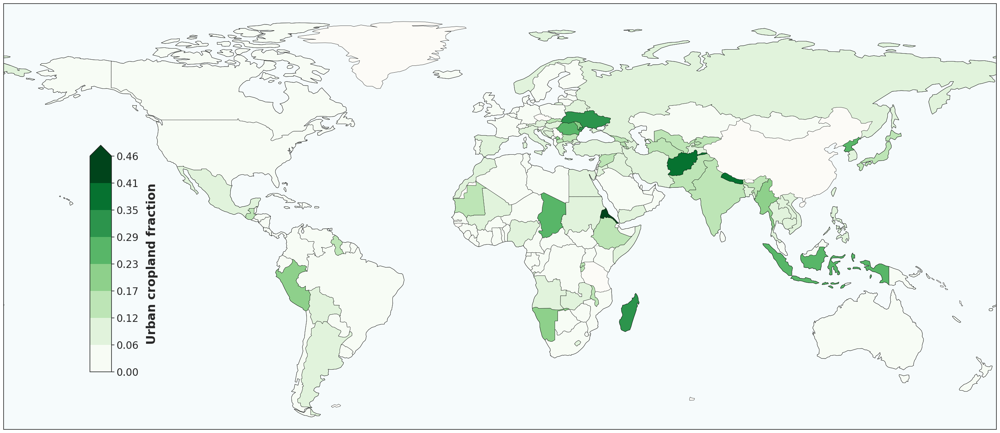

Histogram saved to -> /content/Fig2_Country_Urban_crop_Histogram.png


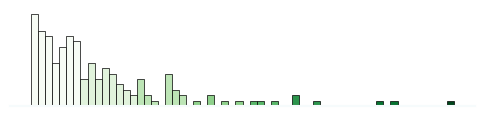

In [20]:
# ------------------------------------------------------------------
# STEP 1: IMPORTS
# ------------------------------------------------------------------
import sys
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm
from matplotlib.cm import ScalarMappable

# ------------------------------------------------------------------
# STEP 2: CONFIGURATION
# ------------------------------------------------------------------
# Paths should be adjusted to your environment (e.g., Colab, local machine).
CSV_PATH        = Path('/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv')
SHAPE_PATH      = Path('/content/ne_110m_admin_0_countries.shp')

# Outputs will be saved in the specified directory.
OUT_DIR         = Path('/content/')
OUT_MAP         = '/content/Fig2_Country_Urban_crop_Map.png'
OUT_HIST        = '/content/Fig2_Country_Urban_crop_Histogram.png'

# --- Parameters ---
MIN_CITIES       = 3
NUM_COLOR_BINS   = 8  # Number of distinct color classes on the map
NUM_HIST_BINS    = 60 # Number of bins for the smaller histogram

# A sequential green colormap suitable for crop cover data.
SEQUENTIAL_CMAP = plt.cm.Greens

# ------------------------------------------------------------------
# HELPER FUNCTION
# ------------------------------------------------------------------
def _std_name(series: pd.Series) -> pd.Series:
    """Standardizes country names for robust merging."""
    return (series.str.lower()
                  .str.replace("&", "and")
                  .str.replace("-", " ")
                  .str.replace("[.,]", "", regex=True)
                  .str.strip())

# ------------------------------------------------------------------
# 1. LOAD CSV + CALCULATE URBAN crop COVER FRACTION
# ------------------------------------------------------------------
if not CSV_PATH.is_file():
    raise FileNotFoundError(f"ERROR: CSV not found -> {CSV_PATH}")

df = pd.read_csv(CSV_PATH, low_memory=False)
# df = df[df["cropland_area_urban"] > 0].copy()

# Define required columns for crop cover analysis
REQ = ["cropland_area_urban", "Urban_Area", "NAME_EN"]

missing = [c for c in REQ if c not in df.columns]
if missing:
    raise ValueError(f"ERROR: missing column(s) {missing!r} in CSV")

# Coerce data to numeric, turning errors into Not-a-Number (NaN)
for col in ["cropland_area_urban", "Urban_Area"]:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Drop rows where essential data is missing
df.dropna(subset=REQ, inplace=True)

# Filter out cities with zero urban area to avoid division by zero
df = df[df["Urban_Area"] > 0].copy()

# Calculate the fraction of urban area covered by crops
df['cropland_frac'] = df["cropland_area_urban"] / df['Urban_Area']

# ------------------------------------------------------------------
# 2. REQUIRE MIN_CITIES PER COUNTRY & AGGREGATE
# ------------------------------------------------------------------
# Count the number of cities per country
city_counts = df['NAME_EN'].value_counts()

# Keep only countries with a sufficient number of cities
countries_ok = city_counts[city_counts >= MIN_CITIES].index
print(f"Keeping {len(countries_ok)} countries with >= {MIN_CITIES} cities")

# Calculate the mean urban crop cover fraction for each qualifying country
country_urban_crop = (df[df['NAME_EN'].isin(countries_ok)]
                      .groupby('NAME_EN', as_index=False)['cropland_frac']
                      .mean()
                      .rename(columns={'cropland_frac': 'mean_urban_crop_frac'}))

# ------------------------------------------------------------------
# 3. LOAD WORLD SHAPEFILE & MERGE
# ------------------------------------------------------------------
if not SHAPE_PATH.is_file():
    raise FileNotFoundError(f"ERROR: shapefile not found -> {SHAPE_PATH}")

world = gpd.read_file(SHAPE_PATH)
world = world[world.get('ADMIN', '') != 'Antarctica']

# Standardize country names in both dataframes for a clean merge
country_urban_crop['std_name'] = _std_name(country_urban_crop['NAME_EN'])
world['std_name'] = _std_name(world.get('ADMIN', world.get('NAME_EN')))

# Merge the geographic data with the calculated crop cover data
merged = world.merge(country_urban_crop[['std_name', 'mean_urban_crop_frac']],
                     how='left', on='std_name').dropna(subset=['mean_urban_crop_frac'])

if merged.empty:
    raise RuntimeError("ERROR: no countries matched between CSV and shapefile.")

# ------------------------------------------------------------------
# 4. DISCRETE SEQUENTIAL COLOUR SCALE
# ------------------------------------------------------------------
vals = merged['mean_urban_crop_frac'].to_numpy()

# Set vmin and vmax to the min and max of your data
vmin, vmax = vals.min(), vals.max()

# Ensure bounds are within the valid range for fractions [0, 1]
vmin = max(vmin, 0.0)
vmax = min(vmax, 1.0)

# Create discrete boundaries for the color bins
bounds = np.linspace(vmin, vmax, NUM_COLOR_BINS + 1)
norm   = BoundaryNorm(bounds, ncolors=SEQUENTIAL_CMAP.N, clip=True)

# ------------------------------------------------------------------
# 5. CHOROPLETH MAP
# ------------------------------------------------------------------
fig, ax = plt.subplots(figsize=(30, 18), subplot_kw={'projection': ccrs.PlateCarree()})
ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')
ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')

# Plot the merged data, coloring countries by crop cover fraction
merged.plot(column='mean_urban_crop_frac', cmap=SEQUENTIAL_CMAP, norm=norm,
            ax=ax, edgecolor='black', linewidth=0.4,
            missing_kwds={'color': 'lightgrey', 'label': 'No data'})

ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

# --- Color Bar ---
cbar_ax = fig.add_axes([0.13, 0.27, 0.02, 0.35])
sm = ScalarMappable(norm=norm, cmap=SEQUENTIAL_CMAP); sm._A = []
cbar = plt.colorbar(sm, cax=cbar_ax, orientation='vertical', extend='max')
cbar.set_label('Urban cropland fraction', fontsize=24, labelpad=15, fontweight='bold')

# Set ticks to the calculated bin edges for clarity
cbar.set_ticks(bounds)
cbar.set_ticklabels([f'{b:.2f}' for b in bounds])
cbar.ax.tick_params(labelsize=20)

plt.subplots_adjust(left=0.05, right=0.97, top=0.97, bottom=0.05)
plt.savefig(OUT_MAP, dpi=400, bbox_inches='tight', format='png', transparent=True)
print(f"Map saved to -> {OUT_MAP}")
plt.show()

# ------------------------------------------------------------------
# 6. MINIMALIST HISTOGRAM
# ------------------------------------------------------------------
def minimalist_hist(series: pd.Series, bounds_arr, bins, cmap_obj, path):
    """Creates a minimalist histogram with bars colored by value."""
    # Use the same normalization as the map for visual consistency
    norm_hist = BoundaryNorm(bounds_arr, ncolors=cmap_obj.N, clip=True)

    # Clip series to the same bounds as the map
    series = series.clip(lower=bounds_arr[0], upper=bounds_arr[-1])
    if series.empty:
        print("No data in histogram range – skipped."); return

    fig, ax = plt.subplots(figsize=(6, 1.25))

    counts, edges, patches = ax.hist(
        series,
        bins=np.linspace(bounds_arr[0], bounds_arr[-1], bins + 1),
        edgecolor='black', linewidth=0.5
    )

    # Color each histogram bar based on its value
    for p, l, r in zip(patches, edges[:-1], edges[1:]):
        p.set_facecolor(cmap_obj(norm_hist((l + r) / 2)))

    # Strip axes for minimalist look
    ax.set_xticks([]); ax.set_yticks([])
    for s in ax.spines.values(): s.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbfc')
    ax.spines['bottom'].set_linewidth(1.5)

    fig.patch.set_alpha(0); ax.patch.set_alpha(0)
    plt.savefig(path, dpi=400, bbox_inches='tight', format='png', transparent=True)
    print(f"Histogram saved to -> {path}")
    plt.show()

# Generate the histogram with data and styling from the map
minimalist_hist(
    series=merged['mean_urban_crop_frac'],
    bounds_arr=bounds,
    bins=NUM_HIST_BINS,
    cmap_obj=SEQUENTIAL_CMAP,
    path=OUT_HIST
)

Keeping 167 countries with ≥3 cities for analysis.

 STATISTICAL SUMMARY OF COUNTRY-LEVEL TREE COVER DIFFERENCE

Overall Statistics for 167 countries:
  - Mean Difference:      -0.0940
  - Standard Deviation:    0.0935

Top 5 Countries (Higher Urban Tree Cover vs. Rural):
   NAME_EN  mean_tree_diff
   Namibia        0.084930
   Eritrea        0.077348
Mauritania        0.076999
    Guyana        0.025980
     Nepal        0.025914

Bottom 5 Countries (Higher Rural Tree Cover vs. Urban):
   NAME_EN  mean_tree_diff
  Slovakia       -0.354179
     Egypt       -0.347916
  Bulgaria       -0.308945
Uzbekistan       -0.304557
     Syria       -0.286202



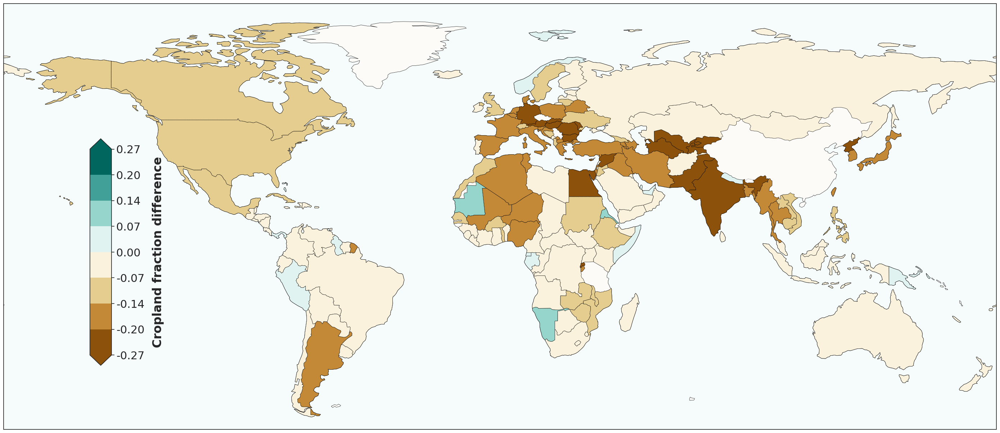

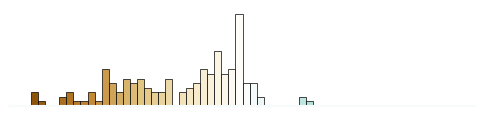

In [21]:
# ------------------------------------------------------------------
# IMPORTS
# ------------------------------------------------------------------
import sys
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import LinearSegmentedColormap, BoundaryNorm
from matplotlib.cm import ScalarMappable

# ------------------------------------------------------------------
# CONFIGURATION – adjust paths & parameters here
# ------------------------------------------------------------------
# Use the CSV with comprehensive vegetation data and country names
CSV_PATH    = Path('/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv')
SHAPE_PATH  = Path('/content/ne_110m_admin_0_countries.shp')

OUT_DIR     = Path('/content/CountryLevelStyled_TreeCover')
# --- Updated output filenames for Tree Cover analysis ---
OUT_MAP     = '/content/Fig2_Country_cropland_Diff_Map.png'
OUT_HIST    = '/content/Fig2_Country_cropland_Diff_Histogram.png'

MIN_CITIES       = 3       # Minimum city count to include a country
NUM_COLOR_BINS   = 8       # An even number yields symmetric bins around zero
NUM_HIST_BINS    = 60

# Diverging palette (brown ↔ white ↔ green)
DIVERGING_COLS = [
    '#8c510a', '#bf812d', '#dfc27d', '#f6e8c3',
    '#ffffff',          # Exact centre (0)
    '#c7eae5', '#80cdc1', '#35978f', '#01665e'
]

# ------------------------------------------------------------------
# HELPER – standardise names for merging
# ------------------------------------------------------------------
def _std_name(series: pd.Series) -> pd.Series:
    """Standardizes country names for robust merging."""
    return (series.str.lower()
                  .str.replace("&", "and")
                  .str.replace("-", " ")
                  .str.replace("[.,]", "", regex=True)
                  .str.strip())

# ------------------------------------------------------------------
# 1. LOAD CSV + CALCULATE TREE COVER DIFFERENCE
# ------------------------------------------------------------------
if not CSV_PATH.is_file():
    sys.exit(f"ERROR: CSV not found → {CSV_PATH}")

df = pd.read_csv(CSV_PATH, low_memory=False)

# --- Define required columns specifically for tree cover fraction ---
REQ = ["cropland_area_urban", "cropland_area_rural", "Urban_Area", "Buffer_area", "NAME_EN"]

missing = [c for c in REQ if c not in df.columns]
if missing:
    sys.exit(f"ERROR: missing column(s) {missing!r} in CSV")

# Ensure all calculation columns are numeric
for col in ["cropland_area_urban", "cropland_area_rural", "Urban_Area", "Buffer_area"]:
    df[col] = pd.to_numeric(df[col], errors='coerce')

df.dropna(subset=REQ, inplace=True)

# --- Calculate tree cover fractions and their difference ---
df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()
df['tree_urban_frac'] = df['cropland_area_urban'] / df['Urban_Area']
df['tree_rural_frac'] = df['cropland_area_rural'] / df['Buffer_area']
df['tree_diff'] = df['tree_urban_frac'] - df['tree_rural_frac']

# ------------------------------------------------------------------
# 2. REQUIRE MIN_CITIES PER COUNTRY & AGGREGATE
# ------------------------------------------------------------------
city_counts = df['NAME_EN'].value_counts()
countries_ok = city_counts[city_counts >= MIN_CITIES].index
print(f"Keeping {len(countries_ok)} countries with ≥{MIN_CITIES} cities for analysis.")

country_tree_diff = (df[df['NAME_EN'].isin(countries_ok)]
                    .groupby('NAME_EN', as_index=False)['tree_diff']
                    .mean()
                    .rename(columns={'tree_diff': 'mean_tree_diff'}))

# ------------------------------------------------------------------
# 2a. COMPUTE AND DISPLAY STATISTICS
# ------------------------------------------------------------------
print("\n" + "="*60)
print(" STATISTICAL SUMMARY OF COUNTRY-LEVEL TREE COVER DIFFERENCE")
print("="*60)

# Calculate overall statistics
mean_diff = country_tree_diff['mean_tree_diff'].mean()
std_diff = country_tree_diff['mean_tree_diff'].std()
country_count = len(country_tree_diff)

print(f"\nOverall Statistics for {country_count} countries:")
print(f"  - Mean Difference:      {mean_diff: .4f}")
print(f"  - Standard Deviation:   {std_diff: .4f}")

# Get Top 5 (Urban tree cover is higher)
top_5 = country_tree_diff.nlargest(5, 'mean_tree_diff')
print("\nTop 5 Countries (Higher Urban Tree Cover vs. Rural):")
print(top_5.to_string(index=False))

# Get Bottom 5 (Rural tree cover is higher)
bottom_5 = country_tree_diff.nsmallest(5, 'mean_tree_diff')
print("\nBottom 5 Countries (Higher Rural Tree Cover vs. Urban):")
print(bottom_5.to_string(index=False))
print("="*60 + "\n")


# ------------------------------------------------------------------
# 3. LOAD WORLD SHAPEFILE & MERGE
# ------------------------------------------------------------------
if not SHAPE_PATH.is_file():
    sys.exit(f"ERROR: shapefile not found → {SHAPE_PATH}")

world = gpd.read_file(SHAPE_PATH)
world = world[world.get('ADMIN', '') != 'Antarctica']

country_tree_diff['std_name'] = _std_name(country_tree_diff['NAME_EN'])
world['std_name'] = _std_name(world.get('ADMIN', world.get('NAME_EN')))

merged = world.merge(country_tree_diff[['std_name', 'mean_tree_diff']],
                     how='left', on='std_name').dropna(subset=['mean_tree_diff'])

if merged.empty:
    sys.exit("ERROR: no countries matched between CSV and shapefile.")

# ------------------------------------------------------------------
# 4. DISCRETE DIVERGING COLOUR SCALE
# ------------------------------------------------------------------
vals = merged['mean_tree_diff'].to_numpy()
abs_lim = np.percentile(np.abs(vals), 95)
abs_lim = max(abs_lim, 0.1)

bounds = np.linspace(-abs_lim, abs_lim, NUM_COLOR_BINS + 1)
cmap   = LinearSegmentedColormap.from_list('tree_div', DIVERGING_COLS, N=256)
norm   = BoundaryNorm(bounds, ncolors=256)

# ------------------------------------------------------------------
# 5. CHOROPLETH MAP
# ------------------------------------------------------------------
fig, ax = plt.subplots(figsize=(30, 18),
                       subplot_kw={'projection': ccrs.PlateCarree()})

ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')
ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')

merged.plot(column='mean_tree_diff', cmap=cmap, norm=norm,
            ax=ax, edgecolor='black', linewidth=0.4,
            missing_kwds={'color': 'lightgrey', 'label': 'No data'})

ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

cbar_ax = fig.add_axes([0.13, 0.27, 0.02, 0.35])
sm = ScalarMappable(norm=norm, cmap=cmap); sm._A = []
cbar = plt.colorbar(sm, cax=cbar_ax, orientation='vertical', extend='both')
# --- Updated colorbar label ---
cbar.set_label('Cropland fraction difference', fontsize=24, labelpad=15, fontweight='bold')
cbar.ax.tick_params(labelsize=20)
cbar.set_ticks(bounds)
cbar.set_ticklabels([f'{b:.2f}' for b in bounds])
cbar.ax.tick_params(labelsize=22)

plt.subplots_adjust(left=0.05, right=0.97, top=0.95, bottom=0.05)
OUT_DIR.mkdir(parents=True, exist_ok=True)
plt.savefig(OUT_MAP, dpi=400, bbox_inches='tight',
            format='png', transparent=True)

plt.show()

# ------------------------------------------------------------------
# 6. MINIMALIST HISTOGRAM (colour‑matched)
# ------------------------------------------------------------------
def minimalist_hist(series: pd.Series, bounds_arr, bins, cmap_obj, path):
    """Creates and saves a minimalist histogram with bars colored by value."""
    series = series[(series >= bounds_arr[0]) & (series <= bounds_arr[-1])]
    if series.empty:
        print("No data in histogram range – skipped."); return

    norm_h = plt.Normalize(vmin=bounds_arr[0], vmax=bounds_arr[-1])
    fig, ax = plt.subplots(figsize=(6, 1.25))

    counts, edges, patches = ax.hist(
        series,
        bins=np.linspace(bounds_arr[0], bounds_arr[-1], bins + 1),
        edgecolor='black', linewidth=0.5
    )

    for p, l, r in zip(patches, edges[:-1], edges[1:]):
        p.set_facecolor(cmap_obj(norm_h((l + r) / 2)))

    ax.set_xticks([]); ax.set_yticks([])
    for s in ax.spines.values(): s.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbfc')
    ax.spines['bottom'].set_linewidth(1.5)

    fig.patch.set_alpha(0); ax.patch.set_alpha(0)
    plt.savefig(path, dpi=400, bbox_inches='tight',
                format='png', transparent=True)
    # print(f"Styled histogram saved → {path.resolve()}")
    plt.show()

# Generate the histogram with data and styling from the map
minimalist_hist(
    series=merged['mean_tree_diff'],
    bounds_arr=bounds,
    bins=NUM_HIST_BINS,
    cmap_obj=cmap,
    path=OUT_HIST
)

/tmp/ipython-input-2354255645.py:263: DtypeWarning: Columns (57,59,60,62,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)



Map saved to: /content/EDFig4B.pdf
Summary stats saved to: /content/EDFig4B__summary_stats.csv


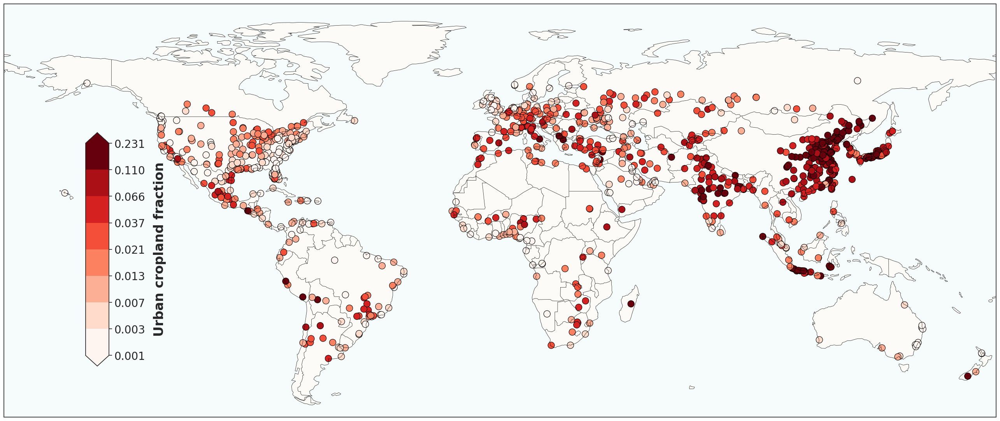

Histogram saved → /content/EDFig4B__hist.pdf


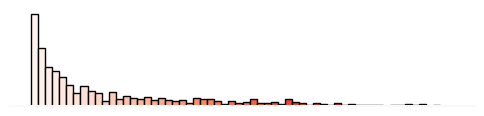

In [22]:
import os
import sys
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd  # optional; not required below
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm

# ====================== Stats helpers ======================

def _safe_stats(series: pd.Series) -> dict:
    """Return n, mean, and stderr for a numeric series."""
    s = pd.to_numeric(series, errors="coerce").dropna()
    n = int(s.shape[0])
    if n == 0:
        return {"n": 0, "mean": np.nan, "stderr": np.nan}
    if n >= 2:
        std = float(s.std(ddof=1))
        stderr = std / math.sqrt(n)
    else:
        std = 0.0
        stderr = float("nan")
    return {"n": n, "mean": float(s.mean()), "stderr": float(stderr)}

def _write_summary_csv(summary_df: pd.DataFrame, output_path: str) -> str:
    """Write the summary table next to the figure if output_path is provided."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    os.makedirs(out_dir, exist_ok=True)
    base = os.path.splitext(os.path.basename(output_path))[0]
    csv_path = os.path.join(out_dir, f"{base}__summary_stats.csv")
    summary_df.to_csv(csv_path, index=False)
    return csv_path

def _hist_path_from(output_path: str) -> str:
    """Build a sibling histogram path from the map output path."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    base = os.path.splitext(os.path.basename(output_path))[0]
    return os.path.join(out_dir, f"{base}__hist.pdf")

# ====================== Breaks engine ======================

def _nice_number(x: float, round_: bool = True) -> float:
    """
    Return a 'nice' number approximately equal to x.
    R-like pretty helper: 1, 2, or 5 times a power of 10.
    """
    if x <= 0 or not np.isfinite(x):
        return 0.0
    expv = math.floor(math.log10(x))
    f = x / 10**expv  # [1, 10)
    if round_:
        if   f < 1.5: nf = 1
        elif f < 3:   nf = 2
        elif f < 7:   nf = 5
        else:         nf = 10
    else:
        if   f <= 1:  nf = 1
        elif f <= 2:  nf = 2
        elif f <= 5:  nf = 5
        else:         nf = 10
    return nf * 10**expv

def pretty_breaks(data_min: float, data_max: float, n_classes: int) -> np.ndarray:
    """Compute 'pretty' equal-interval breaks with rounded tick marks."""
    if not np.isfinite(data_min) or not np.isfinite(data_max):
        raise ValueError("Non-finite data range for pretty breaks.")
    if data_min == data_max:
        delta = abs(data_min) if data_min != 0 else 1.0
        data_min -= 0.5 * delta
        data_max += 0.5 * delta
    raw_step = (data_max - data_min) / max(1, n_classes)
    step = _nice_number(raw_step, round_=True)
    lo = math.floor(data_min / step) * step
    hi = math.ceil(data_max / step) * step
    k = int(round((hi - lo) / step))
    bounds = lo + step * np.arange(k + 1)
    if len(bounds) < n_classes + 1:
        bounds = np.append(bounds, bounds[-1] + step)
    elif len(bounds) > n_classes + 1:
        keep_idx = np.linspace(0, len(bounds) - 1, num=n_classes + 1, dtype=int)
        bounds = bounds[keep_idx]
    return bounds.astype(float)

def quantile_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    qs = np.linspace(0.0, 1.0, n_classes + 1)
    return np.quantile(values, qs)

def equal_breaks(dmin: float, dmax: float, n_classes: int) -> np.ndarray:
    return np.linspace(dmin, dmax, n_classes + 1)

def jenks_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    """
    Fisher–Jenks optimal breaks (O(n*k) DP). No external deps.
    Returns sorted bounds length n_classes+1 (min..max).
    """
    x = np.sort(values[np.isfinite(values)])
    n = x.size
    k = max(1, n_classes)
    if n == 0:
        raise ValueError("No finite values for Jenks.")
    if k >= n:
        return np.unique(np.concatenate(([x[0]], x))).astype(float)

    # cumulative sums for fast variance
    csum = np.zeros(n + 1); csum2 = np.zeros(n + 1)
    csum[1:] = np.cumsum(x); csum2[1:] = np.cumsum(x * x)

    def range_var(i: int, j: int) -> float:
        m = j - i + 1
        s = csum[j + 1] - csum[i]
        s2 = csum2[j + 1] - csum2[i]
        mean = s / m
        return s2 - m * mean * mean

    mat = np.full((k + 1, n), np.inf); idx = np.full((k + 1, n), -1, dtype=int)
    for i in range(n):
        mat[1, i] = range_var(0, i); idx[1, i] = 0

    for kk in range(2, k + 1):
        for i in range(kk - 1, n):
            best = np.inf; best_j = -1
            for j in range(kk - 2, i):
                v = mat[kk - 1, j] + range_var(j + 1, i)
                if v < best:
                    best = v; best_j = j
            mat[kk, i] = best; idx[kk, i] = best_j

    breaks_idx, kk, last = [n - 1], k, n - 1
    while kk > 1:
        j = idx[kk, last]
        breaks_idx.append(j); last = j; kk -= 1
    breaks_idx.append(-1); breaks_idx = sorted(breaks_idx)

    bounds = [x[0]]
    for a, b in zip(breaks_idx[:-1], breaks_idx[1:]):
        bounds.append(x[b + 1])
    bounds[-1] = x[-1]
    return np.array(bounds, dtype=float)

def compute_bounds(values: np.ndarray,
                   n_classes: int = 8,
                   method: str = "quantile",
                   robust_clip: bool = True,
                   low_pct: float = 2.0,
                   high_pct: float = 98.0) -> np.ndarray:
    """Compute class bounds for a 1-D numeric array."""
    v = values[np.isfinite(values)]
    if v.size == 0:
        raise ValueError("No finite values to compute bounds.")

    if robust_clip:
        lo = np.percentile(v, low_pct)
        hi = np.percentile(v, high_pct)
        v = v[(v >= lo) & (v <= hi)]
        if v.size == 0:
            raise ValueError("All values removed by robust clipping.")

    dmin, dmax = float(v.min()), float(v.max())
    if dmin == dmax:
        eps = 1e-6 * (abs(dmin) + 1.0)
        dmin -= eps; dmax += eps

    method = method.lower()
    if   method == "quantile": bounds = quantile_breaks(v, n_classes)
    elif method == "equal":    bounds = equal_breaks(dmin, dmax, n_classes)
    elif method == "pretty":   bounds = pretty_breaks(dmin, dmax, n_classes)
    elif method == "jenks":
        try:                   bounds = jenks_breaks(v, n_classes)
        except Exception:      bounds = quantile_breaks(v, n_classes)
    else:
        raise ValueError(f"Unknown break method: {method}")

    bounds = np.array(bounds, dtype=float)
    bounds[0]  = min(bounds[0], dmin)
    bounds[-1] = max(bounds[-1], dmax)
    bounds = np.unique(np.round(bounds, 10))
    if bounds.size < 2:
        bounds = np.array([dmin, dmax], dtype=float)
    return bounds

# ====================== Minimalist histogram ======================

def create_frequency_histogram(
    data_series: pd.Series,
    lower_bound: float,
    upper_bound: float,
    num_bins: int,
    cmap,
    out_path: str
) -> None:
    """
    Minimalist frequency histogram; bars colored by the continuous colormap
    evaluated at the bin mid-point. Transparent background.
    """
    try:
        s = pd.to_numeric(data_series, errors="coerce").dropna()
        filtered = s[(s >= lower_bound) & (s <= upper_bound)]
    except Exception as e:
        print(f"Histogram input error: {e}")
        return

    if filtered.empty:
        print("No data in bounds for histogram.")
        return

    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)
    norm = plt.Normalize(vmin=lower_bound, vmax=upper_bound)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        _, bin_edges, patches = ax.hist(filtered, bins=bins, edgecolor='black')
    except Exception as e:
        print(f"Error generating histogram: {e}")
        plt.close(fig)
        return

    for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
        mid = 0.5 * (left + right)
        patch.set_facecolor(cmap(norm(mid)))

    ax.set_xticks([]); ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbf7')
    ax.spines['bottom'].set_linewidth(1.5)
    fig.patch.set_alpha(0); ax.patch.set_alpha(0)

    try:
        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram saved → {out_path}")
    except Exception as e:
        print(f"Error saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)

# ====================== Main plotting ======================

def analyze_and_plot_combined(file_path,
                              output_path,
                              n_classes: int = 8,
                              break_method: str = "quantile",
                              robust_clip: bool = True,
                              pct_low: float = 2.0,
                              pct_high: float = 98.0,
                              hist_bins: int = 60,
                              base_cmap_name: str = "YlOrBr"):
    """
    Loads data, computes urban cropland fraction, maps it with chosen breaks,
    and writes a palette-matched minimalist histogram beside the map.
    """
    # 1) Load & validate
    try:
        df = pd.read_csv(file_path)
        df = df.nlargest(1000, 'Urban_Area').copy()
        # Optional: keep if there is any cropland; avoids plotting zeros only
        df = df[df["cropland_area_urban"] >= 0].copy()
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # 2) Required columns
    required_columns = [
        "cropland_area_urban", "Urban_Area", "Buffer_area", "lat", "lon"
    ]
    for col in required_columns:
        if col not in df.columns:
            raise ValueError(f"Required column '{col}' not found in data.")
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=required_columns)

    # 3) Denominators and fractions
    df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()
    if df.empty:
        raise RuntimeError("No rows with Urban_Area > 0 AND Buffer_area > 0.")

    df["cropland_fraction_urban"] = (
        df["cropland_area_urban"] / df["Urban_Area"]
    ).clip(lower=0, upper=1)

    # 4) Compute class bounds with chosen method
    vals = df["cropland_fraction_urban"].to_numpy()
    bounds = compute_bounds(
        vals,
        n_classes=n_classes,
        method=break_method,
        robust_clip=robust_clip,
        low_pct=pct_low,
        high_pct=pct_high
    )

    # Reflect clipping on colorbar's extend
    extend = "neither"
    if robust_clip:
        vmin_raw, vmax_raw = float(np.nanmin(vals)), float(np.nanmax(vals))
        if bounds[0] > vmin_raw and bounds[-1] < vmax_raw:
            extend = "both"
        elif bounds[0] > vmin_raw:
            extend = "min"
        elif bounds[-1] < vmax_raw:
            extend = "max"

    # 5) Colormap & norm (discrete for the map; continuous for the histogram)
    n_bins = max(1, len(bounds) - 1)
    cmap_discrete = plt.get_cmap(base_cmap_name, n_bins)
    cmap_cont     = plt.get_cmap(base_cmap_name)  # smooth for histogram
    norm_seq = BoundaryNorm(boundaries=bounds, ncolors=n_bins, clip=False)

    # 6) Plot map
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5)
    ax.add_feature(cfeature.OCEAN, facecolor="lightblue", alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor="#fcfbf7")
    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    sc = ax.scatter(
        df["lon"], df["lat"],
        c=df["cropland_fraction_urban"],
        cmap=cmap_discrete, norm=norm_seq,
        s=150, edgecolors="black", linewidths=0.8,
        transform=ccrs.PlateCarree()
    )

    # 7) Colorbar
    cax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cb = plt.colorbar(sc, cax=cax, orientation="vertical", extend=extend)
    cb.set_label("Urban cropland fraction", fontsize=24, labelpad=15, weight="bold")
    cb.ax.tick_params(labelsize=20)
    cb.set_ticks(bounds)
    cb.set_ticklabels([f"{b:.3f}" for b in bounds])

    # 8) Summary CSV (optional)
    summary = {"metric": ["cropland_fraction_urban"], **_safe_stats(df["cropland_fraction_urban"])}
    summary_df = pd.DataFrame([summary])
    csv_out = _write_summary_csv(summary_df, output_path)

    # 9) Save map
    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)
    if output_path:
        os.makedirs(os.path.dirname(output_path), exist_ok=True)
        try:
            plt.savefig(output_path, dpi=400, bbox_inches="tight", format='pdf', transparent=True)
            print(f"\nMap saved to: {output_path}")
            if csv_out:
                print(f"Summary stats saved to: {csv_out}")
        except Exception as e:
            print(f"Error saving map: {e}")
    plt.show()

    # 10) Histogram using the SAME bounds (consistency with the map)
    hist_out = _hist_path_from(output_path)
    if hist_out:
        create_frequency_histogram(
            data_series=df["cropland_fraction_urban"],
            lower_bound=bounds[0],
            upper_bound=bounds[-1],
            num_bins=hist_bins,
            cmap=cmap_cont,
            out_path=hist_out
        )

# ====================== CLI ======================

if __name__ == "__main__":
    FILE_PATH = "/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv"
    OUTPUT_DIR = "/content/"
    OUTPUT_FILE = os.path.join(OUTPUT_DIR, "EDFig4B.pdf")

    # User-tunable parameters
    N_CLASSES    = 8
    BREAK_METHOD = "quantile"  # 'quantile' | 'equal' | 'pretty' | 'jenks'
    ROBUST_CLIP  = True        # clip to percentiles before computing breaks
    PCT_LOW      = 2.0
    PCT_HIGH     = 98.0
    HIST_BINS    = 60
    BASE_CMAP    = "Reds"    # good visual semantics for cropland; try 'YlGn' if you prefer

    try:
        analyze_and_plot_combined(
            file_path=FILE_PATH,
            output_path=OUTPUT_FILE,
            n_classes=N_CLASSES,
            break_method=BREAK_METHOD,
            robust_clip=ROBUST_CLIP,
            pct_low=PCT_LOW,
            pct_high=PCT_HIGH,
            hist_bins=HIST_BINS,
            base_cmap_name=BASE_CMAP
        )
    except (FileNotFoundError, ValueError, RuntimeError) as e:
        print(f"An error occurred: {e}", file=sys.stderr)
        sys.exit(1)


/tmp/ipython-input-1782543936.py:263: DtypeWarning: Columns (57,59,60,62,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)



Map saved to: /content/SDF1B.pdf
Summary stats saved to: /content/SDF1B__summary_stats.csv


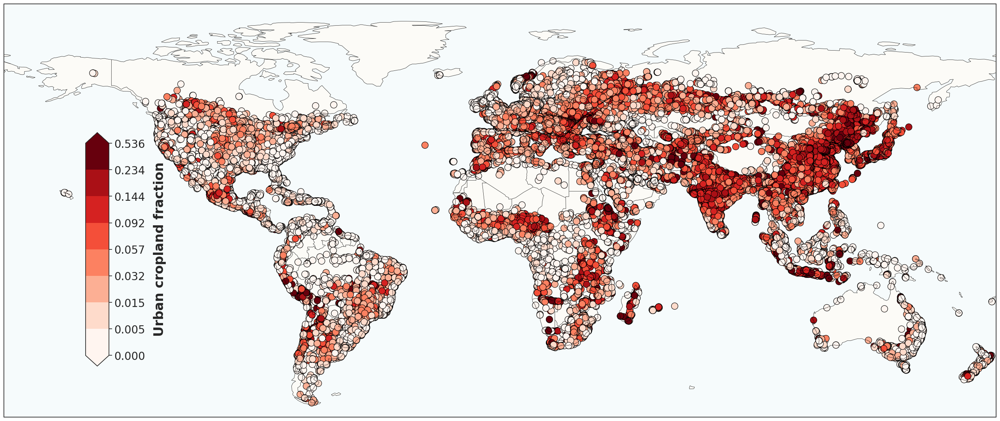

Histogram saved → /content/SDF1B__hist.pdf


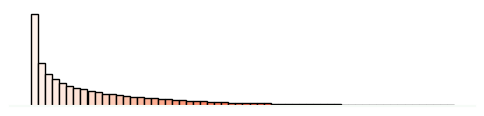

In [23]:
import os
import sys
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd  # optional; not required below
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm

# ====================== Stats helpers ======================

def _safe_stats(series: pd.Series) -> dict:
    """Return n, mean, and stderr for a numeric series."""
    s = pd.to_numeric(series, errors="coerce").dropna()
    n = int(s.shape[0])
    if n == 0:
        return {"n": 0, "mean": np.nan, "stderr": np.nan}
    if n >= 2:
        std = float(s.std(ddof=1))
        stderr = std / math.sqrt(n)
    else:
        std = 0.0
        stderr = float("nan")
    return {"n": n, "mean": float(s.mean()), "stderr": float(stderr)}

def _write_summary_csv(summary_df: pd.DataFrame, output_path: str) -> str:
    """Write the summary table next to the figure if output_path is provided."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    os.makedirs(out_dir, exist_ok=True)
    base = os.path.splitext(os.path.basename(output_path))[0]
    csv_path = os.path.join(out_dir, f"{base}__summary_stats.csv")
    summary_df.to_csv(csv_path, index=False)
    return csv_path

def _hist_path_from(output_path: str) -> str:
    """Build a sibling histogram path from the map output path."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    base = os.path.splitext(os.path.basename(output_path))[0]
    return os.path.join(out_dir, f"{base}__hist.pdf")

# ====================== Breaks engine ======================

def _nice_number(x: float, round_: bool = True) -> float:
    """
    Return a 'nice' number approximately equal to x.
    R-like pretty helper: 1, 2, or 5 times a power of 10.
    """
    if x <= 0 or not np.isfinite(x):
        return 0.0
    expv = math.floor(math.log10(x))
    f = x / 10**expv  # [1, 10)
    if round_:
        if   f < 1.5: nf = 1
        elif f < 3:   nf = 2
        elif f < 7:   nf = 5
        else:         nf = 10
    else:
        if   f <= 1:  nf = 1
        elif f <= 2:  nf = 2
        elif f <= 5:  nf = 5
        else:         nf = 10
    return nf * 10**expv

def pretty_breaks(data_min: float, data_max: float, n_classes: int) -> np.ndarray:
    """Compute 'pretty' equal-interval breaks with rounded tick marks."""
    if not np.isfinite(data_min) or not np.isfinite(data_max):
        raise ValueError("Non-finite data range for pretty breaks.")
    if data_min == data_max:
        delta = abs(data_min) if data_min != 0 else 1.0
        data_min -= 0.5 * delta
        data_max += 0.5 * delta
    raw_step = (data_max - data_min) / max(1, n_classes)
    step = _nice_number(raw_step, round_=True)
    lo = math.floor(data_min / step) * step
    hi = math.ceil(data_max / step) * step
    k = int(round((hi - lo) / step))
    bounds = lo + step * np.arange(k + 1)
    if len(bounds) < n_classes + 1:
        bounds = np.append(bounds, bounds[-1] + step)
    elif len(bounds) > n_classes + 1:
        keep_idx = np.linspace(0, len(bounds) - 1, num=n_classes + 1, dtype=int)
        bounds = bounds[keep_idx]
    return bounds.astype(float)

def quantile_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    qs = np.linspace(0.0, 1.0, n_classes + 1)
    return np.quantile(values, qs)

def equal_breaks(dmin: float, dmax: float, n_classes: int) -> np.ndarray:
    return np.linspace(dmin, dmax, n_classes + 1)

def jenks_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    """
    Fisher–Jenks optimal breaks (O(n*k) DP). No external deps.
    Returns sorted bounds length n_classes+1 (min..max).
    """
    x = np.sort(values[np.isfinite(values)])
    n = x.size
    k = max(1, n_classes)
    if n == 0:
        raise ValueError("No finite values for Jenks.")
    if k >= n:
        return np.unique(np.concatenate(([x[0]], x))).astype(float)

    # cumulative sums for fast variance
    csum = np.zeros(n + 1); csum2 = np.zeros(n + 1)
    csum[1:] = np.cumsum(x); csum2[1:] = np.cumsum(x * x)

    def range_var(i: int, j: int) -> float:
        m = j - i + 1
        s = csum[j + 1] - csum[i]
        s2 = csum2[j + 1] - csum2[i]
        mean = s / m
        return s2 - m * mean * mean

    mat = np.full((k + 1, n), np.inf); idx = np.full((k + 1, n), -1, dtype=int)
    for i in range(n):
        mat[1, i] = range_var(0, i); idx[1, i] = 0

    for kk in range(2, k + 1):
        for i in range(kk - 1, n):
            best = np.inf; best_j = -1
            for j in range(kk - 2, i):
                v = mat[kk - 1, j] + range_var(j + 1, i)
                if v < best:
                    best = v; best_j = j
            mat[kk, i] = best; idx[kk, i] = best_j

    breaks_idx, kk, last = [n - 1], k, n - 1
    while kk > 1:
        j = idx[kk, last]
        breaks_idx.append(j); last = j; kk -= 1
    breaks_idx.append(-1); breaks_idx = sorted(breaks_idx)

    bounds = [x[0]]
    for a, b in zip(breaks_idx[:-1], breaks_idx[1:]):
        bounds.append(x[b + 1])
    bounds[-1] = x[-1]
    return np.array(bounds, dtype=float)

def compute_bounds(values: np.ndarray,
                   n_classes: int = 8,
                   method: str = "quantile",
                   robust_clip: bool = True,
                   low_pct: float = 2.0,
                   high_pct: float = 98.0) -> np.ndarray:
    """Compute class bounds for a 1-D numeric array."""
    v = values[np.isfinite(values)]
    if v.size == 0:
        raise ValueError("No finite values to compute bounds.")

    if robust_clip:
        lo = np.percentile(v, low_pct)
        hi = np.percentile(v, high_pct)
        v = v[(v >= lo) & (v <= hi)]
        if v.size == 0:
            raise ValueError("All values removed by robust clipping.")

    dmin, dmax = float(v.min()), float(v.max())
    if dmin == dmax:
        eps = 1e-6 * (abs(dmin) + 1.0)
        dmin -= eps; dmax += eps

    method = method.lower()
    if   method == "quantile": bounds = quantile_breaks(v, n_classes)
    elif method == "equal":    bounds = equal_breaks(dmin, dmax, n_classes)
    elif method == "pretty":   bounds = pretty_breaks(dmin, dmax, n_classes)
    elif method == "jenks":
        try:                   bounds = jenks_breaks(v, n_classes)
        except Exception:      bounds = quantile_breaks(v, n_classes)
    else:
        raise ValueError(f"Unknown break method: {method}")

    bounds = np.array(bounds, dtype=float)
    bounds[0]  = min(bounds[0], dmin)
    bounds[-1] = max(bounds[-1], dmax)
    bounds = np.unique(np.round(bounds, 10))
    if bounds.size < 2:
        bounds = np.array([dmin, dmax], dtype=float)
    return bounds

# ====================== Minimalist histogram ======================

def create_frequency_histogram(
    data_series: pd.Series,
    lower_bound: float,
    upper_bound: float,
    num_bins: int,
    cmap,
    out_path: str
) -> None:
    """
    Minimalist frequency histogram; bars colored by the continuous colormap
    evaluated at the bin mid-point. Transparent background.
    """
    try:
        s = pd.to_numeric(data_series, errors="coerce").dropna()
        filtered = s[(s >= lower_bound) & (s <= upper_bound)]
    except Exception as e:
        print(f"Histogram input error: {e}")
        return

    if filtered.empty:
        print("No data in bounds for histogram.")
        return

    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)
    norm = plt.Normalize(vmin=lower_bound, vmax=upper_bound)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        _, bin_edges, patches = ax.hist(filtered, bins=bins, edgecolor='black')
    except Exception as e:
        print(f"Error generating histogram: {e}")
        plt.close(fig)
        return

    for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
        mid = 0.5 * (left + right)
        patch.set_facecolor(cmap(norm(mid)))

    ax.set_xticks([]); ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbf7')
    ax.spines['bottom'].set_linewidth(1.5)
    fig.patch.set_alpha(0); ax.patch.set_alpha(0)

    try:
        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram saved → {out_path}")
    except Exception as e:
        print(f"Error saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)

# ====================== Main plotting ======================

def analyze_and_plot_combined(file_path,
                              output_path,
                              n_classes: int = 8,
                              break_method: str = "quantile",
                              robust_clip: bool = True,
                              pct_low: float = 2.0,
                              pct_high: float = 98.0,
                              hist_bins: int = 60,
                              base_cmap_name: str = "YlOrBr"):
    """
    Loads data, computes urban cropland fraction, maps it with chosen breaks,
    and writes a palette-matched minimalist histogram beside the map.
    """
    # 1) Load & validate
    try:
        df = pd.read_csv(file_path)
        # df = df.nlargest(1000, 'Urban_Area').copy()
        # Optional: keep if there is any cropland; avoids plotting zeros only
        df = df[df["cropland_area_urban"] >= 0].copy()
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # 2) Required columns
    required_columns = [
        "cropland_area_urban", "Urban_Area", "Buffer_area", "lat", "lon"
    ]
    for col in required_columns:
        if col not in df.columns:
            raise ValueError(f"Required column '{col}' not found in data.")
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=required_columns)

    # 3) Denominators and fractions
    df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()
    if df.empty:
        raise RuntimeError("No rows with Urban_Area > 0 AND Buffer_area > 0.")

    df["cropland_fraction_urban"] = (
        df["cropland_area_urban"] / df["Urban_Area"]
    ).clip(lower=0, upper=1)

    df = df[df["cropland_fraction_urban"] >= 0.0001].copy()

    # 4) Compute class bounds with chosen method
    vals = df["cropland_fraction_urban"].to_numpy()
    bounds = compute_bounds(
        vals,
        n_classes=n_classes,
        method=break_method,
        robust_clip=robust_clip,
        low_pct=pct_low,
        high_pct=pct_high
    )

    # Reflect clipping on colorbar's extend
    extend = "neither"
    if robust_clip:
        vmin_raw, vmax_raw = float(np.nanmin(vals)), float(np.nanmax(vals))
        if bounds[0] > vmin_raw and bounds[-1] < vmax_raw:
            extend = "both"
        elif bounds[0] > vmin_raw:
            extend = "min"
        elif bounds[-1] < vmax_raw:
            extend = "max"

    # 5) Colormap & norm (discrete for the map; continuous for the histogram)
    n_bins = max(1, len(bounds) - 1)
    cmap_discrete = plt.get_cmap(base_cmap_name, n_bins)
    cmap_cont     = plt.get_cmap(base_cmap_name)  # smooth for histogram
    norm_seq = BoundaryNorm(boundaries=bounds, ncolors=n_bins, clip=False)

    # 6) Plot map
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5)
    ax.add_feature(cfeature.OCEAN, facecolor="lightblue", alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor="#fcfbf7")
    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    sc = ax.scatter(
        df["lon"], df["lat"],
        c=df["cropland_fraction_urban"],
        cmap=cmap_discrete, norm=norm_seq,
        s=150, edgecolors="black", linewidths=0.8,
        transform=ccrs.PlateCarree()
    )

    # 7) Colorbar
    cax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cb = plt.colorbar(sc, cax=cax, orientation="vertical", extend=extend)
    cb.set_label("Urban cropland fraction", fontsize=24, labelpad=15, weight="bold")
    cb.ax.tick_params(labelsize=20)
    cb.set_ticks(bounds)
    cb.set_ticklabels([f"{b:.3f}" for b in bounds])

    # 8) Summary CSV (optional)
    summary = {"metric": ["cropland_fraction_urban"], **_safe_stats(df["cropland_fraction_urban"])}
    summary_df = pd.DataFrame([summary])
    csv_out = _write_summary_csv(summary_df, output_path)

    # 9) Save map
    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)
    if output_path:
        os.makedirs(os.path.dirname(output_path), exist_ok=True)
        try:
            plt.savefig(output_path, dpi=400, bbox_inches="tight", format='pdf', transparent=True)
            print(f"\nMap saved to: {output_path}")
            if csv_out:
                print(f"Summary stats saved to: {csv_out}")
        except Exception as e:
            print(f"Error saving map: {e}")
    plt.show()

    # 10) Histogram using the SAME bounds (consistency with the map)
    hist_out = _hist_path_from(output_path)
    if hist_out:
        create_frequency_histogram(
            data_series=df["cropland_fraction_urban"],
            lower_bound=bounds[0],
            upper_bound=bounds[-1],
            num_bins=hist_bins,
            cmap=cmap_cont,
            out_path=hist_out
        )

# ====================== CLI ======================

if __name__ == "__main__":
    FILE_PATH = "/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv"
    OUTPUT_DIR = "/content/"
    OUTPUT_FILE = os.path.join(OUTPUT_DIR, "SDF1B.pdf")

    # User-tunable parameters
    N_CLASSES    = 8
    BREAK_METHOD = "quantile"  # 'quantile' | 'equal' | 'pretty' | 'jenks'
    ROBUST_CLIP  = True        # clip to percentiles before computing breaks
    PCT_LOW      = 2.0
    PCT_HIGH     = 98.0
    HIST_BINS    = 60
    BASE_CMAP    = "Reds"    # good visual semantics for cropland; try 'YlGn' if you prefer

    try:
        analyze_and_plot_combined(
            file_path=FILE_PATH,
            output_path=OUTPUT_FILE,
            n_classes=N_CLASSES,
            break_method=BREAK_METHOD,
            robust_clip=ROBUST_CLIP,
            pct_low=PCT_LOW,
            pct_high=PCT_HIGH,
            hist_bins=HIST_BINS,
            base_cmap_name=BASE_CMAP
        )
    except (FileNotFoundError, ValueError, RuntimeError) as e:
        print(f"An error occurred: {e}", file=sys.stderr)
        sys.exit(1)


Map successfully saved to /content/EDFig5B_map.pdf


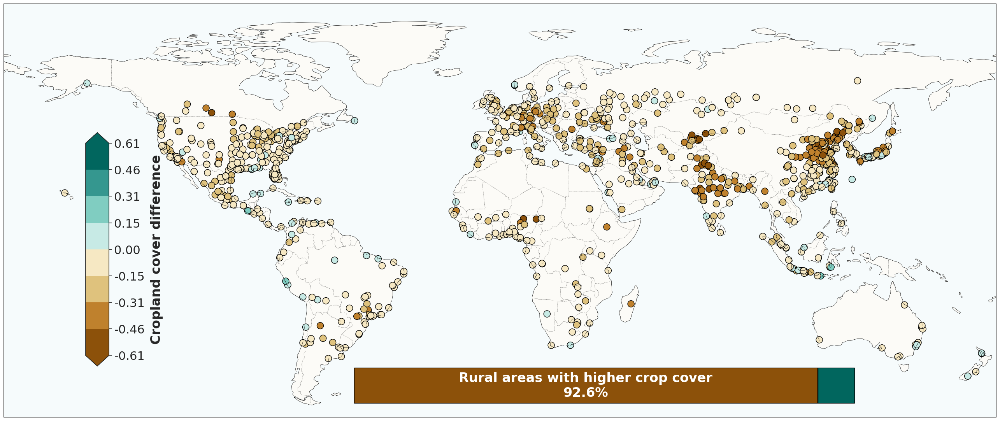

Histogram successfully saved to /content/EDFig5B_hist.pdf


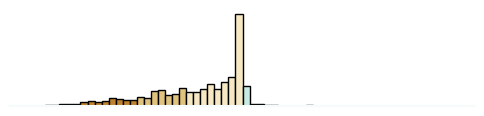

In [24]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import ListedColormap, BoundaryNorm, LinearSegmentedColormap
import geopandas as gpd

# -------------------------
# CONFIG
# -------------------------
INPUT_PATH  = '/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv'
OUT_DIR     = '/content/'
MAP_PDF     = os.path.join(OUT_DIR, 'EDFig5B_map.pdf')
HIST_PDF    = os.path.join(OUT_DIR, 'EDFig5B_hist.pdf')

TOP_N_BY_URBAN = 1000
CLIP_TO_UNIT   = True
NBINS_HIST     = 60

# === Diverging palette from your example (even length, no white center) ===
# Negative side (rural>urban) = brown-ish; Positive side (urban>rural) = teal/green
DIVERGING_COLS = [
    '#8c510a', '#bf812d', '#dfc27d', '#f6e8c3',  # negative
    '#c7eae5', '#80cdc1', '#35978f', '#01665e'   # positive
]
NEG_COLOR = '#8c510a'   # rural>urban segment (left)
POS_COLOR = '#01665e'   # urban>rural segment (right)
EQ_COLOR  = '#bdbdbd'   # equal cropland (middle)

REQUIRED_COLUMNS = [
    'cropland_area_urban', 'cropland_area_rural',
    'Urban_Area', 'Buffer_area', 'lat', 'lon'
]


def _symmetric_bounds(values: np.ndarray, n_colors: int) -> np.ndarray:
    """
    Build symmetric discrete bounds around 0 using an *even* number of colors.
    Returns len = n_colors+1 edges; 0 becomes an internal boundary.
    """
    if n_colors % 2 != 0:
        raise ValueError("DIVERGING_COLS must have an even length.")
    if values.size == 0:
        raise ValueError("No values provided for bounds.")
    vmin = float(np.nanmin(values))
    vmax = float(np.nanmax(values))
    abs_max = max(abs(vmin), abs(vmax), 1e-12)  # guard if all zeros
    return np.linspace(-abs_max, abs_max, n_colors + 1)


def create_frequency_histogram_discrete(
    data_series: pd.Series,
    bounds: np.ndarray,
    cmap_discrete: ListedColormap,
    norm_discrete: BoundaryNorm,
    num_bins: int,
    out_path: str,
) -> None:
    """
    Minimalist frequency histogram of the urban–rural cover differences.

    Colors:
      - Uses the same DISCRETE colormap and BoundaryNorm as the map/cbar.
      - Each bar is colored by the class of its bin midpoint.
    """
    lower_bound = float(bounds[0])
    upper_bound = float(bounds[-1])

    filtered = data_series[(data_series >= lower_bound) & (data_series <= upper_bound)]
    if filtered.empty:
        print("No data available within specified bounds for histogram.")
        return

    # Histogram bins: many more than the color classes, but all binned within same range
    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        counts, bin_edges, patches = ax.hist(
            filtered,
            bins=bins,
            edgecolor='black'
        )

        # Color each bin according to its midpoint, using the SAME discrete norm & cmap
        for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
            midpoint = 0.5 * (left + right)
            # BoundaryNorm returns an integer index into the colormap
            color = cmap_discrete(norm_discrete(midpoint))
            patch.set_facecolor(color)

        # Minimalist styling
        ax.set_xticks([])
        ax.set_yticks([])
        for spine in ax.spines.values():
            spine.set_visible(False)
        ax.spines['bottom'].set_visible(True)
        ax.spines['bottom'].set_color('#f6fbfc')
        ax.spines['bottom'].set_linewidth(1.5)

        fig.patch.set_alpha(0)
        ax.patch.set_alpha(0)

        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram successfully saved to {out_path}")
    except Exception as e:
        print(f"Error generating/saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)


def analyze_cropland_difference(file_path):
    """
    Loads geospatial cropland cover data, computes normalized urban–rural cropland difference,
    plots a scatter map, draws an inset stacked bar (Rural-left, Equal-middle, Urban-right),
    and saves both the map and histogram PDFs.
    """
    # ---------- Load ----------
    try:
        data = gpd.read_file(file_path)
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # ---------- Validate & cast ----------
    missing = [c for c in REQUIRED_COLUMNS if c not in data.columns]
    if missing:
        raise ValueError(f"Required column(s) missing: {missing}")

    for col in REQUIRED_COLUMNS:
        data[col] = pd.to_numeric(data[col], errors='coerce')

    # Drop NaNs and non-positive areas to avoid division-by-zero
    data = data.dropna(subset=REQUIRED_COLUMNS).copy()
    data = data[(data['Urban_Area'] > 0) & (data['Buffer_area'] > 0)].copy()
    if data.empty:
        raise ValueError("No valid rows after removing NaNs/zero areas.")

    # ---------- Normalize & difference ----------
    data['cropland_urban_normalized'] = data['cropland_area_urban'] / data['Urban_Area']
    data['cropland_rural_normalized'] = data['cropland_area_rural'] / data['Buffer_area']
    data['cropland_difference'] = (
        data['cropland_urban_normalized'] - data['cropland_rural_normalized']
    )

    # Top-N by urban area
    data = data.nlargest(TOP_N_BY_URBAN, 'Urban_Area').copy()

    # Clip to [-1, 1] (optionally)
    if CLIP_TO_UNIT:
        data = data[
            (data['cropland_difference'] >= -1) &
            (data['cropland_difference'] <= 1)
        ].copy()
    if data.empty:
        raise ValueError("No rows remain after filtering/clipping.")

    # ---------- For MAP: drop exact zeros ----------
    data_map = data[data['cropland_difference'] != 0].copy()
    if data_map.empty:
        raise ValueError("No non-zero cropland differences for map after filtering.")

    # ---------- Discrete colormap (symmetric around 0) ----------
    vals = data_map['cropland_difference'].to_numpy()
    discrete_bounds = _symmetric_bounds(vals, n_colors=len(DIVERGING_COLS))
    cmap_discrete = ListedColormap(DIVERGING_COLS)
    discrete_norm = BoundaryNorm(discrete_bounds, len(DIVERGING_COLS), clip=True)

    # ---------- Map ----------
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')

    sc = ax.scatter(
        data_map['lon'], data_map['lat'],
        c=data_map['cropland_difference'],
        cmap=cmap_discrete,
        norm=discrete_norm,
        s=150, alpha=1,
        edgecolors='black', linewidths=1,
        transform=ccrs.PlateCarree()
    )
    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    # Colorbar: ticks = bin edges for clear classing
    cbar_ax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cbar = plt.colorbar(sc, cax=cbar_ax, orientation='vertical', extend='both')
    cbar.set_label('Cropland cover difference', fontsize=24, labelpad=10, weight='bold')
    cbar.ax.tick_params(labelsize=22)
    cbar.set_ticks(discrete_bounds)
    cbar.set_ticklabels([f"{x:.2f}" for x in discrete_bounds])

    # ---------- Inset stacked bar (Rural-left, Equal-middle, Urban-right) ----------
    urban_count = int((data['cropland_difference'] > 0).sum())
    rural_count = int((data['cropland_difference'] < 0).sum())
    equal_count = int((data['cropland_difference'] == 0).sum())
    total_count = int(len(data))
    if total_count == 0:
        raise ValueError("No observations available to compute percentages.")

    rural_percent = 100.0 * rural_count / total_count
    urban_percent = 100.0 * urban_count / total_count
    equal_percent = 100.0 * equal_count / total_count

    bar_ax = fig.add_axes([0.40, 0.25, 0.45, 0.05])
    bar_ax.set_axis_off()

    # Rural segment first (LEFT, brown)
    bar_ax.barh([''], [rural_percent], color=NEG_COLOR,
                edgecolor='black', height=0.4)

    # Equal segment (MIDDLE, grey) if present
    if equal_percent > 0:
        bar_ax.barh([''], [equal_percent], color=EQ_COLOR,
                    edgecolor='black', height=0.4, left=rural_percent)
        urban_left = rural_percent + equal_percent
    else:
        urban_left = rural_percent

    # Urban segment (RIGHT, green), stacked after rural (+ equal)
    bar_ax.barh([''], [urban_percent], color=POS_COLOR,
                edgecolor='black', height=0.4, left=urban_left)

    # Labels centered on each segment (keep your existing text pattern)
    bar_ax.text(rural_percent / 2.0, 0,
                f"Rural areas with higher crop cover\n{rural_percent:.1f}%",
                ha='center', va='center', fontsize=24, color='white', weight='bold')
    bar_ax.text(urban_left + urban_percent / 2.0, 0,
                f"",
                ha='center', va='center', fontsize=24, color='white', weight='bold')

    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)

    # ---------- Save map ----------
    os.makedirs(OUT_DIR, exist_ok=True)
    try:
        plt.savefig(MAP_PDF, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Map successfully saved to {MAP_PDF}")
    except Exception as e:
        print(f"Error saving map: {e}")
    finally:
        plt.show()
        plt.close(fig)

    # ---------- Histogram (now using the SAME discrete palette as the map/cbar) ----------
    create_frequency_histogram_discrete(
        data_series=data['cropland_difference'],
        bounds=discrete_bounds,
        cmap_discrete=cmap_discrete,
        norm_discrete=discrete_norm,
        num_bins=NBINS_HIST,
        out_path=HIST_PDF
    )


if __name__ == "__main__":
    try:
        analyze_cropland_difference(INPUT_PATH)
    except Exception as e:
        print(f"An error occurred during analysis: {e}")


Map successfully saved to /content/S2BFig_map.pdf


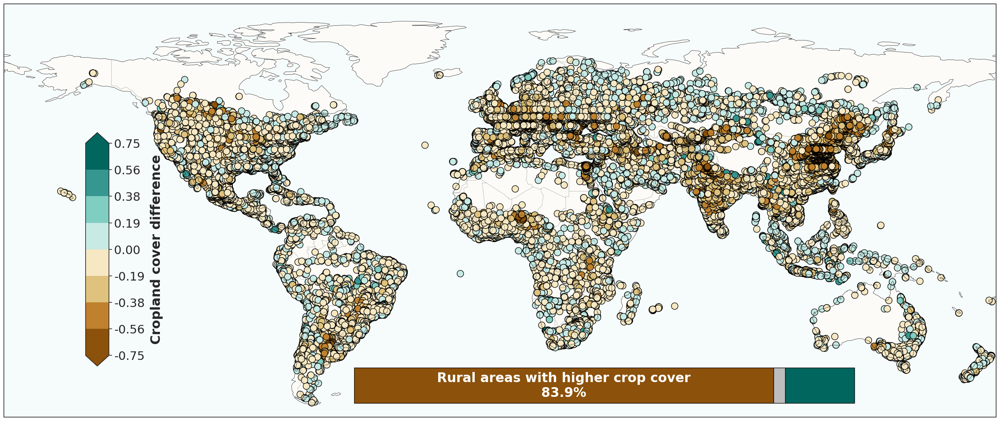

Histogram successfully saved to /content/S2BFig_hist.pdf


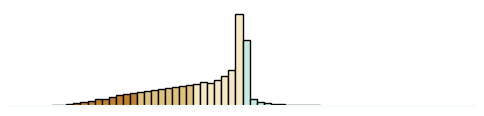

In [25]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import ListedColormap, BoundaryNorm
import geopandas as gpd

# -------------------------
# CONFIG
# -------------------------
INPUT_PATH  = '/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv'
OUT_DIR     = '/content/'
MAP_PDF     = os.path.join(OUT_DIR, 'S2BFig_map.pdf')
HIST_PDF    = os.path.join(OUT_DIR, 'S2BFig_hist.pdf')

TOP_N_BY_URBAN = 83102
CLIP_TO_UNIT   = True
NBINS_HIST     = 60

# === Diverging palette from your example (even length, no white center) ===
# Negative side (rural>urban) = brown-ish; Positive side (urban>rural) = teal/green
DIVERGING_COLS = [
    '#8c510a', '#bf812d', '#dfc27d', '#f6e8c3',  # negative
    '#c7eae5', '#80cdc1', '#35978f', '#01665e'   # positive
]
NEG_COLOR = '#8c510a'   # rural>urban segment (left)
POS_COLOR = '#01665e'   # urban>rural segment (right)
EQ_COLOR  = '#bdbdbd'   # equal cropland (middle)

REQUIRED_COLUMNS = [
    'cropland_area_urban', 'cropland_area_rural',
    'Urban_Area', 'Buffer_area', 'lat', 'lon'
]


def _symmetric_bounds(values: np.ndarray, n_colors: int) -> np.ndarray:
    """
    Build symmetric discrete bounds around 0 using an *even* number of colors.
    Returns len = n_colors+1 edges; 0 becomes an internal boundary.
    """
    if n_colors % 2 != 0:
        raise ValueError("DIVERGING_COLS must have an even length.")
    if values.size == 0:
        raise ValueError("No values provided for bounds.")
    vmin = float(np.nanmin(values))
    vmax = float(np.nanmax(values))
    abs_max = max(abs(vmin), abs(vmax), 1e-12)  # guard if all zeros
    return np.linspace(-abs_max, abs_max, n_colors + 1)


def create_frequency_histogram_discrete(
    data_series: pd.Series,
    bounds: np.ndarray,
    cmap_discrete: ListedColormap,
    norm_discrete: BoundaryNorm,
    num_bins: int,
    out_path: str,
) -> None:
    """
    Minimalist frequency histogram of the urban–rural cover differences.

    Colors:
      - Uses the same DISCRETE colormap and BoundaryNorm as the map/cbar.
      - Each bar is colored by the class of its bin midpoint.
    """
    lower_bound = float(bounds[0])
    upper_bound = float(bounds[-1])

    filtered = data_series[(data_series >= lower_bound) & (data_series <= upper_bound)]
    if filtered.empty:
        print("No data available within specified bounds for histogram.")
        return

    # Histogram bins: many more than the color classes, but all binned within same range
    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        counts, bin_edges, patches = ax.hist(
            filtered,
            bins=bins,
            edgecolor='black'
        )

        # Color each bin according to its midpoint, using the SAME discrete norm & cmap
        for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
            midpoint = 0.5 * (left + right)
            # BoundaryNorm returns an integer index into the colormap
            color = cmap_discrete(norm_discrete(midpoint))
            patch.set_facecolor(color)

        # Minimalist styling
        ax.set_xticks([])
        ax.set_yticks([])
        for spine in ax.spines.values():
            spine.set_visible(False)
        ax.spines['bottom'].set_visible(True)
        ax.spines['bottom'].set_color('#f6fbfc')
        ax.spines['bottom'].set_linewidth(1.5)

        fig.patch.set_alpha(0)
        ax.patch.set_alpha(0)

        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram successfully saved to {out_path}")
    except Exception as e:
        print(f"Error generating/saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)


def analyze_cropland_difference(file_path: str) -> None:
    """
    Loads geospatial cropland cover data, computes normalized urban–rural cropland difference,
    plots a scatter map, draws an inset stacked bar (Rural-left, Equal-middle, Urban-right),
    and saves both the map and histogram PDFs.

    Histogram is colored with the same 8 discrete classes as the map colorbar.
    """
    # ---------- Load ----------
    try:
        data = gpd.read_file(file_path)
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # ---------- Validate & cast ----------
    missing = [c for c in REQUIRED_COLUMNS if c not in data.columns]
    if missing:
        raise ValueError(f"Required column(s) missing: {missing}")

    for col in REQUIRED_COLUMNS:
        data[col] = pd.to_numeric(data[col], errors='coerce')

    # Drop NaNs and non-positive areas to avoid division-by-zero
    data = data.dropna(subset=REQUIRED_COLUMNS).copy()
    data = data[(data['Urban_Area'] > 0) & (data['Buffer_area'] > 0)].copy()
    if data.empty:
        raise ValueError("No valid rows after removing NaNs/zero areas.")

    # ---------- Normalize & difference ----------
    data['cropland_urban_normalized'] = data['cropland_area_urban'] / data['Urban_Area']
    data['cropland_rural_normalized'] = data['cropland_area_rural'] / data['Buffer_area']
    data['cropland_difference'] = (
        data['cropland_urban_normalized'] - data['cropland_rural_normalized']
    )

    # Top-N by urban area
    data = data.nlargest(TOP_N_BY_URBAN, 'Urban_Area').copy()

    # Clip to [-1, 1] (optionally)
    if CLIP_TO_UNIT:
        data = data[
            (data['cropland_difference'] >= -1) &
            (data['cropland_difference'] <= 1)
        ].copy()
    if data.empty:
        raise ValueError("No rows remain after filtering/clipping.")

    # ---------- For MAP: drop exact zeros ----------
    data_map = data[data['cropland_difference'] != 0].copy()
    if data_map.empty:
        raise ValueError("No non-zero cropland differences for map after filtering.")

    # ---------- Discrete colormap (symmetric around 0) ----------
    vals = data_map['cropland_difference'].to_numpy()
    discrete_bounds = _symmetric_bounds(vals, n_colors=len(DIVERGING_COLS))
    cmap_discrete = ListedColormap(DIVERGING_COLS)
    discrete_norm = BoundaryNorm(discrete_bounds, len(DIVERGING_COLS), clip=True)

    # ---------- Map ----------
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')

    sc = ax.scatter(
        data_map['lon'], data_map['lat'],
        c=data_map['cropland_difference'],
        cmap=cmap_discrete,
        norm=discrete_norm,
        s=150, alpha=1,
        edgecolors='black', linewidths=1,
        transform=ccrs.PlateCarree()
    )
    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    # Colorbar: ticks = bin edges for clear classing
    cbar_ax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cbar = plt.colorbar(sc, cax=cbar_ax, orientation='vertical', extend='both')
    cbar.set_label('Cropland cover difference', fontsize=24, labelpad=10, weight='bold')
    cbar.ax.tick_params(labelsize=22)
    cbar.set_ticks(discrete_bounds)
    cbar.set_ticklabels([f"{x:.2f}" for x in discrete_bounds])

    # ---------- Inset stacked bar (Rural-left, Equal-middle, Urban-right) ----------
    urban_count = int((data['cropland_difference'] > 0).sum())
    rural_count = int((data['cropland_difference'] < 0).sum())
    equal_count = int((data['cropland_difference'] == 0).sum())
    total_count = int(len(data))
    if total_count == 0:
        raise ValueError("No observations available to compute percentages.")

    rural_percent = 100.0 * rural_count / total_count
    urban_percent = 100.0 * urban_count / total_count
    equal_percent = 100.0 * equal_count / total_count

    bar_ax = fig.add_axes([0.40, 0.25, 0.45, 0.05])
    bar_ax.set_axis_off()

    # Rural segment first (LEFT, brown)
    bar_ax.barh([''], [rural_percent], color=NEG_COLOR,
                edgecolor='black', height=0.4)

    # Equal segment (MIDDLE, grey) if present
    if equal_percent > 0:
        bar_ax.barh([''], [equal_percent], color=EQ_COLOR,
                    edgecolor='black', height=0.4, left=rural_percent)
        urban_left = rural_percent + equal_percent
    else:
        urban_left = rural_percent

    # Urban segment (RIGHT, green), stacked after rural (+ equal)
    bar_ax.barh([''], [urban_percent], color=POS_COLOR,
                edgecolor='black', height=0.4, left=urban_left)

    # Labels centered on each segment (you can customize these as desired)
    bar_ax.text(rural_percent / 2.0, 0,
                f"Rural areas with higher crop cover\n{rural_percent:.1f}%",
                ha='center', va='center', fontsize=24, color='white', weight='bold')
    bar_ax.text(urban_left + urban_percent / 2.0, 0,
                f"",
                ha='center', va='center', fontsize=24, color='white', weight='bold')

    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)

    # ---------- Save map ----------
    os.makedirs(OUT_DIR, exist_ok=True)
    try:
        plt.savefig(MAP_PDF, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Map successfully saved to {MAP_PDF}")
    except Exception as e:
        print(f"Error saving map: {e}")
    finally:
        plt.show()
        plt.close(fig)

    # ---------- Histogram (now using the SAME discrete palette as the map/cbar) ----------
    create_frequency_histogram_discrete(
        data_series=data['cropland_difference'],
        bounds=discrete_bounds,
        cmap_discrete=cmap_discrete,
        norm_discrete=discrete_norm,
        num_bins=NBINS_HIST,
        out_path=HIST_PDF
    )


if __name__ == "__main__":
    try:
        analyze_cropland_difference(INPUT_PATH)
    except Exception as e:
        print(f"An error occurred during analysis: {e}")


#Shrubland

Keeping 167 countries with ≥3 cities for analysis.


/tmp/ipython-input-847653772.py:167: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .groupby('NAME_EN', as_index=False).apply(_aggregate_country))



Top 3 — weighted urban shrub fraction (μ̄_u)
   NAME_EN  n_cities  urban_frac_country
   Namibia     157.0            0.244421
  Botswana      71.0            0.230353
Somaliland      14.0            0.108355

Bottom 3 — weighted urban shrub fraction (μ̄_u)
       NAME_EN  n_cities  urban_frac_country
       Iceland       7.0        0.000000e+00
   Switzerland     301.0        1.580076e-07
Czech Republic     529.0        9.385839e-07

Top 3 — weighted rural shrub fraction (μ̄_r)
 NAME_EN  n_cities  rural_frac_country
Botswana      71.0            0.538270
 Namibia     157.0            0.433023
  Mexico    1703.0            0.207817

Bottom 3 — weighted rural shrub fraction (μ̄_r)
       NAME_EN  n_cities  rural_frac_country
    Luxembourg      24.0            0.000000
   Switzerland     301.0            0.000001
Czech Republic     529.0            0.000007

Most positive 3 — weighted (urban − rural) shrub difference (μ̄_Δ)
   NAME_EN  n_cities  mean_diff_country
Mauritania      47.0  

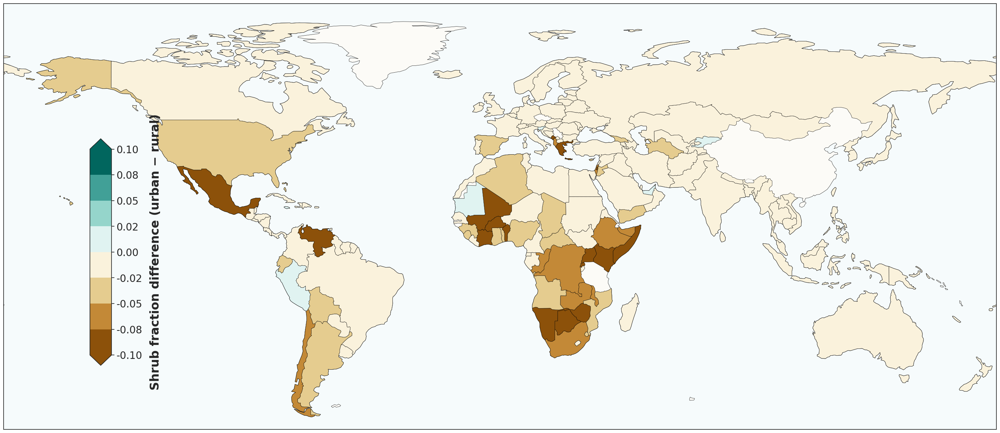

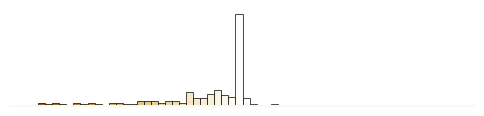

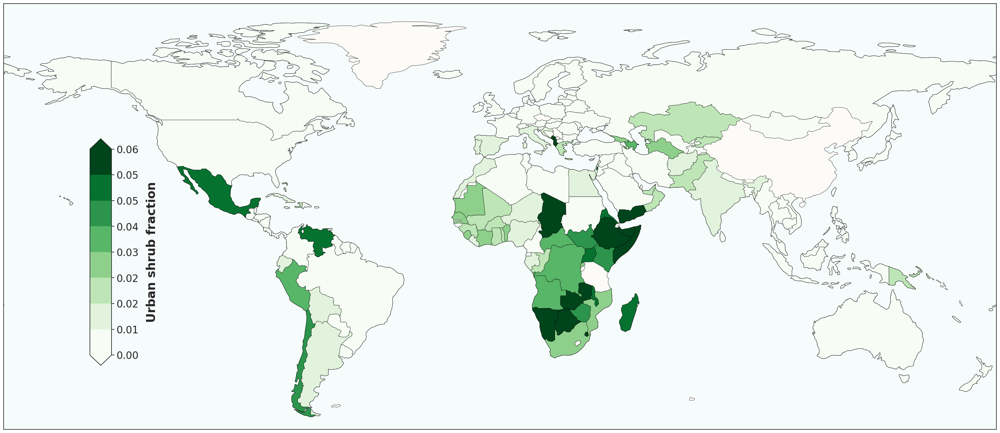

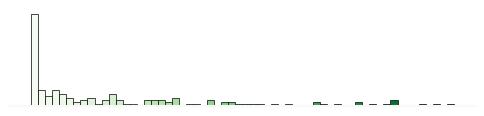

In [26]:
import sys
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import LinearSegmentedColormap, BoundaryNorm
from matplotlib.cm import ScalarMappable

# ------------------------------ CONFIG ---------------------------------------
CSV_PATH    = Path('/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv')
SHAPE_PATH  = Path('/content/ne_110m_admin_0_countries.shp')

OUT_DIR        = Path('/content/')
OUT_MAP_DIFF   = str(OUT_DIR / 'Sup_shrub_country_diff_Map.pdf')
OUT_HIST_DIFF  = str(OUT_DIR / 'Sup_shrub_country_diff_Hist.pdf')
OUT_MAP_UABS   = str(OUT_DIR / 'Sup_shrub_country_abs_Map.pdf')
OUT_HIST_UABS  = str(OUT_DIR / 'Sup_shrub_country_abs_Hist.pdf')

MIN_CITIES       = 3
NUM_COLOR_BINS   = 8
NUM_HIST_BINS    = 60

# Palettes (diverging for difference; sequential green for absolute)
DIVERGING_COLS  = ['#8c510a','#bf812d','#dfc27d','#f6e8c3','#ffffff','#c7eae5','#80cdc1','#35978f','#01665e']
SEQUENTIAL_COLS = ['#f7fcf5','#e5f5e0','#c7e9c0','#a1d99b','#74c476','#41ab5d','#238b45','#006d2c','#00441b']

# ------------------------------ HELPERS --------------------------------------
def _std_name(series: pd.Series) -> pd.Series:
    return (series.str.lower()
                 .str.replace("&","and")
                 .str.replace("-", " ")
                 .str.replace("[.,]", "", regex=True)
                 .str.strip())

def _kish_weighted_mean_se(x: np.ndarray, w: np.ndarray):
    """Return (mu_w, se_w, n_eff, n_raw, W_sum)."""
    x = np.asarray(x, float); w = np.asarray(w, float)
    m = np.isfinite(x) & np.isfinite(w) & (w > 0)
    x, w = x[m], w[m]
    n_raw = int(x.size)
    if n_raw == 0:
        return (np.nan, np.nan, 0.0, 0, 0.0)
    W = float(w.sum())
    mu_w = float((w * x).sum() / W)
    w2 = float((w * w).sum())
    n_eff = (W * W) / w2 if w2 > 0 else 0.0
    var_w = float((w * (x - mu_w) ** 2).sum() / W)
    se_w = float(np.sqrt(var_w / max(n_eff, 1.0))) if np.isfinite(var_w) else np.nan
    return (mu_w, se_w, n_eff, n_raw, W)

def _build_discrete_norm(bounds, colors):
    cmap = LinearSegmentedColormap.from_list('custom', colors, N=256)
    norm = BoundaryNorm(bounds, ncolors=256)
    return cmap, norm

def _styled_map(world_gdf, column, bounds, colors, out_path, label):
    cmap, norm = _build_discrete_norm(bounds, colors)
    fig, ax = plt.subplots(figsize=(30, 18),
                           subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')

    world_gdf.plot(column=column, cmap=cmap, norm=norm,
                   ax=ax, edgecolor='black', linewidth=0.4,
                   missing_kwds={'color':'lightgrey','label':'No data'})

    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())
    cbar_ax = fig.add_axes([0.13, 0.27, 0.02, 0.35])
    sm = ScalarMappable(norm=norm, cmap=cmap); sm._A = []
    cbar = plt.colorbar(sm, cax=cbar_ax, orientation='vertical', extend='both')
    cbar.set_label(label, fontsize=24, labelpad=15, fontweight='bold')
    cbar.set_ticks(bounds); cbar.set_ticklabels([f'{b:.2f}' for b in bounds])
    cbar.ax.tick_params(labelsize=20)

    plt.subplots_adjust(left=0.05, right=0.97, top=0.95, bottom=0.05)
    OUT_DIR.mkdir(parents=True, exist_ok=True)
    plt.savefig(out_path, dpi=400, bbox_inches='tight', format='pdf', transparent=True)
    plt.show()

def _minimalist_hist(series: pd.Series, bounds_arr, bins, colors, out_path):
    series = series[(series >= bounds_arr[0]) & (series <= bounds_arr[-1])]
    if series.empty:
        print("No data in histogram range – skipped."); return
    cmap, _ = _build_discrete_norm(bounds_arr, colors)
    norm_h = plt.Normalize(vmin=bounds_arr[0], vmax=bounds_arr[-1])
    fig, ax = plt.subplots(figsize=(6, 1.25))
    counts, edges, patches = ax.hist(series,
                                     bins=np.linspace(bounds_arr[0], bounds_arr[-1], bins + 1),
                                     edgecolor='black', linewidth=0.5)
    for p, l, r in zip(patches, edges[:-1], edges[1:]):
        p.set_facecolor(cmap(norm_h((l + r) / 2)))
    ax.set_xticks([]); ax.set_yticks([])
    for s in ax.spines.values(): s.set_visible(False)
    ax.spines['bottom'].set_visible(True); ax.spines['bottom'].set_color('#f6fbf6'); ax.spines['bottom'].set_linewidth(1.5)
    fig.patch.set_alpha(0); ax.patch.set_alpha(0)
    plt.savefig(out_path, dpi=400, bbox_inches='tight', format='pdf', transparent=True)
    plt.show()

def _resolve_shrub_columns(df: pd.DataFrame) -> tuple[str, str]:
    """
    Prefer 'shrubland_area_*' if present, otherwise fall back to 'shrub_area_*'.
    Raises with a clear message if neither pair exists.
    """
    candidates = [
        ("shrubland_area_urban", "shrubland_area_rural"),
        ("shrub_area_urban",     "shrub_area_rural"),
    ]
    for u, r in candidates:
        if u in df.columns and r in df.columns:
            return u, r
    raise KeyError("None of the expected shrub columns found: "
                   "['shrubland_area_urban','shrubland_area_rural'] or "
                   "['shrub_area_urban','shrub_area_rural'].")

# ------------------------------ LOAD & PREP ----------------------------------
if not CSV_PATH.is_file():
    sys.exit(f"ERROR: CSV not found → {CSV_PATH}")
df = pd.read_csv(CSV_PATH, low_memory=False)

# Resolve shrub columns robustly
try:
    SHRUB_UCOL, SHRUB_RCOL = _resolve_shrub_columns(df)
except KeyError as e:
    sys.exit(f"ERROR: {e}")

REQ = [SHRUB_UCOL, SHRUB_RCOL, "Urban_Area", "Buffer_area", "NAME_EN"]
missing = [c for c in REQ if c not in df.columns]
if missing:
    sys.exit(f"ERROR: missing column(s) {missing!r} in CSV")

for col in [SHRUB_UCOL, SHRUB_RCOL, "Urban_Area", "Buffer_area"]:
    df[col] = pd.to_numeric(df[col], errors='coerce')

df.dropna(subset=REQ, inplace=True)
df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()

df['urban_frac'] = df[SHRUB_UCOL] / df['Urban_Area']
df['rural_frac'] = df[SHRUB_RCOL] / df['Buffer_area']
df['diff']       = df['urban_frac'] - df['rural_frac']
df['w_diff']     = df['Urban_Area'] + df['Buffer_area']  # for diff weighting

# ------------------------- COUNTRY AGGREGATION (WEIGHTED) ---------------------
counts = df['NAME_EN'].value_counts()
countries_ok = counts[counts >= MIN_CITIES].index
print(f"Keeping {len(countries_ok)} countries with ≥{MIN_CITIES} cities for analysis.")

def _aggregate_country(g: pd.DataFrame) -> pd.Series:
    mu_u, se_u, n_eff_u, _, W_u = _kish_weighted_mean_se(g['urban_frac'].to_numpy(),
                                                         g['Urban_Area'].to_numpy())
    mu_r, se_r, n_eff_r, _, W_r = _kish_weighted_mean_se(g['rural_frac'].to_numpy(),
                                                         g['Buffer_area'].to_numpy())
    mu_d, se_d, n_eff_d, n_raw, W_d = _kish_weighted_mean_se(g['diff'].to_numpy(),
                                                             g['w_diff'].to_numpy())
    return pd.Series({
        'urban_frac_country' : mu_u,   'urban_se_country' : se_u, 'urban_neff_country' : n_eff_u, 'urban_W' : W_u,
        'rural_frac_country' : mu_r,   'rural_se_country' : se_r, 'rural_neff_country' : n_eff_r, 'rural_W' : W_r,
        'mean_diff_country'  : mu_d,   'diff_se_country'  : se_d, 'diff_neff_country'  : n_eff_d, 'diff_W'  : W_d,
        'n_cities'           : int(n_raw)
    })

country = (df[df['NAME_EN'].isin(countries_ok)]
           .groupby('NAME_EN', as_index=False).apply(_aggregate_country))

if country.empty:
    sys.exit("ERROR: No countries after weighted aggregation.")

# ------------------ PRINT REQUESTED TOP/BOTTOM SUMMARIES ----------------------
def _print_table(title: str, subdf: pd.DataFrame, cols: list[str]):
    print(f"\n{title}")
    print(subdf[cols].to_string(index=False))

# Top/Bottom by weighted urban shrub fraction
urban_cols = ['NAME_EN','n_cities','urban_frac_country']
top3_urban = country.nlargest(3, 'urban_frac_country')[urban_cols]
bot3_urban = country.nsmallest(3, 'urban_frac_country')[urban_cols]
_print_table("Top 3 — weighted urban shrub fraction (μ̄_u)", top3_urban, urban_cols)
_print_table("Bottom 3 — weighted urban shrub fraction (μ̄_u)", bot3_urban, urban_cols)

# Top/Bottom by weighted rural shrub fraction
rural_cols = ['NAME_EN','n_cities','rural_frac_country']
top3_rural = country.nlargest(3, 'rural_frac_country')[rural_cols]
bot3_rural = country.nsmallest(3, 'rural_frac_country')[rural_cols]
_print_table("Top 3 — weighted rural shrub fraction (μ̄_r)", top3_rural, rural_cols)
_print_table("Bottom 3 — weighted rural shrub fraction (μ̄_r)", bot3_rural, rural_cols)

# Most positive / most negative by weighted difference
diff_cols = ['NAME_EN','n_cities','mean_diff_country']
pos3_diff = country.nlargest(3, 'mean_diff_country')[diff_cols]
neg3_diff = country.nsmallest(3, 'mean_diff_country')[diff_cols]
_print_table("Most positive 3 — weighted (urban − rural) shrub difference (μ̄_Δ)", pos3_diff, diff_cols)
_print_table("Most negative 3 — weighted (urban − rural) shrub difference (μ̄_Δ)", neg3_diff, diff_cols)

# ------------------ ACROSS-COUNTRY SUMMARY (optional console) ----------------
u_series, u_wts = country['urban_frac_country'].astype(float), country['urban_W'].astype(float)
r_series, r_wts = country['rural_frac_country'].astype(float), country['rural_W'].astype(float)
d_series, d_wts = country['mean_diff_country'].astype(float), country['diff_W'].astype(float)

mu_u_w, se_u_w, n_eff_u_all, _, _ = _kish_weighted_mean_se(u_series.to_numpy(), u_wts.to_numpy())
mu_r_w, se_r_w, n_eff_r_all, _, _ = _kish_weighted_mean_se(r_series.to_numpy(), r_wts.to_numpy())
mu_d_w, se_d_w, n_eff_d_all, _, _ = _kish_weighted_mean_se(d_series.to_numpy(), d_wts.to_numpy())

print("\nAcross-country weighted means (console):")
print(f"  Urban μ̄_u={mu_u_w:.4f} (SE={se_u_w:.4f}, n_eff={n_eff_u_all:.1f})")
print(f"  Rural μ̄_r={mu_r_w:.4f} (SE={se_r_w:.4f}, n_eff={n_eff_r_all:.1f})")
print(f"  Diff  μ̄_Δ={mu_d_w:.4f} (SE={se_d_w:.4f}, n_eff={n_eff_d_all:.1f})")

# ------------------------------ MAPS (optional) ------------------------------
if SHAPE_PATH.is_file():
    world = gpd.read_file(SHAPE_PATH)
    world = world[world.get('ADMIN', '') != 'Antarctica']
    country['std_name'] = _std_name(country['NAME_EN'])
    world['std_name']   = _std_name(world.get('ADMIN', world.get('NAME_EN')))

    # Difference map
    merged_diff = world.merge(country[['std_name','mean_diff_country']], how='left', on='std_name').dropna(subset=['mean_diff_country'])
    if not merged_diff.empty:
        vals_d = merged_diff['mean_diff_country'].to_numpy()
        abs_lim_d = max(np.percentile(np.abs(vals_d), 95), 0.1)
        bounds_d = np.linspace(-abs_lim_d, abs_lim_d, NUM_COLOR_BINS + 1)
        _styled_map(merged_diff, 'mean_diff_country', bounds_d, DIVERGING_COLS,
                    out_path=OUT_MAP_DIFF, label='Shrub fraction difference (urban − rural)')
        _minimalist_hist(merged_diff['mean_diff_country'], bounds_d, NUM_HIST_BINS, DIVERGING_COLS, OUT_HIST_DIFF)
    else:
        print("[WARN] No countries matched the shapefile for difference map.")

    # Urban absolute map
    merged_uabs = world.merge(country[['std_name','urban_frac_country']], how='left', on='std_name').dropna(subset=['urban_frac_country'])
    if not merged_uabs.empty:
        vals_u = merged_uabs['urban_frac_country'].to_numpy()
        low_u, high_u = max(0.0, np.percentile(vals_u, 5)), min(1.0, np.percentile(vals_u, 95))
        bounds_u = np.linspace(low_u, high_u, NUM_COLOR_BINS + 1)
        _styled_map(merged_uabs, 'urban_frac_country', bounds_u, SEQUENTIAL_COLS,
                    out_path=OUT_MAP_UABS, label='Urban shrub fraction')
        _minimalist_hist(merged_uabs['urban_frac_country'], bounds_u, NUM_HIST_BINS, SEQUENTIAL_COLS, OUT_HIST_UABS)
    else:
        print("[WARN] No countries matched the shapefile for urban absolute map.")
else:
    print(f"[WARN] Shapefile not found → {SHAPE_PATH}. Skipping maps; printed tables above are complete.")


Keeping 167 countries with >= 3 cities
Map saved to -> /content/Fig2_Country_Urban_shrub_Map.png


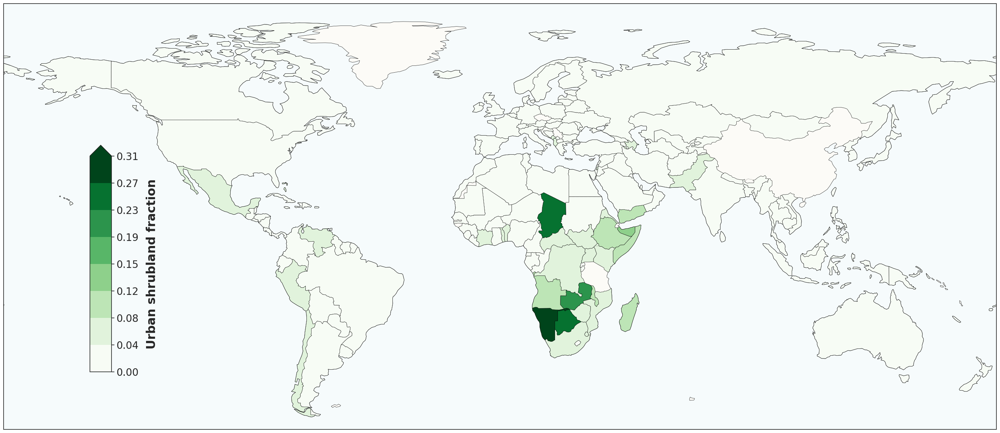

Histogram saved to -> /content/Fig2_Country_Urban_shrub_Histogram.png


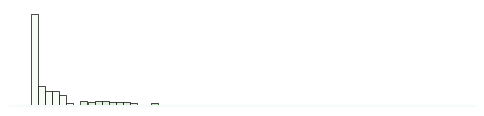

In [27]:
# ------------------------------------------------------------------
# STEP 1: IMPORTS
# ------------------------------------------------------------------
import sys
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm
from matplotlib.cm import ScalarMappable

# ------------------------------------------------------------------
# STEP 2: CONFIGURATION
# ------------------------------------------------------------------
# Paths should be adjusted to your environment (e.g., Colab, local machine).
CSV_PATH        = Path('/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv')
SHAPE_PATH      = Path('/content/ne_110m_admin_0_countries.shp')

# Outputs will be saved in the specified directory.
OUT_DIR         = Path('/content/')
OUT_MAP         = '/content/Fig2_Country_Urban_shrub_Map.png'
OUT_HIST        = '/content/Fig2_Country_Urban_shrub_Histogram.png'

# --- Parameters ---
MIN_CITIES       = 3
NUM_COLOR_BINS   = 8  # Number of distinct color classes on the map
NUM_HIST_BINS    = 60 # Number of bins for the smaller histogram

# A sequential green colormap suitable for shrub cover data.
SEQUENTIAL_CMAP = plt.cm.Greens

# ------------------------------------------------------------------
# HELPER FUNCTION
# ------------------------------------------------------------------
def _std_name(series: pd.Series) -> pd.Series:
    """Standardizes country names for robust merging."""
    return (series.str.lower()
                  .str.replace("&", "and")
                  .str.replace("-", " ")
                  .str.replace("[.,]", "", regex=True)
                  .str.strip())

# ------------------------------------------------------------------
# 1. LOAD CSV + CALCULATE URBAN shrub COVER FRACTION
# ------------------------------------------------------------------
if not CSV_PATH.is_file():
    raise FileNotFoundError(f"ERROR: CSV not found -> {CSV_PATH}")

df = pd.read_csv(CSV_PATH, low_memory=False)


# Define required columns for shrub cover analysis
REQ = ["shrubland_area_urban", "Urban_Area", "NAME_EN"]

missing = [c for c in REQ if c not in df.columns]
if missing:
    raise ValueError(f"ERROR: missing column(s) {missing!r} in CSV")

# Coerce data to numeric, turning errors into Not-a-Number (NaN)
for col in ["shrubland_area_urban", "Urban_Area"]:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Drop rows where essential data is missing
df.dropna(subset=REQ, inplace=True)

# Filter out cities with zero urban area to avoid division by zero
df = df[df["Urban_Area"] > 0].copy()

# Calculate the fraction of urban area covered by shrubs
df['shrubland_frac'] = df["shrubland_area_urban"] / df['Urban_Area']

# ------------------------------------------------------------------
# 2. REQUIRE MIN_CITIES PER COUNTRY & AGGREGATE
# ------------------------------------------------------------------
# Count the number of cities per country
city_counts = df['NAME_EN'].value_counts()

# Keep only countries with a sufficient number of cities
countries_ok = city_counts[city_counts >= MIN_CITIES].index
print(f"Keeping {len(countries_ok)} countries with >= {MIN_CITIES} cities")

# Calculate the mean urban shrub cover fraction for each qualifying country
country_urban_shrub = (df[df['NAME_EN'].isin(countries_ok)]
                      .groupby('NAME_EN', as_index=False)['shrubland_frac']
                      .mean()
                      .rename(columns={'shrubland_frac': 'mean_urban_shrub_frac'}))

# ------------------------------------------------------------------
# 3. LOAD WORLD SHAPEFILE & MERGE
# ------------------------------------------------------------------
if not SHAPE_PATH.is_file():
    raise FileNotFoundError(f"ERROR: shapefile not found -> {SHAPE_PATH}")

world = gpd.read_file(SHAPE_PATH)
world = world[world.get('ADMIN', '') != 'Antarctica']

# Standardize country names in both dataframes for a clean merge
country_urban_shrub['std_name'] = _std_name(country_urban_shrub['NAME_EN'])
world['std_name'] = _std_name(world.get('ADMIN', world.get('NAME_EN')))

# Merge the geographic data with the calculated shrub cover data
merged = world.merge(country_urban_shrub[['std_name', 'mean_urban_shrub_frac']],
                     how='left', on='std_name').dropna(subset=['mean_urban_shrub_frac'])

if merged.empty:
    raise RuntimeError("ERROR: no countries matched between CSV and shapefile.")

# ------------------------------------------------------------------
# 4. DISCRETE SEQUENTIAL COLOUR SCALE
# ------------------------------------------------------------------
vals = merged['mean_urban_shrub_frac'].to_numpy()

# Set vmin and vmax to the min and max of your data
vmin, vmax = vals.min(), vals.max()

# Ensure bounds are within the valid range for fractions [0, 1]
vmin = max(vmin, 0.0)
vmax = min(vmax, 1.0)

# Create discrete boundaries for the color bins
bounds = np.linspace(vmin, vmax, NUM_COLOR_BINS + 1)
norm   = BoundaryNorm(bounds, ncolors=SEQUENTIAL_CMAP.N, clip=True)

# ------------------------------------------------------------------
# 5. CHOROPLETH MAP
# ------------------------------------------------------------------
fig, ax = plt.subplots(figsize=(30, 18), subplot_kw={'projection': ccrs.PlateCarree()})
ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')
ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')

# Plot the merged data, coloring countries by shrub cover fraction
merged.plot(column='mean_urban_shrub_frac', cmap=SEQUENTIAL_CMAP, norm=norm,
            ax=ax, edgecolor='black', linewidth=0.4,
            missing_kwds={'color': 'lightgrey', 'label': 'No data'})

ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

# --- Color Bar ---
cbar_ax = fig.add_axes([0.13, 0.27, 0.02, 0.35])
sm = ScalarMappable(norm=norm, cmap=SEQUENTIAL_CMAP); sm._A = []
cbar = plt.colorbar(sm, cax=cbar_ax, orientation='vertical', extend='max')
cbar.set_label('Urban shrubland fraction', fontsize=24, labelpad=15, fontweight='bold')

# Set ticks to the calculated bin edges for clarity
cbar.set_ticks(bounds)
cbar.set_ticklabels([f'{b:.2f}' for b in bounds])
cbar.ax.tick_params(labelsize=20)

plt.subplots_adjust(left=0.05, right=0.97, top=0.97, bottom=0.05)
plt.savefig(OUT_MAP, dpi=400, bbox_inches='tight', format='png', transparent=True)
print(f"Map saved to -> {OUT_MAP}")
plt.show()

# ------------------------------------------------------------------
# 6. MINIMALIST HISTOGRAM
# ------------------------------------------------------------------
def minimalist_hist(series: pd.Series, bounds_arr, bins, cmap_obj, path):
    """Creates a minimalist histogram with bars colored by value."""
    # Use the same normalization as the map for visual consistency
    norm_hist = BoundaryNorm(bounds_arr, ncolors=cmap_obj.N, clip=True)

    # Clip series to the same bounds as the map
    series = series.clip(lower=bounds_arr[0], upper=bounds_arr[-1])
    if series.empty:
        print("No data in histogram range – skipped."); return

    fig, ax = plt.subplots(figsize=(6, 1.25))

    counts, edges, patches = ax.hist(
        series,
        bins=np.linspace(bounds_arr[0], bounds_arr[-1], bins + 1),
        edgecolor='black', linewidth=0.5
    )

    # Color each histogram bar based on its value
    for p, l, r in zip(patches, edges[:-1], edges[1:]):
        p.set_facecolor(cmap_obj(norm_hist((l + r) / 2)))

    # Strip axes for minimalist look
    ax.set_xticks([]); ax.set_yticks([])
    for s in ax.spines.values(): s.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbfc')
    ax.spines['bottom'].set_linewidth(1.5)

    fig.patch.set_alpha(0); ax.patch.set_alpha(0)
    plt.savefig(path, dpi=400, bbox_inches='tight', format='png', transparent=True)
    print(f"Histogram saved to -> {path}")
    plt.show()

# Generate the histogram with data and styling from the map
minimalist_hist(
    series=merged['mean_urban_shrub_frac'],
    bounds_arr=bounds,
    bins=NUM_HIST_BINS,
    cmap_obj=SEQUENTIAL_CMAP,
    path=OUT_HIST
)

Keeping 167 countries with ≥3 cities for analysis.

 STATISTICAL SUMMARY OF COUNTRY-LEVEL TREE COVER DIFFERENCE

Overall Statistics for 167 countries:
  - Mean Difference:      -0.0215
  - Standard Deviation:    0.0341

Top 5 Countries (Higher Urban Tree Cover vs. Rural):
             NAME_EN  mean_tree_diff
          Mauritania        0.003415
          Kyrgyzstan        0.002433
                Peru        0.001737
         Philippines        0.000345
United Arab Emirates        0.000293

Bottom 5 Countries (Higher Rural Tree Cover vs. Urban):
  NAME_EN  mean_tree_diff
 Botswana       -0.252783
Palestine       -0.150873
  Namibia       -0.128971
   Uganda       -0.115947
    Benin       -0.108353



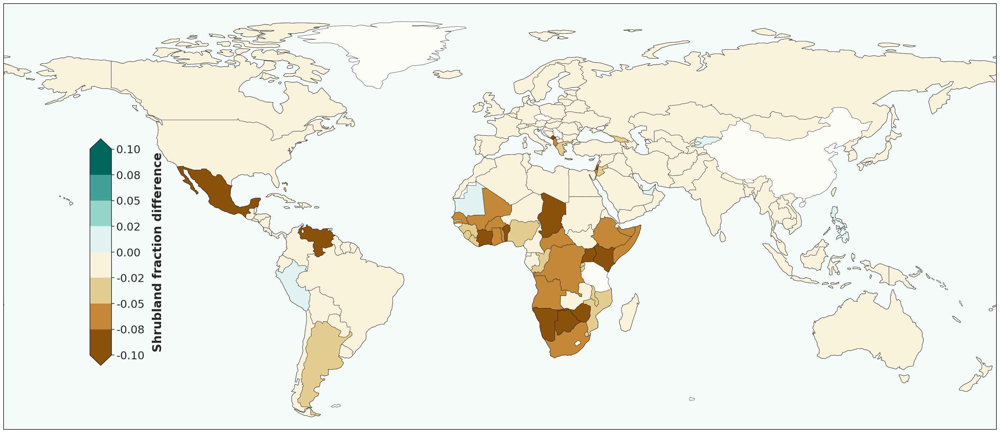

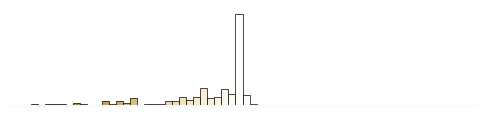

In [28]:
# ------------------------------------------------------------------
# IMPORTS
# ------------------------------------------------------------------
import sys
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import LinearSegmentedColormap, BoundaryNorm
from matplotlib.cm import ScalarMappable

# ------------------------------------------------------------------
# CONFIGURATION – adjust paths & parameters here
# ------------------------------------------------------------------
# Use the CSV with comprehensive vegetation data and country names
CSV_PATH    = Path('/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv')
SHAPE_PATH  = Path('/content/ne_110m_admin_0_countries.shp')

OUT_DIR     = Path('/content/CountryLevelStyled_TreeCover')
# --- Updated output filenames for Tree Cover analysis ---
OUT_MAP     = '/content/Fig2_Country_shrubland_Diff_Map.png'
OUT_HIST    = '/content/Fig2_Country_shrubland_Diff_Histogram.png'

MIN_CITIES       = 3       # Minimum city count to include a country
NUM_COLOR_BINS   = 8       # An even number yields symmetric bins around zero
NUM_HIST_BINS    = 60

# Diverging palette (brown ↔ white ↔ green)
DIVERGING_COLS = [
    '#8c510a', '#bf812d', '#dfc27d', '#f6e8c3',
    '#ffffff',          # Exact centre (0)
    '#c7eae5', '#80cdc1', '#35978f', '#01665e'
]

# ------------------------------------------------------------------
# HELPER – standardise names for merging
# ------------------------------------------------------------------
def _std_name(series: pd.Series) -> pd.Series:
    """Standardizes country names for robust merging."""
    return (series.str.lower()
                  .str.replace("&", "and")
                  .str.replace("-", " ")
                  .str.replace("[.,]", "", regex=True)
                  .str.strip())

# ------------------------------------------------------------------
# 1. LOAD CSV + CALCULATE TREE COVER DIFFERENCE
# ------------------------------------------------------------------
if not CSV_PATH.is_file():
    sys.exit(f"ERROR: CSV not found → {CSV_PATH}")

df = pd.read_csv(CSV_PATH, low_memory=False)

# --- Define required columns specifically for tree cover fraction ---
REQ = ["shrubland_area_urban", "shrubland_area_rural", "Urban_Area", "Buffer_area", "NAME_EN"]

missing = [c for c in REQ if c not in df.columns]
if missing:
    sys.exit(f"ERROR: missing column(s) {missing!r} in CSV")

# Ensure all calculation columns are numeric
for col in ["shrubland_area_urban", "shrubland_area_rural", "Urban_Area", "Buffer_area"]:
    df[col] = pd.to_numeric(df[col], errors='coerce')

df.dropna(subset=REQ, inplace=True)

# --- Calculate tree cover fractions and their difference ---
df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()
df['tree_urban_frac'] = df['shrubland_area_urban'] / df['Urban_Area']
df['tree_rural_frac'] = df['shrubland_area_rural'] / df['Buffer_area']
df['tree_diff'] = df['tree_urban_frac'] - df['tree_rural_frac']

# ------------------------------------------------------------------
# 2. REQUIRE MIN_CITIES PER COUNTRY & AGGREGATE
# ------------------------------------------------------------------
city_counts = df['NAME_EN'].value_counts()
countries_ok = city_counts[city_counts >= MIN_CITIES].index
print(f"Keeping {len(countries_ok)} countries with ≥{MIN_CITIES} cities for analysis.")

country_tree_diff = (df[df['NAME_EN'].isin(countries_ok)]
                    .groupby('NAME_EN', as_index=False)['tree_diff']
                    .mean()
                    .rename(columns={'tree_diff': 'mean_tree_diff'}))

# ------------------------------------------------------------------
# 2a. COMPUTE AND DISPLAY STATISTICS
# ------------------------------------------------------------------
print("\n" + "="*60)
print(" STATISTICAL SUMMARY OF COUNTRY-LEVEL TREE COVER DIFFERENCE")
print("="*60)

# Calculate overall statistics
mean_diff = country_tree_diff['mean_tree_diff'].mean()
std_diff = country_tree_diff['mean_tree_diff'].std()
country_count = len(country_tree_diff)

print(f"\nOverall Statistics for {country_count} countries:")
print(f"  - Mean Difference:      {mean_diff: .4f}")
print(f"  - Standard Deviation:   {std_diff: .4f}")

# Get Top 5 (Urban tree cover is higher)
top_5 = country_tree_diff.nlargest(5, 'mean_tree_diff')
print("\nTop 5 Countries (Higher Urban Tree Cover vs. Rural):")
print(top_5.to_string(index=False))

# Get Bottom 5 (Rural tree cover is higher)
bottom_5 = country_tree_diff.nsmallest(5, 'mean_tree_diff')
print("\nBottom 5 Countries (Higher Rural Tree Cover vs. Urban):")
print(bottom_5.to_string(index=False))
print("="*60 + "\n")


# ------------------------------------------------------------------
# 3. LOAD WORLD SHAPEFILE & MERGE
# ------------------------------------------------------------------
if not SHAPE_PATH.is_file():
    sys.exit(f"ERROR: shapefile not found → {SHAPE_PATH}")

world = gpd.read_file(SHAPE_PATH)
world = world[world.get('ADMIN', '') != 'Antarctica']

country_tree_diff['std_name'] = _std_name(country_tree_diff['NAME_EN'])
world['std_name'] = _std_name(world.get('ADMIN', world.get('NAME_EN')))

merged = world.merge(country_tree_diff[['std_name', 'mean_tree_diff']],
                     how='left', on='std_name').dropna(subset=['mean_tree_diff'])

if merged.empty:
    sys.exit("ERROR: no countries matched between CSV and shapefile.")

# ------------------------------------------------------------------
# 4. DISCRETE DIVERGING COLOUR SCALE
# ------------------------------------------------------------------
vals = merged['mean_tree_diff'].to_numpy()
abs_lim = np.percentile(np.abs(vals), 95)
abs_lim = max(abs_lim, 0.1)

bounds = np.linspace(-abs_lim, abs_lim, NUM_COLOR_BINS + 1)
cmap   = LinearSegmentedColormap.from_list('tree_div', DIVERGING_COLS, N=256)
norm   = BoundaryNorm(bounds, ncolors=256)

# ------------------------------------------------------------------
# 5. CHOROPLETH MAP
# ------------------------------------------------------------------
fig, ax = plt.subplots(figsize=(30, 18),
                       subplot_kw={'projection': ccrs.PlateCarree()})

ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')
ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')

merged.plot(column='mean_tree_diff', cmap=cmap, norm=norm,
            ax=ax, edgecolor='black', linewidth=0.4,
            missing_kwds={'color': 'lightgrey', 'label': 'No data'})

ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

cbar_ax = fig.add_axes([0.13, 0.27, 0.02, 0.35])
sm = ScalarMappable(norm=norm, cmap=cmap); sm._A = []
cbar = plt.colorbar(sm, cax=cbar_ax, orientation='vertical', extend='both')
# --- Updated colorbar label ---
cbar.set_label('Shrubland fraction difference', fontsize=24, labelpad=15, fontweight='bold')
cbar.ax.tick_params(labelsize=20)
cbar.set_ticks(bounds)
cbar.set_ticklabels([f'{b:.2f}' for b in bounds])
cbar.ax.tick_params(labelsize=22)

plt.subplots_adjust(left=0.05, right=0.97, top=0.95, bottom=0.05)
OUT_DIR.mkdir(parents=True, exist_ok=True)
plt.savefig(OUT_MAP, dpi=400, bbox_inches='tight',
            format='png', transparent=True)

plt.show()

# ------------------------------------------------------------------
# 6. MINIMALIST HISTOGRAM (colour‑matched)
# ------------------------------------------------------------------
def minimalist_hist(series: pd.Series, bounds_arr, bins, cmap_obj, path):
    """Creates and saves a minimalist histogram with bars colored by value."""
    series = series[(series >= bounds_arr[0]) & (series <= bounds_arr[-1])]
    if series.empty:
        print("No data in histogram range – skipped."); return

    norm_h = plt.Normalize(vmin=bounds_arr[0], vmax=bounds_arr[-1])
    fig, ax = plt.subplots(figsize=(6, 1.25))

    counts, edges, patches = ax.hist(
        series,
        bins=np.linspace(bounds_arr[0], bounds_arr[-1], bins + 1),
        edgecolor='black', linewidth=0.5
    )

    for p, l, r in zip(patches, edges[:-1], edges[1:]):
        p.set_facecolor(cmap_obj(norm_h((l + r) / 2)))

    ax.set_xticks([]); ax.set_yticks([])
    for s in ax.spines.values(): s.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbfc')
    ax.spines['bottom'].set_linewidth(1.5)

    fig.patch.set_alpha(0); ax.patch.set_alpha(0)
    plt.savefig(path, dpi=400, bbox_inches='tight',
                format='png', transparent=True)
    # print(f"Styled histogram saved → {path.resolve()}")
    plt.show()

# Generate the histogram with data and styling from the map
minimalist_hist(
    series=merged['mean_tree_diff'],
    bounds_arr=bounds,
    bins=NUM_HIST_BINS,
    cmap_obj=cmap,
    path=OUT_HIST
)

/tmp/ipython-input-2015532326.py:263: DtypeWarning: Columns (57,59,60,62,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)



Map saved to: /content/EDFig4C.pdf
Summary stats saved to: /content/EDFig4C__summary_stats.csv


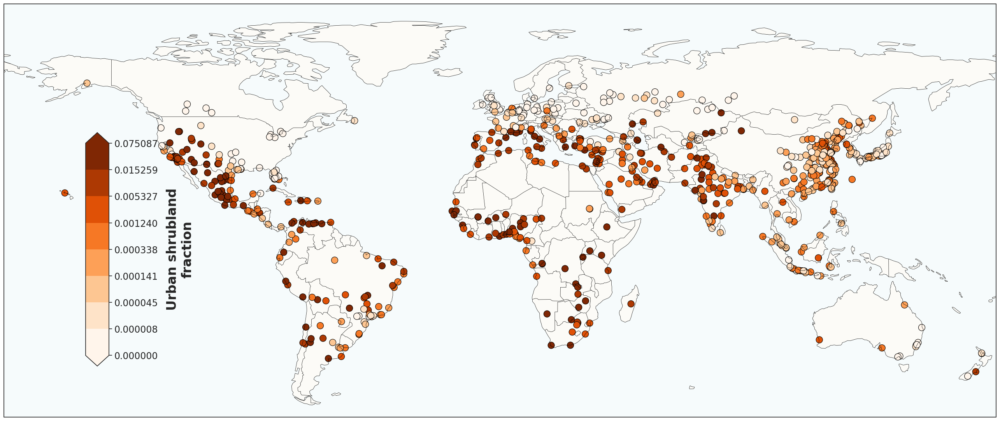

Histogram saved → /content/EDFig4C__hist.pdf


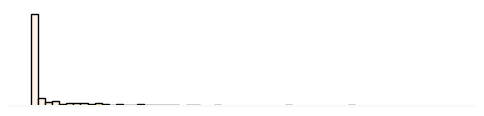

In [29]:
import os
import sys
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd  # optional; not required below
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm

# ====================== Stats helpers ======================

def _safe_stats(series: pd.Series) -> dict:
    """Return n, mean, and stderr for a numeric series."""
    s = pd.to_numeric(series, errors="coerce").dropna()
    n = int(s.shape[0])
    if n == 0:
        return {"n": 0, "mean": np.nan, "stderr": np.nan}
    if n >= 2:
        std = float(s.std(ddof=1))
        stderr = std / math.sqrt(n)
    else:
        std = 0.0
        stderr = float("nan")
    return {"n": n, "mean": float(s.mean()), "stderr": float(stderr)}

def _write_summary_csv(summary_df: pd.DataFrame, output_path: str) -> str:
    """Write the summary table next to the figure if output_path is provided."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    os.makedirs(out_dir, exist_ok=True)
    base = os.path.splitext(os.path.basename(output_path))[0]
    csv_path = os.path.join(out_dir, f"{base}__summary_stats.csv")
    summary_df.to_csv(csv_path, index=False)
    return csv_path

def _hist_path_from(output_path: str) -> str:
    """Build a sibling histogram path from the map output path."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    base = os.path.splitext(os.path.basename(output_path))[0]
    return os.path.join(out_dir, f"{base}__hist.pdf")

# ====================== Breaks engine ======================

def _nice_number(x: float, round_: bool = True) -> float:
    """
    Return a 'nice' number approximately equal to x.
    R-like pretty helper: 1, 2, or 5 times a power of 10.
    """
    if x <= 0 or not np.isfinite(x):
        return 0.0
    expv = math.floor(math.log10(x))
    f = x / 10**expv  # [1, 10)
    if round_:
        if   f < 1.5: nf = 1
        elif f < 3:   nf = 2
        elif f < 7:   nf = 5
        else:         nf = 10
    else:
        if   f <= 1:  nf = 1
        elif f <= 2:  nf = 2
        elif f <= 5:  nf = 5
        else:         nf = 10
    return nf * 10**expv

def pretty_breaks(data_min: float, data_max: float, n_classes: int) -> np.ndarray:
    """Compute 'pretty' equal-interval breaks with rounded tick marks."""
    if not np.isfinite(data_min) or not np.isfinite(data_max):
        raise ValueError("Non-finite data range for pretty breaks.")
    if data_min == data_max:
        delta = abs(data_min) if data_min != 0 else 1.0
        data_min -= 0.5 * delta
        data_max += 0.5 * delta
    raw_step = (data_max - data_min) / max(1, n_classes)
    step = _nice_number(raw_step, round_=True)
    lo = math.floor(data_min / step) * step
    hi = math.ceil(data_max / step) * step
    k = int(round((hi - lo) / step))
    bounds = lo + step * np.arange(k + 1)
    if len(bounds) < n_classes + 1:
        bounds = np.append(bounds, bounds[-1] + step)
    elif len(bounds) > n_classes + 1:
        keep_idx = np.linspace(0, len(bounds) - 1, num=n_classes + 1, dtype=int)
        bounds = bounds[keep_idx]
    return bounds.astype(float)

def quantile_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    qs = np.linspace(0.0, 1.0, n_classes + 1)
    return np.quantile(values, qs)

def equal_breaks(dmin: float, dmax: float, n_classes: int) -> np.ndarray:
    return np.linspace(dmin, dmax, n_classes + 1)

def jenks_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    """
    Fisher–Jenks optimal breaks (O(n*k) DP). No external deps.
    Returns sorted bounds length n_classes+1 (min..max).
    """
    x = np.sort(values[np.isfinite(values)])
    n = x.size
    k = max(1, n_classes)
    if n == 0:
        raise ValueError("No finite values for Jenks.")
    if k >= n:
        return np.unique(np.concatenate(([x[0]], x))).astype(float)

    # cumulative sums for fast variance
    csum = np.zeros(n + 1); csum2 = np.zeros(n + 1)
    csum[1:] = np.cumsum(x); csum2[1:] = np.cumsum(x * x)

    def range_var(i: int, j: int) -> float:
        m = j - i + 1
        s = csum[j + 1] - csum[i]
        s2 = csum2[j + 1] - csum2[i]
        mean = s / m
        return s2 - m * mean * mean

    mat = np.full((k + 1, n), np.inf); idx = np.full((k + 1, n), -1, dtype=int)
    for i in range(n):
        mat[1, i] = range_var(0, i); idx[1, i] = 0

    for kk in range(2, k + 1):
        for i in range(kk - 1, n):
            best = np.inf; best_j = -1
            for j in range(kk - 2, i):
                v = mat[kk - 1, j] + range_var(j + 1, i)
                if v < best:
                    best = v; best_j = j
            mat[kk, i] = best; idx[kk, i] = best_j

    breaks_idx, kk, last = [n - 1], k, n - 1
    while kk > 1:
        j = idx[kk, last]
        breaks_idx.append(j); last = j; kk -= 1
    breaks_idx.append(-1); breaks_idx = sorted(breaks_idx)

    bounds = [x[0]]
    for a, b in zip(breaks_idx[:-1], breaks_idx[1:]):
        bounds.append(x[b + 1])
    bounds[-1] = x[-1]
    return np.array(bounds, dtype=float)

def compute_bounds(values: np.ndarray,
                   n_classes: int = 8,
                   method: str = "quantile",
                   robust_clip: bool = True,
                   low_pct: float = 2.0,
                   high_pct: float = 98.0) -> np.ndarray:
    """Compute class bounds for a 1-D numeric array."""
    v = values[np.isfinite(values)]
    if v.size == 0:
        raise ValueError("No finite values to compute bounds.")

    if robust_clip:
        lo = np.percentile(v, low_pct)
        hi = np.percentile(v, high_pct)
        v = v[(v >= lo) & (v <= hi)]
        if v.size == 0:
            raise ValueError("All values removed by robust clipping.")

    dmin, dmax = float(v.min()), float(v.max())
    if dmin == dmax:
        eps = 1e-6 * (abs(dmin) + 1.0)
        dmin -= eps; dmax += eps

    method = method.lower()
    if   method == "quantile": bounds = quantile_breaks(v, n_classes)
    elif method == "equal":    bounds = equal_breaks(dmin, dmax, n_classes)
    elif method == "pretty":   bounds = pretty_breaks(dmin, dmax, n_classes)
    elif method == "jenks":
        try:                   bounds = jenks_breaks(v, n_classes)
        except Exception:      bounds = quantile_breaks(v, n_classes)
    else:
        raise ValueError(f"Unknown break method: {method}")

    bounds = np.array(bounds, dtype=float)
    bounds[0]  = min(bounds[0], dmin)
    bounds[-1] = max(bounds[-1], dmax)
    bounds = np.unique(np.round(bounds, 10))
    if bounds.size < 2:
        bounds = np.array([dmin, dmax], dtype=float)
    return bounds

# ====================== Minimalist histogram ======================

def create_frequency_histogram(
    data_series: pd.Series,
    lower_bound: float,
    upper_bound: float,
    num_bins: int,
    cmap,
    out_path: str
) -> None:
    """
    Minimalist frequency histogram; bars colored by the continuous colormap
    evaluated at the bin mid-point. Transparent background.
    """
    try:
        s = pd.to_numeric(data_series, errors="coerce").dropna()
        filtered = s[(s >= lower_bound) & (s <= upper_bound)]
    except Exception as e:
        print(f"Histogram input error: {e}")
        return

    if filtered.empty:
        print("No data in bounds for histogram.")
        return

    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)
    norm = plt.Normalize(vmin=lower_bound, vmax=upper_bound)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        _, bin_edges, patches = ax.hist(filtered, bins=bins, edgecolor='black')
    except Exception as e:
        print(f"Error generating histogram: {e}")
        plt.close(fig)
        return

    for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
        mid = 0.5 * (left + right)
        patch.set_facecolor(cmap(norm(mid)))

    ax.set_xticks([]); ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbf7')
    ax.spines['bottom'].set_linewidth(1.5)
    fig.patch.set_alpha(0); ax.patch.set_alpha(0)

    try:
        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram saved → {out_path}")
    except Exception as e:
        print(f"Error saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)

# ====================== Main plotting ======================

def analyze_and_plot_combined(file_path,
                              output_path,
                              n_classes: int = 8,
                              break_method: str = "quantile",
                              robust_clip: bool = True,
                              pct_low: float = 2.0,
                              pct_high: float = 98.0,
                              hist_bins: int = 60,
                              base_cmap_name: str = "YlGn"):
    """
    Loads data, computes urban shrubland fraction, maps it with chosen breaks,
    and writes a palette-matched minimalist histogram beside the map.
    """
    # 1) Load & validate
    try:
        df = pd.read_csv(file_path)
        df = df.nlargest(1000, 'Urban_Area').copy()
        # optional: keep any rows (>=0) so zero shrubland cities still appear in histogram tails if within bounds
        df = df[df["shrubland_area_urban"] >= 0].copy()
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # 2) Required columns
    required_columns = [
        "shrubland_area_urban", "Urban_Area", "Buffer_area", "lat", "lon"
    ]
    for col in required_columns:
        if col not in df.columns:
            raise ValueError(f"Required column '{col}' not found in data.")
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=required_columns)

    # 3) Denominators and fractions
    df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()
    if df.empty:
        raise RuntimeError("No rows with Urban_Area > 0 AND Buffer_area > 0.")

    df["shrubland_fraction_urban"] = (
        df["shrubland_area_urban"] / df["Urban_Area"]
    ).clip(lower=0, upper=1)  # area-fraction guard

    df = df[df["shrubland_fraction_urban"] >= 0.0000001].copy()


    # 4) Compute class bounds with chosen method
    vals = df["shrubland_fraction_urban"].to_numpy()
    bounds = compute_bounds(
        vals,
        n_classes=n_classes,
        method=break_method,
        robust_clip=robust_clip,
        low_pct=pct_low,
        high_pct=pct_high
    )

    # Reflect clipping on colorbar's extend
    extend = "neither"
    if robust_clip:
        vmin_raw, vmax_raw = float(np.nanmin(vals)), float(np.nanmax(vals))
        if bounds[0] > vmin_raw and bounds[-1] < vmax_raw:
            extend = "both"
        elif bounds[0] > vmin_raw:
            extend = "min"
        elif bounds[-1] < vmax_raw:
            extend = "max"

    # 5) Colormap & norm (discrete for the map; continuous for the histogram)
    n_bins = max(1, len(bounds) - 1)
    cmap_discrete = plt.get_cmap(base_cmap_name, n_bins)
    cmap_cont     = plt.get_cmap(base_cmap_name)
    norm_seq = BoundaryNorm(boundaries=bounds, ncolors=n_bins, clip=False)

    # 6) Plot map
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5)
    ax.add_feature(cfeature.OCEAN, facecolor="lightblue", alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor="#fcfbf7")
    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    sc = ax.scatter(
        df["lon"], df["lat"],
        c=df["shrubland_fraction_urban"],
        cmap=cmap_discrete, norm=norm_seq,
        s=150, edgecolors="black", linewidths=0.8,
        transform=ccrs.PlateCarree()
    )

    # 7) Colorbar
    cax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cb = plt.colorbar(sc, cax=cax, orientation="vertical", extend=extend)
    cb.set_label("Urban shrubland\nfraction", fontsize=24, labelpad=15, weight="bold")
    cb.ax.tick_params(labelsize=17)
    cb.set_ticks(bounds)
    cb.set_ticklabels([f"{b:.6f}" for b in bounds])

    # 8) Summary CSV (optional)
    summary = {"metric": ["shrubland_fraction_urban"], **_safe_stats(df["shrubland_fraction_urban"])}
    summary_df = pd.DataFrame([summary])
    csv_out = _write_summary_csv(summary_df, output_path)

    # 9) Save map
    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)
    if output_path:
        os.makedirs(os.path.dirname(output_path), exist_ok=True)
        try:
            plt.savefig(output_path, dpi=400, bbox_inches="tight", format='pdf', transparent=True)
            print(f"\nMap saved to: {output_path}")
            if csv_out:
                print(f"Summary stats saved to: {csv_out}")
        except Exception as e:
            print(f"Error saving map: {e}")
    plt.show()

    # 10) Histogram using the SAME bounds (consistency with the map)
    hist_out = _hist_path_from(output_path)
    if hist_out:
        create_frequency_histogram(
            data_series=df["shrubland_fraction_urban"],
            lower_bound=bounds[0],
            upper_bound=bounds[-1],
            num_bins=hist_bins,
            cmap=cmap_cont,
            out_path=hist_out
        )

# ====================== CLI ======================

if __name__ == "__main__":
    FILE_PATH = "/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv"
    OUTPUT_DIR = "/content/"
    OUTPUT_FILE = os.path.join(OUTPUT_DIR, "EDFig4C.pdf")

    # User-tunable parameters
    N_CLASSES    = 8
    BREAK_METHOD = "quantile"  # 'quantile' | 'equal' | 'pretty' | 'jenks'
    ROBUST_CLIP  = True        # clip to percentiles before computing breaks
    PCT_LOW      = 2.0
    PCT_HIGH     = 98.0
    HIST_BINS    = 60
    BASE_CMAP    = "Oranges"      # shrubland-friendly; try 'YlGnBu' or 'Greens' if preferred

    try:
        analyze_and_plot_combined(
            file_path=FILE_PATH,
            output_path=OUTPUT_FILE,
            n_classes=N_CLASSES,
            break_method=BREAK_METHOD,
            robust_clip=ROBUST_CLIP,
            pct_low=PCT_LOW,
            pct_high=PCT_HIGH,
            hist_bins=HIST_BINS,
            base_cmap_name=BASE_CMAP
        )
    except (FileNotFoundError, ValueError, RuntimeError) as e:
        print(f"An error occurred: {e}", file=sys.stderr)
        sys.exit(1)


/tmp/ipython-input-28061674.py:263: DtypeWarning: Columns (57,59,60,62,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file_path)



Map saved to: /content/SDF1C.pdf
Summary stats saved to: /content/SDF1C__summary_stats.csv


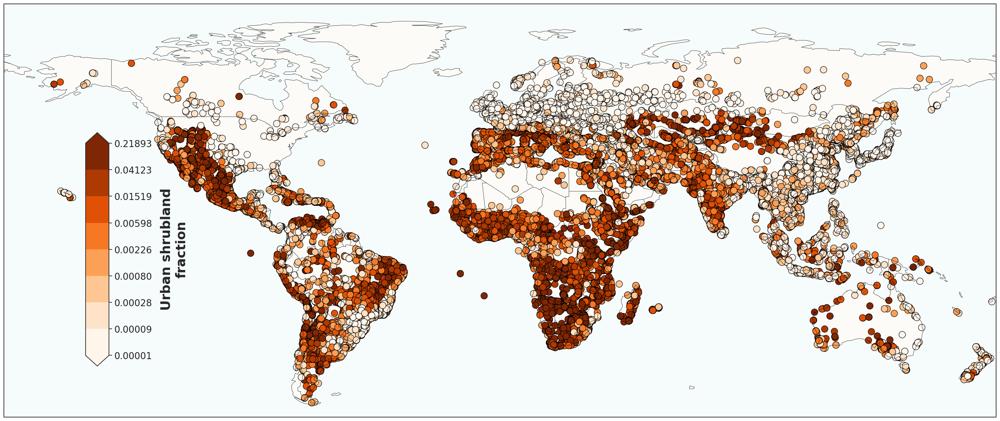

Histogram saved → /content/SDF1C__hist.pdf


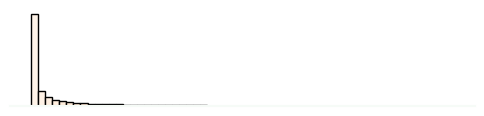

In [30]:
import os
import sys
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd  # optional; not required below
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm

# ====================== Stats helpers ======================

def _safe_stats(series: pd.Series) -> dict:
    """Return n, mean, and stderr for a numeric series."""
    s = pd.to_numeric(series, errors="coerce").dropna()
    n = int(s.shape[0])
    if n == 0:
        return {"n": 0, "mean": np.nan, "stderr": np.nan}
    if n >= 2:
        std = float(s.std(ddof=1))
        stderr = std / math.sqrt(n)
    else:
        std = 0.0
        stderr = float("nan")
    return {"n": n, "mean": float(s.mean()), "stderr": float(stderr)}

def _write_summary_csv(summary_df: pd.DataFrame, output_path: str) -> str:
    """Write the summary table next to the figure if output_path is provided."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    os.makedirs(out_dir, exist_ok=True)
    base = os.path.splitext(os.path.basename(output_path))[0]
    csv_path = os.path.join(out_dir, f"{base}__summary_stats.csv")
    summary_df.to_csv(csv_path, index=False)
    return csv_path

def _hist_path_from(output_path: str) -> str:
    """Build a sibling histogram path from the map output path."""
    if not output_path:
        return ""
    out_dir = os.path.dirname(output_path)
    base = os.path.splitext(os.path.basename(output_path))[0]
    return os.path.join(out_dir, f"{base}__hist.pdf")

# ====================== Breaks engine ======================

def _nice_number(x: float, round_: bool = True) -> float:
    """
    Return a 'nice' number approximately equal to x.
    R-like pretty helper: 1, 2, or 5 times a power of 10.
    """
    if x <= 0 or not np.isfinite(x):
        return 0.0
    expv = math.floor(math.log10(x))
    f = x / 10**expv  # [1, 10)
    if round_:
        if   f < 1.5: nf = 1
        elif f < 3:   nf = 2
        elif f < 7:   nf = 5
        else:         nf = 10
    else:
        if   f <= 1:  nf = 1
        elif f <= 2:  nf = 2
        elif f <= 5:  nf = 5
        else:         nf = 10
    return nf * 10**expv

def pretty_breaks(data_min: float, data_max: float, n_classes: int) -> np.ndarray:
    """Compute 'pretty' equal-interval breaks with rounded tick marks."""
    if not np.isfinite(data_min) or not np.isfinite(data_max):
        raise ValueError("Non-finite data range for pretty breaks.")
    if data_min == data_max:
        delta = abs(data_min) if data_min != 0 else 1.0
        data_min -= 0.5 * delta
        data_max += 0.5 * delta
    raw_step = (data_max - data_min) / max(1, n_classes)
    step = _nice_number(raw_step, round_=True)
    lo = math.floor(data_min / step) * step
    hi = math.ceil(data_max / step) * step
    k = int(round((hi - lo) / step))
    bounds = lo + step * np.arange(k + 1)
    if len(bounds) < n_classes + 1:
        bounds = np.append(bounds, bounds[-1] + step)
    elif len(bounds) > n_classes + 1:
        keep_idx = np.linspace(0, len(bounds) - 1, num=n_classes + 1, dtype=int)
        bounds = bounds[keep_idx]
    return bounds.astype(float)

def quantile_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    qs = np.linspace(0.0, 1.0, n_classes + 1)
    return np.quantile(values, qs)

def equal_breaks(dmin: float, dmax: float, n_classes: int) -> np.ndarray:
    return np.linspace(dmin, dmax, n_classes + 1)

def jenks_breaks(values: np.ndarray, n_classes: int) -> np.ndarray:
    """
    Fisher–Jenks optimal breaks (O(n*k) DP). No external deps.
    Returns sorted bounds length n_classes+1 (min..max).
    """
    x = np.sort(values[np.isfinite(values)])
    n = x.size
    k = max(1, n_classes)
    if n == 0:
        raise ValueError("No finite values for Jenks.")
    if k >= n:
        return np.unique(np.concatenate(([x[0]], x))).astype(float)

    # cumulative sums for fast variance
    csum = np.zeros(n + 1); csum2 = np.zeros(n + 1)
    csum[1:] = np.cumsum(x); csum2[1:] = np.cumsum(x * x)

    def range_var(i: int, j: int) -> float:
        m = j - i + 1
        s = csum[j + 1] - csum[i]
        s2 = csum2[j + 1] - csum2[i]
        mean = s / m
        return s2 - m * mean * mean

    mat = np.full((k + 1, n), np.inf); idx = np.full((k + 1, n), -1, dtype=int)
    for i in range(n):
        mat[1, i] = range_var(0, i); idx[1, i] = 0

    for kk in range(2, k + 1):
        for i in range(kk - 1, n):
            best = np.inf; best_j = -1
            for j in range(kk - 2, i):
                v = mat[kk - 1, j] + range_var(j + 1, i)
                if v < best:
                    best = v; best_j = j
            mat[kk, i] = best; idx[kk, i] = best_j

    breaks_idx, kk, last = [n - 1], k, n - 1
    while kk > 1:
        j = idx[kk, last]
        breaks_idx.append(j); last = j; kk -= 1
    breaks_idx.append(-1); breaks_idx = sorted(breaks_idx)

    bounds = [x[0]]
    for a, b in zip(breaks_idx[:-1], breaks_idx[1:]):
        bounds.append(x[b + 1])
    bounds[-1] = x[-1]
    return np.array(bounds, dtype=float)

def compute_bounds(values: np.ndarray,
                   n_classes: int = 8,
                   method: str = "quantile",
                   robust_clip: bool = True,
                   low_pct: float = 2.0,
                   high_pct: float = 98.0) -> np.ndarray:
    """Compute class bounds for a 1-D numeric array."""
    v = values[np.isfinite(values)]
    if v.size == 0:
        raise ValueError("No finite values to compute bounds.")

    if robust_clip:
        lo = np.percentile(v, low_pct)
        hi = np.percentile(v, high_pct)
        v = v[(v >= lo) & (v <= hi)]
        if v.size == 0:
            raise ValueError("All values removed by robust clipping.")

    dmin, dmax = float(v.min()), float(v.max())
    if dmin == dmax:
        eps = 1e-6 * (abs(dmin) + 1.0)
        dmin -= eps; dmax += eps

    method = method.lower()
    if   method == "quantile": bounds = quantile_breaks(v, n_classes)
    elif method == "equal":    bounds = equal_breaks(dmin, dmax, n_classes)
    elif method == "pretty":   bounds = pretty_breaks(dmin, dmax, n_classes)
    elif method == "jenks":
        try:                   bounds = jenks_breaks(v, n_classes)
        except Exception:      bounds = quantile_breaks(v, n_classes)
    else:
        raise ValueError(f"Unknown break method: {method}")

    bounds = np.array(bounds, dtype=float)
    bounds[0]  = min(bounds[0], dmin)
    bounds[-1] = max(bounds[-1], dmax)
    bounds = np.unique(np.round(bounds, 10))
    if bounds.size < 2:
        bounds = np.array([dmin, dmax], dtype=float)
    return bounds

# ====================== Minimalist histogram ======================

def create_frequency_histogram(
    data_series: pd.Series,
    lower_bound: float,
    upper_bound: float,
    num_bins: int,
    cmap,
    out_path: str
) -> None:
    """
    Minimalist frequency histogram; bars colored by the continuous colormap
    evaluated at the bin mid-point. Transparent background.
    """
    try:
        s = pd.to_numeric(data_series, errors="coerce").dropna()
        filtered = s[(s >= lower_bound) & (s <= upper_bound)]
    except Exception as e:
        print(f"Histogram input error: {e}")
        return

    if filtered.empty:
        print("No data in bounds for histogram.")
        return

    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)
    norm = plt.Normalize(vmin=lower_bound, vmax=upper_bound)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        _, bin_edges, patches = ax.hist(filtered, bins=bins, edgecolor='black')
    except Exception as e:
        print(f"Error generating histogram: {e}")
        plt.close(fig)
        return

    for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
        mid = 0.5 * (left + right)
        patch.set_facecolor(cmap(norm(mid)))

    ax.set_xticks([]); ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.spines['bottom'].set_visible(True)
    ax.spines['bottom'].set_color('#f6fbf7')
    ax.spines['bottom'].set_linewidth(1.5)
    fig.patch.set_alpha(0); ax.patch.set_alpha(0)

    try:
        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram saved → {out_path}")
    except Exception as e:
        print(f"Error saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)

# ====================== Main plotting ======================

def analyze_and_plot_combined(file_path,
                              output_path,
                              n_classes: int = 8,
                              break_method: str = "quantile",
                              robust_clip: bool = True,
                              pct_low: float = 2.0,
                              pct_high: float = 98.0,
                              hist_bins: int = 60,
                              base_cmap_name: str = "YlGn"):
    """
    Loads data, computes urban shrubland fraction, maps it with chosen breaks,
    and writes a palette-matched minimalist histogram beside the map.
    """
    # 1) Load & validate
    try:
        df = pd.read_csv(file_path)
        # df = df.nlargest(1000, 'Urban_Area').copy()
        # optional: keep any rows (>=0) so zero shrubland cities still appear in histogram tails if within bounds
        df = df[df["shrubland_area_urban"] >= 0.0000001].copy()
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # 2) Required columns
    required_columns = [
        "shrubland_area_urban", "Urban_Area", "Buffer_area", "lat", "lon"
    ]
    for col in required_columns:
        if col not in df.columns:
            raise ValueError(f"Required column '{col}' not found in data.")
        df[col] = pd.to_numeric(df[col], errors="coerce")
    df = df.dropna(subset=required_columns)

    # 3) Denominators and fractions
    df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()
    if df.empty:
        raise RuntimeError("No rows with Urban_Area > 0 AND Buffer_area > 0.")

    df["shrubland_fraction_urban"] = (
        df["shrubland_area_urban"] / df["Urban_Area"]
    ).clip(lower=0, upper=1)  # area-fraction guard

    df = df[df["shrubland_fraction_urban"] >= 0.0000001].copy()

    # 4) Compute class bounds with chosen method
    vals = df["shrubland_fraction_urban"].to_numpy()
    bounds = compute_bounds(
        vals,
        n_classes=n_classes,
        method=break_method,
        robust_clip=robust_clip,
        low_pct=pct_low,
        high_pct=pct_high
    )

    # Reflect clipping on colorbar's extend
    extend = "neither"
    if robust_clip:
        vmin_raw, vmax_raw = float(np.nanmin(vals)), float(np.nanmax(vals))
        if bounds[0] > vmin_raw and bounds[-1] < vmax_raw:
            extend = "both"
        elif bounds[0] > vmin_raw:
            extend = "min"
        elif bounds[-1] < vmax_raw:
            extend = "max"

    # 5) Colormap & norm (discrete for the map; continuous for the histogram)
    n_bins = max(1, len(bounds) - 1)
    cmap_discrete = plt.get_cmap(base_cmap_name, n_bins)
    cmap_cont     = plt.get_cmap(base_cmap_name)
    norm_seq = BoundaryNorm(boundaries=bounds, ncolors=n_bins, clip=False)

    # 6) Plot map
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5)
    ax.add_feature(cfeature.OCEAN, facecolor="lightblue", alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor="#fcfbf7")
    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    sc = ax.scatter(
        df["lon"], df["lat"],
        c=df["shrubland_fraction_urban"],
        cmap=cmap_discrete, norm=norm_seq,
        s=150, edgecolors="black", linewidths=0.8,
        transform=ccrs.PlateCarree()
    )

    # 7) Colorbar
    cax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cb = plt.colorbar(sc, cax=cax, orientation="vertical", extend=extend)
    cb.set_label("Urban shrubland\nfraction", fontsize=24, labelpad=15, weight="bold")
    cb.ax.tick_params(labelsize=17)
    cb.set_ticks(bounds)
    cb.set_ticklabels([f"{b:.5f}" for b in bounds])

    # 8) Summary CSV (optional)
    summary = {"metric": ["shrubland_fraction_urban"], **_safe_stats(df["shrubland_fraction_urban"])}
    summary_df = pd.DataFrame([summary])
    csv_out = _write_summary_csv(summary_df, output_path)

    # 9) Save map
    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)
    if output_path:
        os.makedirs(os.path.dirname(output_path), exist_ok=True)
        try:
            plt.savefig(output_path, dpi=400, bbox_inches="tight", format='pdf', transparent=True)
            print(f"\nMap saved to: {output_path}")
            if csv_out:
                print(f"Summary stats saved to: {csv_out}")
        except Exception as e:
            print(f"Error saving map: {e}")
    plt.show()

    # 10) Histogram using the SAME bounds (consistency with the map)
    hist_out = _hist_path_from(output_path)
    if hist_out:
        create_frequency_histogram(
            data_series=df["shrubland_fraction_urban"],
            lower_bound=bounds[0],
            upper_bound=bounds[-1],
            num_bins=hist_bins,
            cmap=cmap_cont,
            out_path=hist_out
        )

# ====================== CLI ======================

if __name__ == "__main__":
    FILE_PATH = "/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv"
    OUTPUT_DIR = "/content/"
    OUTPUT_FILE = os.path.join(OUTPUT_DIR, "SDF1C.pdf")

    # User-tunable parameters
    N_CLASSES    = 8
    BREAK_METHOD = "quantile"  # 'quantile' | 'equal' | 'pretty' | 'jenks'
    ROBUST_CLIP  = True        # clip to percentiles before computing breaks
    PCT_LOW      = 2.0
    PCT_HIGH     = 98.0
    HIST_BINS    = 60
    BASE_CMAP    = "Oranges"      # shrubland-friendly; try 'YlGnBu' or 'Greens' if preferred

    try:
        analyze_and_plot_combined(
            file_path=FILE_PATH,
            output_path=OUTPUT_FILE,
            n_classes=N_CLASSES,
            break_method=BREAK_METHOD,
            robust_clip=ROBUST_CLIP,
            pct_low=PCT_LOW,
            pct_high=PCT_HIGH,
            hist_bins=HIST_BINS,
            base_cmap_name=BASE_CMAP
        )
    except (FileNotFoundError, ValueError, RuntimeError) as e:
        print(f"An error occurred: {e}", file=sys.stderr)
        sys.exit(1)


=== Top-N (by Urban_Area) BOTH-ZERO report ===
Top 1000 cities: BOTH urban & rural shrub ≈ 0 → 155
Preview (up to 25 rows):
                 country   Urban_Area  Buffer_area  shrubland_area_urban  shrubland_area_rural  shrubland_urban_normalized  shrubland_rural_normalized       lat        lon
United States of America 1.858017e+09 1.858520e+09                   0.0                   0.0                         0.0                         0.0 33.880406 -84.355259
United States of America 1.341009e+09 1.335714e+09                   0.0                   0.0                         0.0                         0.0 40.700700 -74.266727
United States of America 1.178347e+09 1.198199e+09                   0.0                   0.0                         0.0                         0.0 42.361825 -71.128045
United States of America 1.089538e+09 1.105133e+09                   0.0                   0.0                         0.0                         0.0 40.005924 -75.170093
United States of

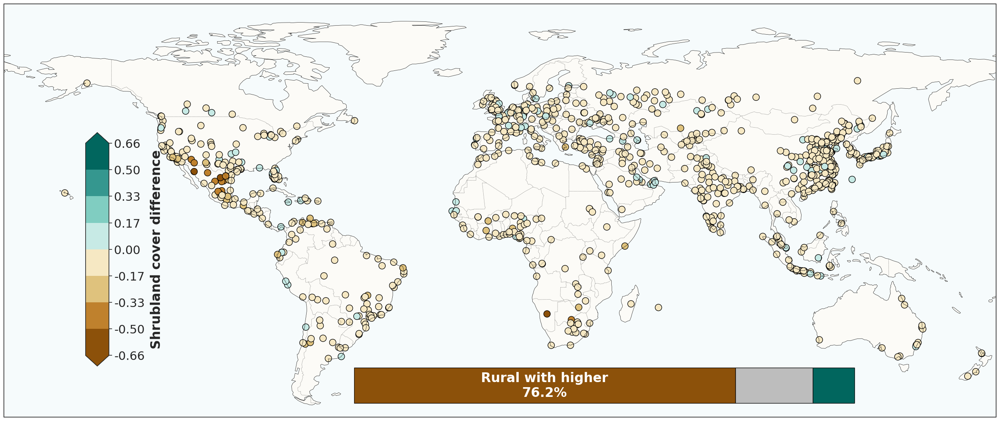

Histogram successfully saved to /content/EDFig5C_hist.pdf


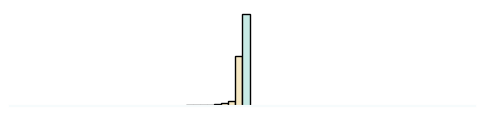

In [31]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import ListedColormap, BoundaryNorm, LinearSegmentedColormap
import geopandas as gpd

# -------------------------
# CONFIG
# -------------------------
INPUT_PATH  = '/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv'
OUT_DIR     = '/content/'
MAP_PDF     = os.path.join(OUT_DIR, 'EDFig5C_map.pdf')
HIST_PDF    = os.path.join(OUT_DIR, 'EDFig5C_hist.pdf')

TOP_N_BY_URBAN = 1000
CLIP_TO_UNIT   = True
NBINS_HIST     = 60
EPS_ZERO       = 1e-12  # treat |x| <= EPS_ZERO as zero for normalized fractions

# Optional: export the Top-N both-zero rows to CSV
EXPORT_BOTHZERO_CSV = True
BOTHZERO_CSV_PATH   = os.path.join(OUT_DIR, 'top1000_both_zero_shrubland.csv')

# === Diverging palette (even length, no white center) ===
DIVERGING_COLS = [
    '#8c510a', '#bf812d', '#dfc27d', '#f6e8c3',  # negative
    '#c7eae5', '#80cdc1', '#35978f', '#01665e'   # positive
]
NEG_COLOR = '#8c510a'  # rural>urban segment (left)
POS_COLOR = '#01665e'  # urban>rural segment (right)
EQ_COLOR  = '#bdbdbd'  # equal shrub cover (middle)

REQUIRED_COLUMNS = [
    'shrubland_area_urban', 'shrubland_area_rural',
    'Urban_Area', 'Buffer_area', 'lat', 'lon'
]


def _symmetric_bounds(values: np.ndarray, n_colors: int) -> np.ndarray:
    if n_colors % 2 != 0:
        raise ValueError("DIVERGING_COLS must have an even length.")
    if values.size == 0:
        raise ValueError("No values provided for bounds.")
    vmin = float(np.nanmin(values))
    vmax = float(np.nanmax(values))
    abs_max = max(abs(vmin), abs(vmax), 1e-12)  # guard if all zeros
    return np.linspace(-abs_max, abs_max, n_colors + 1)


def create_frequency_histogram_discrete(
    data_series: pd.Series,
    bounds: np.ndarray,
    cmap_discrete: ListedColormap,
    norm_discrete: BoundaryNorm,
    num_bins: int,
    out_path: str,
) -> None:
    """
    Minimalist frequency histogram of the urban–rural cover differences.

    Colors:
      - Uses the same DISCRETE colormap and BoundaryNorm as the map/cbar.
      - Each bar is colored by the class of its bin midpoint.
    """
    lower_bound = float(bounds[0])
    upper_bound = float(bounds[-1])

    filtered = data_series[(data_series >= lower_bound) & (data_series <= upper_bound)]
    if filtered.empty:
        print("No data available within specified bounds for histogram.")
        return

    # Histogram bins: many more than the color classes, but all binned within same range
    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        counts, bin_edges, patches = ax.hist(
            filtered,
            bins=bins,
            edgecolor='black'
        )

        # Color each bin according to its midpoint, using the SAME discrete norm & cmap
        for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
            midpoint = 0.5 * (left + right)
            # BoundaryNorm returns an integer index into the colormap
            color = cmap_discrete(norm_discrete(midpoint))
            patch.set_facecolor(color)

        # Minimalist styling
        ax.set_xticks([])
        ax.set_yticks([])
        for spine in ax.spines.values():
            spine.set_visible(False)
        ax.spines['bottom'].set_visible(True)
        ax.spines['bottom'].set_color('#f6fbfc')
        ax.spines['bottom'].set_linewidth(1.5)

        fig.patch.set_alpha(0)
        ax.patch.set_alpha(0)

        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram successfully saved to {out_path}")
    except Exception as e:
        print(f"Error generating/saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)


def analyze_shrubland_difference(file_path):
    # ---------- Load ----------
    try:
        data = gpd.read_file(file_path)
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # ---------- Validate & cast ----------
    missing = [c for c in REQUIRED_COLUMNS if c not in data.columns]
    if missing:
        raise ValueError(f"Required column(s) missing: {missing}")

    for col in REQUIRED_COLUMNS:
        data[col] = pd.to_numeric(data[col], errors='coerce')

    # Drop NaNs and non-positive areas to avoid division-by-zero
    data = data.dropna(subset=REQUIRED_COLUMNS).copy()
    data = data[(data['Urban_Area'] > 0) & (data['Buffer_area'] > 0)].copy()
    if data.empty:
        raise ValueError("No valid rows after removing NaNs/zero areas.")

    # ---------- Normalize ----------
    data['shrubland_urban_normalized'] = data['shrubland_area_urban'] / data['Urban_Area']
    data['shrubland_rural_normalized'] = data['shrubland_area_rural'] / data['Buffer_area']

    # ---------- Difference on full set ----------
    data['shrubland_difference'] = (
        data['shrubland_urban_normalized'] - data['shrubland_rural_normalized']
    )

    # ---------- REPORT: BOTH-ZERO inside Top-N by Urban_Area (pre-exclusion) ----------
    topN_all = data.nlargest(TOP_N_BY_URBAN, 'Urban_Area').copy()
    both_zero_topN_mask = (
        (topN_all['shrubland_urban_normalized'].abs() <= EPS_ZERO) &
        (topN_all['shrubland_rural_normalized'].abs() <= EPS_ZERO)
    )
    both_zero_topN = topN_all[both_zero_topN_mask].copy()

    id_cols = [c for c in ['shapeName', 'city', 'name', 'country', 'iso3', 'id'] if c in topN_all.columns]
    cols_to_show = id_cols + [
        'Urban_Area', 'Buffer_area',
        'shrubland_area_urban', 'shrubland_area_rural',
        'shrubland_urban_normalized', 'shrubland_rural_normalized',
        'lat', 'lon'
    ]
    cols_to_show = [c for c in cols_to_show if c in both_zero_topN.columns]

    print("=== Top-N (by Urban_Area) BOTH-ZERO report ===")
    print(f"Top {TOP_N_BY_URBAN} cities: BOTH urban & rural shrub ≈ 0 → {len(both_zero_topN)}")
    if not both_zero_topN.empty:
        preview = both_zero_topN[cols_to_show].head(25)
        with pd.option_context('display.max_columns', None, 'display.width', 180):
            print("Preview (up to 25 rows):")
            print(preview.to_string(index=False))
        if EXPORT_BOTHZERO_CSV:
            os.makedirs(OUT_DIR, exist_ok=True)
            both_zero_topN[cols_to_show].to_csv(BOTHZERO_CSV_PATH, index=False)
            print(f"Full list saved: {BOTHZERO_CSV_PATH}")

    # ---------- BAR / HIST BASE SET: apply clip only ----------
    data_bar = data.copy()
    if CLIP_TO_UNIT:
        data_bar = data_bar[
            (data_bar['shrubland_difference'] >= -1) &
            (data_bar['shrubland_difference'] <= 1)
        ].copy()
    if data_bar.empty:
        raise ValueError("No rows remain after clipping for bar/hist.")

    # Limit bar/hist *summary* to Top-N by Urban_Area
    data_bar_top = data_bar.nlargest(TOP_N_BY_URBAN, 'Urban_Area').copy()
    if data_bar_top.empty:
        raise ValueError("No rows remain in Top-N set for bar/hist.")

    # ---------- EXCLUDE BOTH-ZERO for plotting (map) ----------
    both_zero_mask_all = (
        (data_bar['shrubland_urban_normalized'].abs() <= EPS_ZERO) &
        (data_bar['shrubland_rural_normalized'].abs() <= EPS_ZERO)
    )
    data_plot = data_bar[~both_zero_mask_all].copy()
    if data_plot.empty:
        raise ValueError("No rows remain after excluding both-zero normalized shrub fractions.")

    # Top-N by urban area (AFTER exclusion) for plotting
    data_plot = data_plot.nlargest(TOP_N_BY_URBAN, 'Urban_Area').copy()

    # For the MAP only: drop cities with exactly zero difference
    data_map = data_plot[data_plot['shrubland_difference'] != 0].copy()
    if data_map.empty:
        raise ValueError("No non-zero shrubland differences for map after filtering.")

    # ---------- PRINT COUNTS (plotted set) ----------
    n_plotted = int(len(data_map))
    n_urban_pos = int((data_map['shrubland_urban_normalized'] > EPS_ZERO).sum())
    n_rural_pos = int((data_map['shrubland_rural_normalized'] > EPS_ZERO).sum())

    print("=== Shrubland counts (plotted set, non-zero diff) ===")
    print(f"Cities plotted (after filters): {n_plotted}")
    print(f"Urban shrub > 0: {n_urban_pos}")
    print(f"Rural shrub > 0: {n_rural_pos}")

    # ---------- Discrete colormap (symmetric around 0, based on map set) ----------
    vals = data_map['shrubland_difference'].to_numpy()
    discrete_bounds = _symmetric_bounds(vals, n_colors=len(DIVERGING_COLS))
    cmap_discrete = ListedColormap(DIVERGING_COLS)
    discrete_norm = BoundaryNorm(discrete_bounds, len(DIVERGING_COLS), clip=True)

    # ---------- Map ----------
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')

    sc = ax.scatter(
        data_map['lon'], data_map['lat'],
        c=data_map['shrubland_difference'],
        cmap=cmap_discrete,
        norm=discrete_norm,
        s=150, alpha=1,
        edgecolors='black', linewidths=1,
        transform=ccrs.PlateCarree()
    )
    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    # Colorbar
    cbar_ax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cbar = plt.colorbar(sc, cax=cbar_ax, orientation='vertical', extend='both')
    cbar.set_label('Shrubland cover difference', fontsize=24, labelpad=10, weight='bold')
    cbar.ax.tick_params(labelsize=22)
    cbar.set_ticks(discrete_bounds)
    cbar.set_ticklabels([f"{x:.2f}" for x in discrete_bounds])

    # ---------- Inset stacked bar (Rural-left, Equal-middle, Urban-right) ----------
    # Use Top-N (after clipping), not all cities
    urban_count = int((data_bar_top['shrubland_difference'] > 0).sum())
    rural_count = int((data_bar_top['shrubland_difference'] < 0).sum())
    equal_count = int((data_bar_top['shrubland_difference'] == 0).sum())
    total_count = int(len(data_bar_top))
    if total_count == 0:
        raise ValueError("No observations available to compute percentages (Top-N).")

    rural_percent = 100.0 * rural_count / total_count
    urban_percent = 100.0 * urban_count / total_count
    equal_percent = 100.0 * equal_count / total_count

    bar_ax = fig.add_axes([0.40, 0.25, 0.45, 0.05])
    bar_ax.set_axis_off()

    # Rural segment (LEFT, brown)
    bar_ax.barh([''], [rural_percent], color=NEG_COLOR,
                edgecolor='black', height=0.4)

    # Equal segment (MIDDLE, grey) if present
    if equal_percent > 0:
        bar_ax.barh([''], [equal_percent], color=EQ_COLOR,
                    edgecolor='black', height=0.4, left=rural_percent)
        urban_left = rural_percent + equal_percent
    else:
        urban_left = rural_percent

    # Urban segment (RIGHT, green)
    bar_ax.barh([''], [urban_percent], color=POS_COLOR,
                edgecolor='black', height=0.4, left=urban_left)

    # Labels: keep your existing text pattern, only on rural side
    bar_ax.text(rural_percent / 2.0, 0,
                f"Rural with higher\n{rural_percent:.1f}%",
                ha='center', va='center', fontsize=24, color='white', weight='bold')
    bar_ax.text(urban_left + urban_percent / 2.0, 0,
                f"",
                ha='center', va='center', fontsize=24, color='white', weight='bold')

    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)

    # ---------- Save map ----------
    os.makedirs(OUT_DIR, exist_ok=True)
    try:
        plt.savefig(MAP_PDF, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Map successfully saved to {MAP_PDF}")
    except Exception as e:
        print(f"Error saving map: {e}")
    finally:
        plt.show()
        plt.close(fig)

    # ---------- Histogram (still all clipped cities, not only Top-N) ----------
    cmap_continuous = LinearSegmentedColormap.from_list("custom_cont", DIVERGING_COLS, N=256)
    create_frequency_histogram_discrete(
        data_series=data['shrubland_difference'],
        bounds=discrete_bounds,
        cmap_discrete=cmap_discrete,
        norm_discrete=discrete_norm,
        num_bins=NBINS_HIST,
        out_path=HIST_PDF
    )


if __name__ == "__main__":
    try:
        analyze_shrubland_difference(INPUT_PATH)
    except Exception as e:
        print(f"An error occurred during analysis: {e}")


=== Top-N (by Urban_Area) BOTH-ZERO report ===
Top 83102 cities: BOTH urban & rural shrub ≈ 0 → 41182
Preview (up to 25 rows):
                 country   Urban_Area  Buffer_area  shrubland_area_urban  shrubland_area_rural  shrubland_urban_normalized  shrubland_rural_normalized       lat        lon
United States of America 1.858017e+09 1.858520e+09                   0.0                   0.0                         0.0                         0.0 33.880406 -84.355259
United States of America 1.341009e+09 1.335714e+09                   0.0                   0.0                         0.0                         0.0 40.700700 -74.266727
United States of America 1.178347e+09 1.198199e+09                   0.0                   0.0                         0.0                         0.0 42.361825 -71.128045
United States of America 1.089538e+09 1.105133e+09                   0.0                   0.0                         0.0                         0.0 40.005924 -75.170093
United States

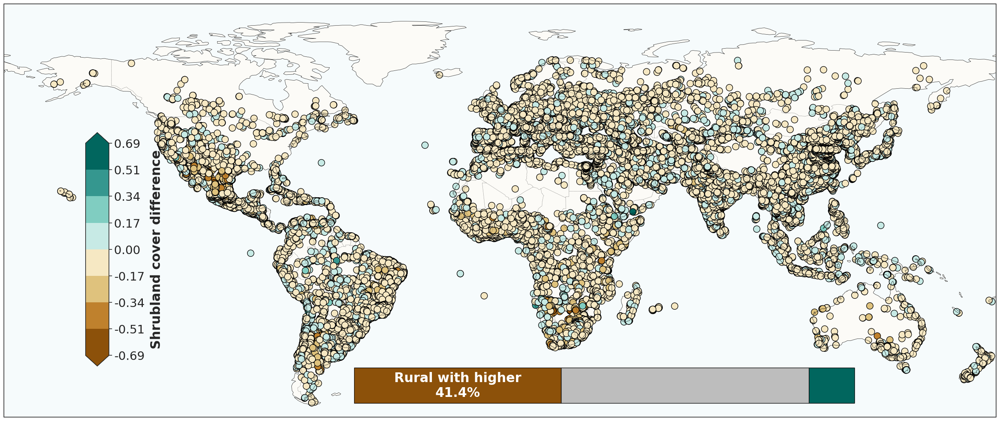

Histogram successfully saved to /content/S2CFig_hist.pdf


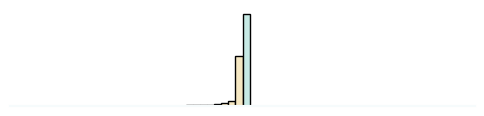

In [32]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import ListedColormap, BoundaryNorm, LinearSegmentedColormap
import geopandas as gpd

# -------------------------
# CONFIG
# -------------------------
INPUT_PATH  = '/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries.csv'
OUT_DIR     = '/content/'
MAP_PDF     = os.path.join(OUT_DIR, 'S2CFig_map.pdf')
HIST_PDF    = os.path.join(OUT_DIR, 'S2CFig_hist.pdf')

TOP_N_BY_URBAN = 83102
CLIP_TO_UNIT   = True
NBINS_HIST     = 60
EPS_ZERO       = 1e-12  # treat |x| <= EPS_ZERO as zero for normalized fractions

# Optional: export the Top-N both-zero rows to CSV
EXPORT_BOTHZERO_CSV = True
BOTHZERO_CSV_PATH   = os.path.join(OUT_DIR, 'top1000_both_zero_shrubland.csv')

# === Diverging palette (even length, no white center) ===
DIVERGING_COLS = [
    '#8c510a', '#bf812d', '#dfc27d', '#f6e8c3',  # negative
    '#c7eae5', '#80cdc1', '#35978f', '#01665e'   # positive
]
NEG_COLOR = '#8c510a'  # rural>urban segment (left)
POS_COLOR = '#01665e'  # urban>rural segment (right)
EQ_COLOR  = '#bdbdbd'  # equal shrub cover (middle)

REQUIRED_COLUMNS = [
    'shrubland_area_urban', 'shrubland_area_rural',
    'Urban_Area', 'Buffer_area', 'lat', 'lon'
]


def _symmetric_bounds(values: np.ndarray, n_colors: int) -> np.ndarray:
    if n_colors % 2 != 0:
        raise ValueError("DIVERGING_COLS must have an even length.")
    if values.size == 0:
        raise ValueError("No values provided for bounds.")
    vmin = float(np.nanmin(values))
    vmax = float(np.nanmax(values))
    abs_max = max(abs(vmin), abs(vmax), 1e-12)  # guard if all zeros
    return np.linspace(-abs_max, abs_max, n_colors + 1)


import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm

def create_frequency_histogram_discrete(
    data_series: pd.Series,
    bounds: np.ndarray,
    cmap_discrete: ListedColormap,
    norm_discrete: BoundaryNorm,
    num_bins: int,
    out_path: str,
) -> None:
    """
    Minimalist frequency histogram of the urban–rural cover differences.

    Colors:
      - Uses the same DISCRETE colormap and BoundaryNorm as the map/cbar.
      - Each bar is colored by the class of its bin midpoint.
    """
    lower_bound = float(bounds[0])
    upper_bound = float(bounds[-1])

    filtered = data_series[(data_series >= lower_bound) & (data_series <= upper_bound)]
    if filtered.empty:
        print("No data available within specified bounds for histogram.")
        return

    # Histogram bins: many more than the color classes, but all binned within same range
    bins = np.linspace(lower_bound, upper_bound, num_bins + 1)

    fig, ax = plt.subplots(figsize=(6, 1.25))
    try:
        counts, bin_edges, patches = ax.hist(
            filtered,
            bins=bins,
            edgecolor='black'
        )

        # Color each bin according to its midpoint, using the SAME discrete norm & cmap
        for patch, left, right in zip(patches, bin_edges[:-1], bin_edges[1:]):
            midpoint = 0.5 * (left + right)
            # BoundaryNorm returns an integer index into the colormap
            color = cmap_discrete(norm_discrete(midpoint))
            patch.set_facecolor(color)

        # Minimalist styling
        ax.set_xticks([])
        ax.set_yticks([])
        for spine in ax.spines.values():
            spine.set_visible(False)
        ax.spines['bottom'].set_visible(True)
        ax.spines['bottom'].set_color('#f6fbfc')
        ax.spines['bottom'].set_linewidth(1.5)

        fig.patch.set_alpha(0)
        ax.patch.set_alpha(0)

        os.makedirs(os.path.dirname(out_path), exist_ok=True)
        plt.savefig(out_path, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Histogram successfully saved to {out_path}")
    except Exception as e:
        print(f"Error generating/saving histogram: {e}")
    finally:
        plt.show()
        plt.close(fig)



def analyze_shrubland_difference(file_path):
    # ---------- Load ----------
    try:
        data = gpd.read_file(file_path)
    except Exception as e:
        raise FileNotFoundError(f"Error reading file '{file_path}': {e}")

    # ---------- Validate & cast ----------
    missing = [c for c in REQUIRED_COLUMNS if c not in data.columns]
    if missing:
        raise ValueError(f"Required column(s) missing: {missing}")

    for col in REQUIRED_COLUMNS:
        data[col] = pd.to_numeric(data[col], errors='coerce')

    # Drop NaNs and non-positive areas to avoid division-by-zero
    data = data.dropna(subset=REQUIRED_COLUMNS).copy()
    data = data[(data['Urban_Area'] > 0) & (data['Buffer_area'] > 0)].copy()
    if data.empty:
        raise ValueError("No valid rows after removing NaNs/zero areas.")

    # ---------- Normalize ----------
    data['shrubland_urban_normalized'] = data['shrubland_area_urban'] / data['Urban_Area']
    data['shrubland_rural_normalized'] = data['shrubland_area_rural'] / data['Buffer_area']

    # ---------- Difference on full set ----------
    data['shrubland_difference'] = (
        data['shrubland_urban_normalized'] - data['shrubland_rural_normalized']
    )

    # ---------- REPORT: BOTH-ZERO inside Top-N by Urban_Area (pre-exclusion) ----------
    topN_all = data.nlargest(TOP_N_BY_URBAN, 'Urban_Area').copy()
    both_zero_topN_mask = (
        (topN_all['shrubland_urban_normalized'].abs() <= EPS_ZERO) &
        (topN_all['shrubland_rural_normalized'].abs() <= EPS_ZERO)
    )
    both_zero_topN = topN_all[both_zero_topN_mask].copy()

    id_cols = [c for c in ['shapeName', 'city', 'name', 'country', 'iso3', 'id'] if c in topN_all.columns]
    cols_to_show = id_cols + [
        'Urban_Area', 'Buffer_area',
        'shrubland_area_urban', 'shrubland_area_rural',
        'shrubland_urban_normalized', 'shrubland_rural_normalized',
        'lat', 'lon'
    ]
    cols_to_show = [c for c in cols_to_show if c in both_zero_topN.columns]

    print("=== Top-N (by Urban_Area) BOTH-ZERO report ===")
    print(f"Top {TOP_N_BY_URBAN} cities: BOTH urban & rural shrub ≈ 0 → {len(both_zero_topN)}")
    if not both_zero_topN.empty:
        preview = both_zero_topN[cols_to_show].head(25)
        with pd.option_context('display.max_columns', None, 'display.width', 180):
            print("Preview (up to 25 rows):")
            print(preview.to_string(index=False))
        if EXPORT_BOTHZERO_CSV:
            os.makedirs(OUT_DIR, exist_ok=True)
            both_zero_topN[cols_to_show].to_csv(BOTHZERO_CSV_PATH, index=False)
            print(f"Full list saved: {BOTHZERO_CSV_PATH}")

    # ---------- BAR / HIST BASE SET: apply clip only ----------
    data_bar = data.copy()
    if CLIP_TO_UNIT:
        data_bar = data_bar[
            (data_bar['shrubland_difference'] >= -1) &
            (data_bar['shrubland_difference'] <= 1)
        ].copy()
    if data_bar.empty:
        raise ValueError("No rows remain after clipping for bar/hist.")

    # Limit bar/hist *summary* to Top-N by Urban_Area
    data_bar_top = data_bar.nlargest(TOP_N_BY_URBAN, 'Urban_Area').copy()
    if data_bar_top.empty:
        raise ValueError("No rows remain in Top-N set for bar/hist.")

    # ---------- EXCLUDE BOTH-ZERO for plotting (map) ----------
    both_zero_mask_all = (
        (data_bar['shrubland_urban_normalized'].abs() <= EPS_ZERO) &
        (data_bar['shrubland_rural_normalized'].abs() <= EPS_ZERO)
    )
    data_plot = data_bar[~both_zero_mask_all].copy()
    if data_plot.empty:
        raise ValueError("No rows remain after excluding both-zero normalized shrub fractions.")

    # Top-N by urban area (AFTER exclusion) for plotting
    data_plot = data_plot.nlargest(TOP_N_BY_URBAN, 'Urban_Area').copy()

    # For the MAP only: drop cities with exactly zero difference
    data_map = data_plot[data_plot['shrubland_difference'] != 0].copy()
    if data_map.empty:
        raise ValueError("No non-zero shrubland differences for map after filtering.")

    # ---------- PRINT COUNTS (plotted set) ----------
    n_plotted = int(len(data_map))
    n_urban_pos = int((data_map['shrubland_urban_normalized'] > EPS_ZERO).sum())
    n_rural_pos = int((data_map['shrubland_rural_normalized'] > EPS_ZERO).sum())

    print("=== Shrubland counts (plotted set, non-zero diff) ===")
    print(f"Cities plotted (after filters): {n_plotted}")
    print(f"Urban shrub > 0: {n_urban_pos}")
    print(f"Rural shrub > 0: {n_rural_pos}")

    # ---------- Discrete colormap (symmetric around 0, based on map set) ----------
    vals = data_map['shrubland_difference'].to_numpy()
    discrete_bounds = _symmetric_bounds(vals, n_colors=len(DIVERGING_COLS))
    cmap_discrete = ListedColormap(DIVERGING_COLS)
    discrete_norm = BoundaryNorm(discrete_bounds, len(DIVERGING_COLS), clip=True)

    # ---------- Map ----------
    fig, ax = plt.subplots(figsize=(30, 20), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
    ax.add_feature(cfeature.BORDERS, linewidth=0.5, linestyle=':')
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.1)
    ax.add_feature(cfeature.LAND, facecolor='#fcfbf7')

    sc = ax.scatter(
        data_map['lon'], data_map['lat'],
        c=data_map['shrubland_difference'],
        cmap=cmap_discrete,
        norm=discrete_norm,
        s=150, alpha=1,
        edgecolors='black', linewidths=1,
        transform=ccrs.PlateCarree()
    )
    ax.set_extent([-180, 180, -60, 90], crs=ccrs.PlateCarree())

    # Colorbar
    cbar_ax = fig.add_axes([0.17, 0.3, 0.02, 0.3])
    cbar = plt.colorbar(sc, cax=cbar_ax, orientation='vertical', extend='both')
    cbar.set_label('Shrubland cover difference', fontsize=24, labelpad=10, weight='bold')
    cbar.ax.tick_params(labelsize=22)
    cbar.set_ticks(discrete_bounds)
    cbar.set_ticklabels([f"{x:.2f}" for x in discrete_bounds])

    # ---------- Inset stacked bar (Rural-left, Equal-middle, Urban-right) ----------
    # Use Top-N (after clipping), not all cities
    urban_count = int((data_bar_top['shrubland_difference'] > 0).sum())
    rural_count = int((data_bar_top['shrubland_difference'] < 0).sum())
    equal_count = int((data_bar_top['shrubland_difference'] == 0).sum())
    total_count = int(len(data_bar_top))
    if total_count == 0:
        raise ValueError("No observations available to compute percentages (Top-N).")

    rural_percent = 100.0 * rural_count / total_count
    urban_percent = 100.0 * urban_count / total_count
    equal_percent = 100.0 * equal_count / total_count

    bar_ax = fig.add_axes([0.40, 0.25, 0.45, 0.05])
    bar_ax.set_axis_off()

    # Rural segment (LEFT, brown)
    bar_ax.barh([''], [rural_percent], color=NEG_COLOR,
                edgecolor='black', height=0.4)

    # Equal segment (MIDDLE, grey) if present
    if equal_percent > 0:
        bar_ax.barh([''], [equal_percent], color=EQ_COLOR,
                    edgecolor='black', height=0.4, left=rural_percent)
        urban_left = rural_percent + equal_percent
    else:
        urban_left = rural_percent

    # Urban segment (RIGHT, green)
    bar_ax.barh([''], [urban_percent], color=POS_COLOR,
                edgecolor='black', height=0.4, left=urban_left)

    # Labels: keep your existing text pattern, only on rural side
    bar_ax.text(rural_percent / 2.0, 0,
                f"Rural with higher\n{rural_percent:.1f}%",
                ha='center', va='center', fontsize=24, color='white', weight='bold')
    bar_ax.text(urban_left + urban_percent / 2.0, 0,
                f"",
                ha='center', va='center', fontsize=24, color='white', weight='bold')

    plt.subplots_adjust(left=0.1, right=0.95, top=0.95, bottom=0.05)

    # ---------- Save map ----------
    os.makedirs(OUT_DIR, exist_ok=True)
    try:
        plt.savefig(MAP_PDF, format='pdf', dpi=400, bbox_inches='tight', transparent=True)
        print(f"Map successfully saved to {MAP_PDF}")
    except Exception as e:
        print(f"Error saving map: {e}")
    finally:
        plt.show()
        plt.close(fig)

    # ---------- Histogram (still all clipped cities, not only Top-N) ----------
    cmap_continuous = LinearSegmentedColormap.from_list("custom_cont", DIVERGING_COLS, N=256)
    create_frequency_histogram_discrete(
        data_series=data['shrubland_difference'],
        bounds=discrete_bounds,
        cmap_discrete=cmap_discrete,
        norm_discrete=discrete_norm,
        num_bins=NBINS_HIST,
        out_path=HIST_PDF
    )


if __name__ == "__main__":
    try:
        analyze_shrubland_difference(INPUT_PATH)
    except Exception as e:
        print(f"An error occurred during analysis: {e}")


# GNS

Figure saved → /content/Fig2B_legend.pdf


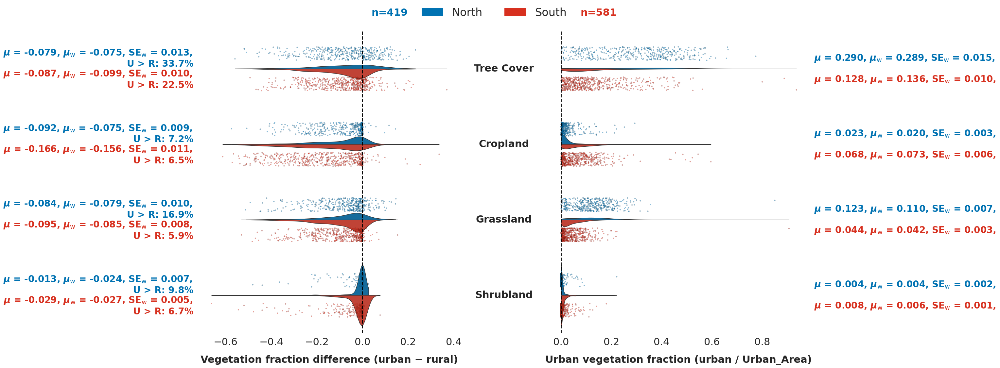

In [33]:
from __future__ import annotations
import os, sys
from typing import Dict, Tuple

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

# ------------------------------------------------------------------ #
# GLOBAL FONT SIZING
# ------------------------------------------------------------------ #
plt.rcParams.update({
    "font.size": 20,            # base font
    "axes.labelsize": 20,       # axis labels
    "axes.titlesize": 22,       # titles (if any)
    "xtick.labelsize": 22,      # defaults (we override explicitly later)
    "ytick.labelsize": 20,
    "legend.fontsize": 20,
})

XTICK_FONTSIZE = 20
XTICK_BOLD     = False

# ------------------------------------------------------------------ #
# CONFIGURATION
# ------------------------------------------------------------------ #
CSV_PATH   = "/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries_global_ns.csv"
N_LARGEST  = 1_000  # keep the largest N urban areas

VEG_TYPES: Dict[str, Tuple[str, str]] = {
    "Tree Cover": ("tree_cover_area_urban", "tree_cover_area_rural"),
    "Cropland":   ("cropland_area_urban",   "cropland_area_rural"),
    "Grassland":  ("grassland_area_urban",  "grassland_area_rural"),
    "Shrubland":  ("shrubland_area_urban",  "shrubland_area_rural"),
}

PALETTE = {"North": "#0072B2", "South": "#d7301f"}

# ------------------------------------------------------------------ #
# ETL HELPERS
# ------------------------------------------------------------------ #
def _basic_clean(path: str) -> pd.DataFrame:
    """Load CSV, normalize labels, keep rows with valid supports."""
    if not os.path.isfile(path):
        raise FileNotFoundError(f"CSV file not found: {path}")
    df = pd.read_csv(path, low_memory=False)

    required = {"Urban_Area", "Buffer_area", "GlobalNS"} | {
        c for pair in VEG_TYPES.values() for c in pair
    }
    missing = required.difference(df.columns)
    if missing:
        raise KeyError(f"Missing columns: {sorted(missing)}")

    df["GlobalNS"] = df["GlobalNS"].astype(str).str.strip().str.title()
    df = df[df["GlobalNS"].isin(PALETTE)].reset_index(drop=True)

    for col in ("Urban_Area", "Buffer_area"):
        df[col] = pd.to_numeric(df[col], errors="coerce")

    df = df.dropna(subset=["Urban_Area", "Buffer_area"])
    df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()
    return df


def load_top_n(path: str, n: int) -> pd.DataFrame:
    """Return Top-N by Urban_Area (ties kept) after basic cleaning."""
    df_all = _basic_clean(path)
    df_top = df_all.nlargest(n, "Urban_Area", keep="all").copy()
    return df_top


def compute_long_tables(df: pd.DataFrame) -> tuple[pd.DataFrame, pd.DataFrame]:
    """Return *veg_diff* and *urban_fraction* in long format with weights."""
    diff_frames, frac_frames = [], []

    for subtype, (u_col, r_col) in VEG_TYPES.items():
        urban_vals = pd.to_numeric(df[u_col], errors="coerce").fillna(0.0)
        rural_vals = pd.to_numeric(df[r_col], errors="coerce").fillna(0.0)

        # LEFT panel: difference; weight by Urban_Area + Buffer_area
        diff_frames.append(
            pd.DataFrame(
                {
                    "Subtype":  subtype,
                    "GlobalNS": df["GlobalNS"],
                    "value":    (urban_vals / df["Urban_Area"]
                                 - rural_vals / df["Buffer_area"]).astype(float),
                    "weight":   (df["Urban_Area"] + df["Buffer_area"]).astype(float),
                }
            )
        )

        # RIGHT panel: urban fraction; weight by Urban_Area
        frac_frames.append(
            pd.DataFrame(
                {
                    "Subtype":  subtype,
                    "GlobalNS": df["GlobalNS"],
                    "value":    (urban_vals / df["Urban_Area"]).astype(float),
                    "weight":   df["Urban_Area"].astype(float),
                }
            )
        )

    veg_diff = pd.concat(diff_frames, ignore_index=True)
    veg_frac = pd.concat(frac_frames, ignore_index=True)

    for tbl in (veg_diff, veg_frac):
        tbl["Subtype"] = pd.Categorical(tbl["Subtype"],
                                        categories=list(VEG_TYPES.keys()),
                                        ordered=True)
    return veg_diff, veg_frac


# ------------------------------------------------------------------ #
# PLOTTING CORE
# ------------------------------------------------------------------ #
def half_violin(ax: plt.Axes,
                data: pd.DataFrame,
                xlabel: str,
                *,
                labelpad: int = 16,
                zero_line: bool = True) -> None:
    """Draw a split half-violin + jitter on `ax` for *value* vs *Subtype*."""
    sns.violinplot(
        data=data, x="value", y="Subtype", hue="GlobalNS",
        palette=PALETTE, orient="h", split=True, inner=None,
        linewidth=1.0, cut=0, bw_method="scott", ax=ax, zorder=1,
    )
    ax.legend_.remove()

    sns.stripplot(
        data=data, x="value", y="Subtype", hue="GlobalNS",
        palette=PALETTE, orient="h", dodge=True, jitter=0.18,
        size=2.6, linewidth=0.2, edgecolor="black", alpha=0.45, ax=ax, zorder=2,
    )
    ax.legend_.remove()

    if zero_line:
        ax.axvline(0, linestyle="--", linewidth=2, color="black", zorder=10)

    ax.grid(False)
    sns.despine(ax=ax, left=True, bottom=True, right=True, top=True)

    ax.set_xlabel(xlabel, fontweight="bold", fontsize=22, labelpad=labelpad)
    ax.set_ylabel("")


# ------------------------------------------------------------------ #
# AREA-WEIGHTED + UNWEIGHTED STATS — μ_w, μ, and SE_w (+ n, U>R for LEFT)
# ------------------------------------------------------------------ #
def _compute_group_stats(data: pd.DataFrame) -> pd.DataFrame:
    """
    Return stats per Subtype×GlobalNS:
      - mu_w     : area-weighted mean
      - se_w     : area-weighted SE with Kish n_eff
      - mu_simple: unweighted mean
      - n_raw    : sample count
    """
    if data.empty:
        return pd.DataFrame(columns=["Subtype","GlobalNS","mu_w","se_w","mu_simple","n_raw"])

    def weighted_stats(group: pd.DataFrame) -> pd.Series:
        m = group["value"].notna() & group["weight"].notna()
        x = group.loc[m, "value"].to_numpy(dtype=float)
        w = group.loc[m, "weight"].to_numpy(dtype=float)
        n = int(x.size)
        if n == 0:
            return pd.Series({"mu_w": np.nan, "se_w": np.nan,
                              "mu_simple": np.nan, "n_raw": 0})

        W = float(w.sum())
        mu_w = float(np.sum(w * x) / W) if W > 0 else np.nan

        if n <= 1 or not np.isfinite(mu_w) or W <= 0:
            se_w = np.nan
        else:
            var_w = float(np.sum(w * (x - mu_w) ** 2) / W)
            n_eff = float(W * W / max(float(np.sum(w * w)), 1e-12))
            se_w = float(np.sqrt(var_w / max(n_eff, 1.0))) if np.isfinite(var_w) else np.nan

        mu_simple = float(np.nanmean(x)) if n > 0 else np.nan
        return pd.Series({"mu_w": mu_w, "se_w": se_w,
                          "mu_simple": mu_simple, "n_raw": n})

    stats = (data
             .groupby(["Subtype", "GlobalNS"], sort=False, observed=True)
             .apply(weighted_stats, include_groups=False)
             .reset_index())

    return stats[["Subtype","GlobalNS","mu_w","se_w","mu_simple","n_raw"]]


def annotate_stats_outside(
    ax: plt.Axes,
    data: pd.DataFrame,
    side: str = "left",
    *,
    add_upr: bool = False,
    upr_ref: float = 0.0,
    dy_axes: float = 0.018,
    pad_axes: float = 0.022,
    fontsize: int = 20
) -> None:
    """
    Annotate stats outside the plotting area along y categories.
      side='left'  → text anchored just left of the axes
      side='right' → text anchored just right of the axes
    If add_upr=True, also prints 'U > R: x%' where x is the unweighted
    share with value > upr_ref (used for LEFT panel difference).
    """
    assert side in {"left", "right"}

    stats_df = _compute_group_stats(data)
    categories = list(data["Subtype"].cat.categories)

    x_axes = -pad_axes if side == "left" else 1.0 + pad_axes
    ha = "right" if side == "left" else "left"

    for i, subtype in enumerate(categories):
        y_data = i
        y_disp = ax.transData.transform((0, y_data))[1]
        y_axes = ax.transAxes.inverted().transform((0, y_disp))[1]

        for group, color, dy in (("North", "#0072B2", +dy_axes),
                                 ("South", "#d7301f", -dy_axes)):
            row = stats_df[(stats_df.Subtype == subtype) & (stats_df.GlobalNS == group)]
            if row.empty:
                continue

            n_raw     = int(row["n_raw"].item())
            mu_w      = float(row["mu_w"].item())       if pd.notna(row["mu_w"].item()) else np.nan
            mu_simple = float(row["mu_simple"].item())  if pd.notna(row["mu_simple"].item()) else np.nan
            se_w      = float(row["se_w"].item())       if pd.notna(row["se_w"].item()) else np.nan

            label_mu_w      = "–" if not np.isfinite(mu_w)      else f"{mu_w:.3f}"
            label_mu_simple = "–" if not np.isfinite(mu_simple) else f"{mu_simple:.3f}"
            label_sew       = "–" if not np.isfinite(se_w)      else f"{se_w:.3f}"

            # Optional U>R %
            upr_txt = ""
            if add_upr:
                sub = data[(data["Subtype"] == subtype) & (data["GlobalNS"] == group)]
                vals = pd.to_numeric(sub["value"], errors="coerce").dropna()
                upr_pct = (vals > upr_ref).mean() * 100.0 if len(vals) else np.nan
                upr_lbl = "–" if not np.isfinite(upr_pct) else f"{upr_pct:.1f}%"
                upr_txt = f"\nU > R: {upr_lbl}"

            # New notation style (bold μ, μ_w, SE_w, n) — no overbars
            ann = (
                rf"$\boldsymbol{{\mu}}$ = {label_mu_simple}, "
                rf"$\boldsymbol{{\mu}}_{{\mathrm{{w}}}}$ = {label_mu_w}, "
                rf"$\mathbf{{SE}}_{{\mathrm{{w}}}}$ = {label_sew}, "
                f"{upr_txt}"
            )

            ax.text(
                x_axes, y_axes + dy, ann,
                transform=ax.transAxes, ha=ha, va="center",
                fontsize=fontsize, fontweight="bold",
                color=color, clip_on=False,
            )


# ------------------------------------------------------------------ #
# UTIL — tick style, counts from BASE DF, and numbers beside legend
# ------------------------------------------------------------------ #
def _force_xtick_style(ax: plt.Axes,
                       size: int = XTICK_FONTSIZE,
                       bold: bool = XTICK_BOLD) -> None:
    """Force x-tick label styling after seaborn plotting."""
    ax.tick_params(axis='x', labelsize=22)
    if bold:
        for lbl in ax.get_xticklabels():
            lbl.set_fontweight('bold')


def _counts_from_df(df_base: pd.DataFrame) -> dict:
    """Per-group sample counts from the Top-N dataframe."""
    vc = (df_base["GlobalNS"].value_counts()
          .reindex(["North", "South"])
          .fillna(0)
          .astype(int))
    return {"North": int(vc["North"]), "South": int(vc["South"])}


def _add_ns_beside_legend(fig: plt.Figure,
                          legend,
                          counts_after: dict,
                          pad_frac: float = 0.012,
                          fontsize: int = 20) -> None:
    """Place two plain 'n=####' numbers beside the legend (no N0)."""
    renderer = fig.canvas.get_renderer()
    bbox_fig = legend.get_window_extent(renderer=renderer).transformed(fig.transFigure.inverted())
    y_center = (bbox_fig.y0 + bbox_fig.y1) / 2.0

    left_x  = bbox_fig.x0 - pad_frac
    right_x = bbox_fig.x1 + pad_frac

    fig.text(left_x,  y_center, f"n={counts_after.get('North', 0)}",
             ha="right", va="center", fontsize=22, fontweight="bold",
             color=PALETTE["North"])
    fig.text(right_x, y_center, f"n={counts_after.get('South', 0)}",
             ha="left",  va="center", fontsize=22, fontweight="bold",
             color=PALETTE["South"])


# ------------------------------------------------------------------ #
# MAIN
# ------------------------------------------------------------------ #
def main() -> None:
    try:
        # Top-N dataset (after basic cleaning)
        df_top = load_top_n(CSV_PATH, N_LARGEST)

        # Long tables for plotting & stats
        tbl_diff, tbl_frac = compute_long_tables(df_top)

        sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

        fig, (ax_left, ax_right) = plt.subplots(
            ncols=2, sharey=True, figsize=(24, 12),
            gridspec_kw=dict(width_ratios=[1, 1], wspace=0.35)
        )

        # --------------------- plotting ---------------------------
        half_violin(
            ax_left, data=tbl_diff,
            xlabel="Vegetation fraction difference (urban − rural)",
            labelpad=18, zero_line=True,
        )
        _force_xtick_style(ax_left)

        half_violin(
            ax_right, data=tbl_frac,
            xlabel="Urban vegetation fraction (urban / Urban_Area)",
            labelpad=18, zero_line=True,
        )
        _force_xtick_style(ax_right)

        # ---------------- central subtype labels ------------------
        fig.canvas.draw()
        pos_left, pos_right = ax_left.get_position(), ax_right.get_position()
        x_mid = 0.5 * (pos_left.x1 + pos_right.x0)

        for tick in ax_left.get_yticklabels():
            label, y_data = tick.get_text(), tick.get_position()[1]
            y_disp = ax_left.transData.transform((0, y_data))[1]
            y_fig  = fig.transFigure.inverted().transform((0, y_disp))[1]
            fig.text(x_mid, y_fig, label, ha="center", va="center",
                     fontweight="bold", fontsize=22)

        ax_left.set_yticklabels([]);  ax_right.set_yticklabels([])

        # ------------------ per-category stats (μ_w, μ, SE_w, n; + U>R on LEFT) -------
        annotate_stats_outside(ax_left,  tbl_diff, side="left",
                               add_upr=True, upr_ref=0.0,
                               dy_axes=0.035, pad_axes=0.024, fontsize=20)
        annotate_stats_outside(ax_right, tbl_frac, side="right",
                               add_upr=False,
                               dy_axes=0.035, pad_axes=0.024, fontsize=20)

        # ------------------ legend + 'n=' numbers BESIDE it -------
        legend_handles = [
            Patch(facecolor=PALETTE["North"], edgecolor="none", label="North"),
            Patch(facecolor=PALETTE["South"], edgecolor="none", label="South"),
        ]
        lgd = fig.legend(
            legend_handles, ["North", "South"],
            frameon=False, ncol=2, loc="upper center",
            bbox_to_anchor=(0.5, 0.965),
            fontsize=24,
        )

        counts_after = _counts_from_df(df_top)
        _add_ns_beside_legend(fig, lgd, counts_after, pad_frac=0.012, fontsize=22)

        out_path = "/content/Fig2B_legend.pdf"
        plt.savefig(out_path, bbox_inches="tight")
        print(f"Figure saved → {out_path}")

    except Exception as err:
        import traceback
        traceback.print_exc()
        print(f"ERROR: {err}", file=sys.stderr)
        sys.exit(1)


if __name__ == "__main__":
    main()



LEFT panel — Vegetation fraction difference (urban − rural): μ_w, μ, SE_w, n, U>R %
   Subtype GlobalNS    n_raw    mu_w  mu_simple   se_w  upr_pct
Tree Cover    North 419.0000 -0.0750    -0.0788 0.0126  33.6516
Tree Cover    South 581.0000 -0.0992    -0.0867 0.0095  22.5473
  Cropland    North 419.0000 -0.0747    -0.0920 0.0088   7.1599
  Cropland    South 581.0000 -0.1562    -0.1659 0.0112   6.5404
 Grassland    North 419.0000 -0.0788    -0.0838 0.0099  16.9451
 Grassland    South 581.0000 -0.0847    -0.0954 0.0078   5.8520
 Shrubland    North 419.0000 -0.0237    -0.0126 0.0069   9.7852
 Shrubland    South 581.0000 -0.0268    -0.0288 0.0052   6.7126

RIGHT panel — Urban vegetation fraction (urban / Urban_Area): μ_w, μ, SE_w, n
   Subtype GlobalNS    n_raw   mu_w  mu_simple   se_w
Tree Cover    North 419.0000 0.2887     0.2902 0.0151
Tree Cover    South 581.0000 0.1363     0.1284 0.0096
  Cropland    North 419.0000 0.0199     0.0232 0.0032
  Cropland    South 581.0000 0.0726     0.06

/tmp/ipython-input-1511857757.py:230: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(stats_df["Subtype"])



Figure saved → /content/Fig2B_legend.pdf


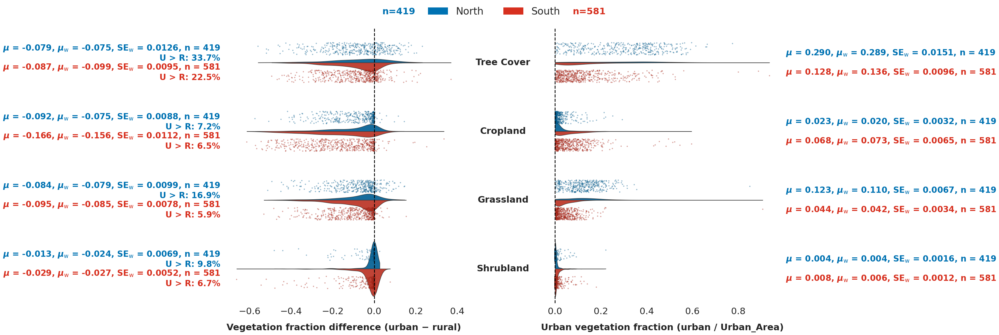

In [34]:
from __future__ import annotations
import os, sys
from typing import Dict, Tuple

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

# ------------------------------------------------------------------ #
# GLOBAL FONT SIZING
# ------------------------------------------------------------------ #
plt.rcParams.update({
    "font.size": 20,            # base font
    "axes.labelsize": 20,       # axis labels
    "axes.titlesize": 22,       # titles (if any)
    "xtick.labelsize": 22,      # defaults (we override explicitly later)
    "ytick.labelsize": 20,
    "legend.fontsize": 20,
})

XTICK_FONTSIZE = 20
XTICK_BOLD     = False

# ------------------------------------------------------------------ #
# CONFIGURATION
# ------------------------------------------------------------------ #
CSV_PATH   = "/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries_global_ns.csv"
N_LARGEST  = 1_000  # keep the largest N urban areas

VEG_TYPES: Dict[str, Tuple[str, str]] = {
    "Tree Cover": ("tree_cover_area_urban", "tree_cover_area_rural"),
    "Cropland":   ("cropland_area_urban",   "cropland_area_rural"),
    "Grassland":  ("grassland_area_urban",  "grassland_area_rural"),
    "Shrubland":  ("shrubland_area_urban",  "shrubland_area_rural"),
}

PALETTE = {"North": "#0072B2", "South": "#d7301f"}

# ------------------------------------------------------------------ #
# ETL HELPERS
# ------------------------------------------------------------------ #
def _basic_clean(path: str) -> pd.DataFrame:
    """Load CSV, normalize labels, keep rows with valid supports."""
    if not os.path.isfile(path):
        raise FileNotFoundError(f"CSV file not found: {path}")
    df = pd.read_csv(path, low_memory=False)

    required = {"Urban_Area", "Buffer_area", "GlobalNS"} | {
        c for pair in VEG_TYPES.values() for c in pair
    }
    missing = required.difference(df.columns)
    if missing:
        raise KeyError(f"Missing columns: {sorted(missing)}")

    df["GlobalNS"] = df["GlobalNS"].astype(str).str.strip().str.title()
    df = df[df["GlobalNS"].isin(PALETTE)].reset_index(drop=True)

    for col in ("Urban_Area", "Buffer_area"):
        df[col] = pd.to_numeric(df[col], errors="coerce")

    df = df.dropna(subset=["Urban_Area", "Buffer_area"])
    df = df[(df["Urban_Area"] > 0) & (df["Buffer_area"] > 0)].copy()
    return df


def load_top_n(path: str, n: int) -> pd.DataFrame:
    """Return Top-N by Urban_Area (ties kept) after basic cleaning."""
    df_all = _basic_clean(path)
    df_top = df_all.nlargest(n, "Urban_Area", keep="all").copy()
    return df_top


def compute_long_tables(df: pd.DataFrame) -> tuple[pd.DataFrame, pd.DataFrame]:
    """Return *veg_diff* and *urban_fraction* in long format with weights."""
    diff_frames, frac_frames = [], []

    for subtype, (u_col, r_col) in VEG_TYPES.items():
        urban_vals = pd.to_numeric(df[u_col], errors="coerce").fillna(0.0)
        rural_vals = pd.to_numeric(df[r_col], errors="coerce").fillna(0.0)

        # LEFT panel: difference; weight by Urban_Area + Buffer_area
        diff_frames.append(
            pd.DataFrame(
                {
                    "Subtype":  subtype,
                    "GlobalNS": df["GlobalNS"],
                    "value":    (urban_vals / df["Urban_Area"]
                                 - rural_vals / df["Buffer_area"]).astype(float),
                    "weight":   (df["Urban_Area"] + df["Buffer_area"]).astype(float),
                }
            )
        )

        # RIGHT panel: urban fraction; weight by Urban_Area
        frac_frames.append(
            pd.DataFrame(
                {
                    "Subtype":  subtype,
                    "GlobalNS": df["GlobalNS"],
                    "value":    (urban_vals / df["Urban_Area"]).astype(float),
                    "weight":   df["Urban_Area"].astype(float),
                }
            )
        )

    veg_diff = pd.concat(diff_frames, ignore_index=True)
    veg_frac = pd.concat(frac_frames, ignore_index=True)

    for tbl in (veg_diff, veg_frac):
        tbl["Subtype"] = pd.Categorical(tbl["Subtype"],
                                        categories=list(VEG_TYPES.keys()),
                                        ordered=True)
    return veg_diff, veg_frac


# ------------------------------------------------------------------ #
# PLOTTING CORE
# ------------------------------------------------------------------ #
def half_violin(ax: plt.Axes,
                data: pd.DataFrame,
                xlabel: str,
                *,
                labelpad: int = 16,
                zero_line: bool = True) -> None:
    """Draw a split half-violin + jitter on `ax` for *value* vs *Subtype*."""
    sns.violinplot(
        data=data, x="value", y="Subtype", hue="GlobalNS",
        palette=PALETTE, orient="h", split=True, inner=None,
        linewidth=1.0, cut=0, bw_method="scott", ax=ax, zorder=1,
    )
    ax.legend_.remove()

    sns.stripplot(
        data=data, x="value", y="Subtype", hue="GlobalNS",
        palette=PALETTE, orient="h", dodge=True, jitter=0.18,
        size=2.6, linewidth=0.2, edgecolor="black", alpha=0.45, ax=ax, zorder=2,
    )
    ax.legend_.remove()

    if zero_line:
        ax.axvline(0, linestyle="--", linewidth=2, color="black", zorder=10)

    ax.grid(False)
    sns.despine(ax=ax, left=True, bottom=True, right=True, top=True)

    ax.set_xlabel(xlabel, fontweight="bold", fontsize=22, labelpad=labelpad)
    ax.set_ylabel("")


# ------------------------------------------------------------------ #
# AREA-WEIGHTED + UNWEIGHTED STATS — μ_w, μ, and SE_w (+ n, U>R for LEFT)
# ------------------------------------------------------------------ #
def _compute_group_stats(data: pd.DataFrame,
                         add_upr: bool = False,
                         upr_ref: float = 0.0) -> pd.DataFrame:
    """
    Return stats per Subtype×GlobalNS:
      - mu_w      : area-weighted mean
      - se_w      : area-weighted SE with Kish n_eff
      - mu_simple : unweighted mean
      - n_raw     : sample count
      - upr_pct   : % with value > upr_ref (only if add_upr=True)
    """
    if data.empty:
        cols = ["Subtype","GlobalNS","mu_w","se_w","mu_simple","n_raw"]
        if add_upr:
            cols.append("upr_pct")
        return pd.DataFrame(columns=cols)

    def weighted_stats(group: pd.DataFrame) -> pd.Series:
        m = group["value"].notna() & group["weight"].notna()
        x = group.loc[m, "value"].to_numpy(dtype=float)
        w = group.loc[m, "weight"].to_numpy(dtype=float)
        n = int(x.size)
        if n == 0:
            base = {"mu_w": np.nan, "se_w": np.nan, "mu_simple": np.nan, "n_raw": 0}
            if add_upr:
                base["upr_pct"] = np.nan
            return pd.Series(base)

        W = float(w.sum())
        mu_w = float(np.sum(w * x) / W) if W > 0 else np.nan

        if n <= 1 or not np.isfinite(mu_w) or W <= 0:
            se_w = np.nan
        else:
            var_w = float(np.sum(w * (x - mu_w) ** 2) / W)
            n_eff = float(W * W / max(float(np.sum(w * w)), 1e-12))
            se_w = float(np.sqrt(var_w / max(n_eff, 1.0))) if np.isfinite(var_w) else np.nan

        mu_simple = float(np.nanmean(x)) if n > 0 else np.nan

        out = {"mu_w": mu_w, "se_w": se_w, "mu_simple": mu_simple, "n_raw": n}
        if add_upr:
            upr_pct = float((x > upr_ref).mean() * 100.0) if n > 0 else np.nan
            out["upr_pct"] = upr_pct
        return pd.Series(out)

    stats = (data
             .groupby(["Subtype", "GlobalNS"], sort=False, observed=True)
             .apply(weighted_stats, include_groups=False)
             .reset_index())

    keep = ["Subtype","GlobalNS","mu_w","se_w","mu_simple","n_raw"]
    if add_upr:
        keep.append("upr_pct")
    return stats[keep]


def annotate_stats_outside(
    ax: plt.Axes,
    stats_df: pd.DataFrame,
    side: str = "left",
    *,
    include_upr: bool = False,
    dy_axes: float = 0.018,
    pad_axes: float = 0.022,
    fontsize: int = 20
) -> None:
    """
    Annotate stats outside the plotting area along y categories.
      side='left'  → text anchored just left of the axes
      side='right' → text anchored just right of the axes
    """
    assert side in {"left", "right"}

    categories = list(stats_df["Subtype"].astype("category").cat.categories
                      if pd.api.types.is_categorical_dtype(stats_df["Subtype"])
                      else stats_df["Subtype"].unique())

    x_axes = -pad_axes if side == "left" else 1.0 + pad_axes
    ha = "right" if side == "left" else "left"

    for i, subtype in enumerate(categories):
        # y position in axes coords for this category row
        y_data = i
        y_disp = ax.transData.transform((0, y_data))[1]
        y_axes = ax.transAxes.inverted().transform((0, y_disp))[1]

        for group, color, dy in (("North", "#0072B2", +dy_axes),
                                 ("South", "#d7301f", -dy_axes)):
            row = stats_df[(stats_df.Subtype == subtype) & (stats_df.GlobalNS == group)]
            if row.empty:
                continue

            n_raw     = int(row["n_raw"].item())
            mu_w      = float(row["mu_w"].item())       if pd.notna(row["mu_w"].item()) else np.nan
            mu_simple = float(row["mu_simple"].item())  if pd.notna(row["mu_simple"].item()) else np.nan
            se_w      = float(row["se_w"].item())       if pd.notna(row["se_w"].item()) else np.nan

            label_mu_w      = "–" if not np.isfinite(mu_w)      else f"{mu_w:.3f}"
            label_mu_simple = "–" if not np.isfinite(mu_simple) else f"{mu_simple:.3f}"
            label_sew       = "–" if not np.isfinite(se_w)      else f"{se_w:.4f}"

            upr_txt = ""
            if include_upr and "upr_pct" in row.columns:
                upr_pct = float(row["upr_pct"].item()) if pd.notna(row["upr_pct"].item()) else np.nan
                upr_lbl = "–" if not np.isfinite(upr_pct) else f"{upr_pct:.1f}%"
                upr_txt = f"\nU > R: {upr_lbl}"

            ann = (
                rf"$\boldsymbol{{\mu}}$ = {label_mu_simple}, "
                rf"$\boldsymbol{{\mu}}_{{\mathrm{{w}}}}$ = {label_mu_w}, "
                rf"$\mathbf{{SE}}_{{\mathrm{{w}}}}$ = {label_sew}, "
                rf"$\mathbf{{n}}$ = {n_raw}"
                f"{upr_txt}"
            )

            ax.text(
                x_axes, y_axes + dy, ann,
                transform=ax.transAxes, ha=ha, va="center",
                fontsize=fontsize, fontweight="bold",
                color=color, clip_on=False,
            )


# ------------------------------------------------------------------ #
# UTIL — tick style, counts from BASE DF, legend helpers
# ------------------------------------------------------------------ #
def _force_xtick_style(ax: plt.Axes,
                       size: int = XTICK_FONTSIZE,
                       bold: bool = XTICK_BOLD) -> None:
    """Force x-tick label styling after seaborn plotting."""
    ax.tick_params(axis='x', labelsize=22)
    if bold:
        for lbl in ax.get_xticklabels():
            lbl.set_fontweight('bold')


def _counts_from_df(df_base: pd.DataFrame) -> dict:
    """Per-group sample counts from the Top-N dataframe."""
    vc = (df_base["GlobalNS"].value_counts()
          .reindex(["North", "South"])
          .fillna(0)
          .astype(int))
    return {"North": int(vc["North"]), "South": int(vc["South"])}


def _add_ns_beside_legend(fig: plt.Figure,
                          legend,
                          counts_after: dict,
                          pad_frac: float = 0.012,
                          fontsize: int = 20) -> None:
    """Place two plain 'n=####' numbers beside the legend (no N0)."""
    renderer = fig.canvas.get_renderer()
    bbox_fig = legend.get_window_extent(renderer=renderer).transformed(fig.transFigure.inverted())
    y_center = (bbox_fig.y0 + bbox_fig.y1) / 2.0

    left_x  = bbox_fig.x0 - pad_frac
    right_x = bbox_fig.x1 + pad_frac

    fig.text(left_x,  y_center, f"n={counts_after.get('North', 0)}",
             ha="right", va="center", fontsize=22, fontweight="bold",
             color=PALETTE["North"])
    fig.text(right_x, y_center, f"n={counts_after.get('South', 0)}",
             ha="left",  va="center", fontsize=22, fontweight="bold",
             color=PALETTE["South"])


# ------------------------------------------------------------------ #
# CONSOLE REPORTING
# ------------------------------------------------------------------ #
def _print_stats_table(title: str, stats_df: pd.DataFrame, include_upr: bool) -> None:
    """Pretty, copy-pasteable console table with fixed precision."""
    cols = ["Subtype", "GlobalNS", "n_raw", "mu_w", "mu_simple", "se_w"]
    if include_upr and "upr_pct" in stats_df.columns:
        cols.append("upr_pct")

    df = stats_df[cols].copy()
    # order groups consistently
    df["GlobalNS"] = pd.Categorical(df["GlobalNS"], ["North", "South"], ordered=True)
    df.sort_values(["Subtype", "GlobalNS"], inplace=True)

    with pd.option_context("display.width", 200,
                           "display.max_rows", 200,
                           "display.max_columns", None,
                           "display.float_format", lambda x: f"{x:.4f}"):
        print(f"\n{title}")
        print(df.to_string(index=False))


# ------------------------------------------------------------------ #
# MAIN
# ------------------------------------------------------------------ #
def main() -> None:
    try:
        # Top-N dataset (after basic cleaning)
        df_top = load_top_n(CSV_PATH, N_LARGEST)

        # Long tables for plotting & stats
        tbl_diff, tbl_frac = compute_long_tables(df_top)

        # Compute stats (LEFT includes U>R%)
        stats_diff = _compute_group_stats(tbl_diff, add_upr=True,  upr_ref=0.0)
        stats_frac = _compute_group_stats(tbl_frac, add_upr=False)

        # Console printouts (copy-paste ready)
        _print_stats_table("LEFT panel — Vegetation fraction difference (urban − rural): "
                           "μ_w, μ, SE_w, n, U>R %",
                           stats_diff, include_upr=True)
        _print_stats_table("RIGHT panel — Urban vegetation fraction (urban / Urban_Area): "
                           "μ_w, μ, SE_w, n",
                           stats_frac, include_upr=False)

        # --------------------- plotting ---------------------------
        sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
        fig, (ax_left, ax_right) = plt.subplots(
            ncols=2, sharey=True, figsize=(24, 12),
            gridspec_kw=dict(width_ratios=[1, 1], wspace=0.35)
        )

        half_violin(
            ax_left, data=tbl_diff,
            xlabel="Vegetation fraction difference (urban − rural)",
            labelpad=18, zero_line=True,
        )
        _force_xtick_style(ax_left)

        half_violin(
            ax_right, data=tbl_frac,
            xlabel="Urban vegetation fraction (urban / Urban_Area)",
            labelpad=18, zero_line=True,
        )
        _force_xtick_style(ax_right)

        # ---------------- central subtype labels ------------------
        fig.canvas.draw()
        pos_left, pos_right = ax_left.get_position(), ax_right.get_position()
        x_mid = 0.5 * (pos_left.x1 + pos_right.x0)

        for tick in ax_left.get_yticklabels():
            label, y_data = tick.get_text(), tick.get_position()[1]
            y_disp = ax_left.transData.transform((0, y_data))[1]
            y_fig  = fig.transFigure.inverted().transform((0, y_disp))[1]
            fig.text(x_mid, y_fig, label, ha="center", va="center",
                     fontweight="bold", fontsize=22)

        ax_left.set_yticklabels([]);  ax_right.set_yticklabels([])

        # ------------------ per-category stats annotations ----------
        # Use the precomputed stats dataframes to keep figure & console consistent
        # (LEFT shows U>R %, RIGHT does not)
        # Convert Subtype to categorical (for stable row-to-axis mapping)
        for df_stats in (stats_diff, stats_frac):
            df_stats["Subtype"] = pd.Categorical(df_stats["Subtype"],
                                                 categories=list(VEG_TYPES.keys()),
                                                 ordered=True)

        annotate_stats_outside(ax_left,  stats_diff, side="left",
                               include_upr=True,
                               dy_axes=0.035, pad_axes=0.024, fontsize=20)
        annotate_stats_outside(ax_right, stats_frac, side="right",
                               include_upr=False,
                               dy_axes=0.035, pad_axes=0.024, fontsize=20)

        # ------------------ legend + 'n=' numbers BESIDE it -------
        legend_handles = [
            Patch(facecolor=PALETTE["North"], edgecolor="none", label="North"),
            Patch(facecolor=PALETTE["South"], edgecolor="none", label="South"),
        ]
        lgd = fig.legend(
            legend_handles, ["North", "South"],
            frameon=False, ncol=2, loc="upper center",
            bbox_to_anchor=(0.5, 0.965),
            fontsize=24,
        )

        counts_after = _counts_from_df(df_top)
        _add_ns_beside_legend(fig, lgd, counts_after, pad_frac=0.012, fontsize=22)

        out_path = "/content/Fig2B_legend.pdf"
        plt.savefig(out_path, bbox_inches="tight")
        print(f"\nFigure saved → {out_path}")

    except Exception as err:
        import traceback
        traceback.print_exc()
        print(f"ERROR: {err}", file=sys.stderr)
        sys.exit(1)


if __name__ == "__main__":
    main()


#Climate

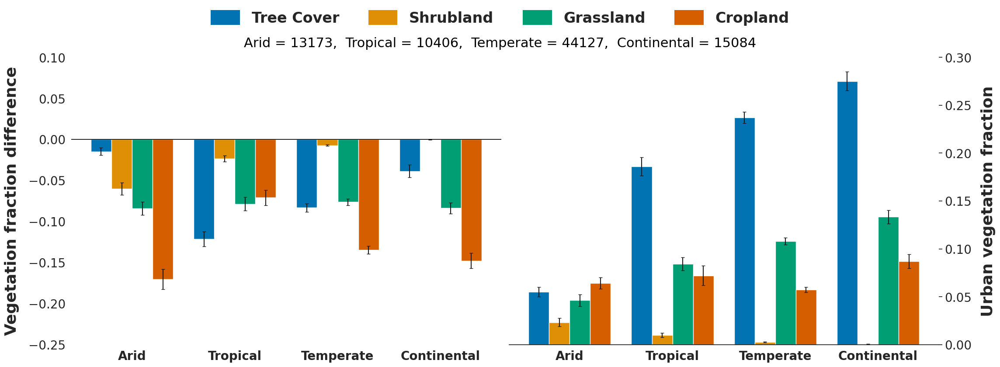

In [35]:
from __future__ import annotations

import os
import sys
from typing import Dict, List, Optional

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Patch  # legend swatches


# ------------------------------------------------------------------- #
# Configuration
# ------------------------------------------------------------------- #
if 'google.colab' in sys.modules:
    CSV_PATH = "/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries_global_ns.csv"
else:
    CSV_PATH = "./combinedFeatures_VegBiomeKoppen_withLatLon_with_countries_global_ns.csv"

VEG_TYPES: Dict[str, str] = {
    "Tree Cover": "tree_cover",
    "Cropland":   "cropland",
    "Grassland":  "grassland",
    "Shrubland":  "shrubland",
}
VEG_ORDER: List[str] = ["Tree Cover", "Shrubland", "Grassland", "Cropland"]

CLIMATE_CLASSES: Dict[str, str] = {
    'A': 'Tropical',
    'B': 'Arid',
    'C': 'Temperate',
    'D': 'Continental'
}
CLIMATE_ORDER: List[str] = ['Arid', 'Tropical', 'Temperate', 'Continental']


# ------------------------------------------------------------------- #
# ETL
# ------------------------------------------------------------------- #
def load_and_prep_data(path: str) -> pd.DataFrame:
    """Load CSV, map Köppen classes, validate areas."""
    if not os.path.isfile(path):
        raise FileNotFoundError(f"CSV file not found: {path}")

    df = pd.read_csv(path)

    # Map first letter of koppen_name_urban to climate class
    if 'koppen_name_urban' not in df.columns:
        raise KeyError("Required column 'koppen_name_urban' not found in CSV.")
    df['koppen_class'] = df['koppen_name_urban'].astype(str).str[0].map(CLIMATE_CLASSES)
    df.dropna(subset=['koppen_class'], inplace=True)
    df['koppen_class'] = pd.Categorical(df['koppen_class'],
                                        categories=CLIMATE_ORDER, ordered=True)

    # Ensure areas are numeric and non-zero
    for col in ("Urban_Area", "Buffer_area"):
        if col not in df.columns:
            raise KeyError(f"Required column '{col}' not in CSV.")
        df[col] = pd.to_numeric(df[col], errors="coerce").replace(0, np.nan)

    df = df.dropna(subset=["Urban_Area", "Buffer_area"])
    if df.empty:
        raise ValueError("After validation, dataframe is empty.")
    return df


def infer_city_id_column(df: pd.DataFrame) -> Optional[str]:
    """
    Try to find a per-city identifier to avoid double-counting.
    Falls back to None (count rows) if no suitable column is found.
    """
    candidates = [
        'city', 'City', 'city_name', 'urban_name', 'Urban_Name', 'name',
        'urban_id', 'Urban_ID', 'city_id', 'City_ID',
        'GHS_ID', 'ghs_id', 'id', 'ID'
    ]
    for col in candidates:
        if col in df.columns:
            s = df[col].astype(str)
            if s.notna().any():
                return col
    return None


def compute_city_counts_by_climate(df: pd.DataFrame) -> Dict[str, int]:
    """
    Return counts of cities per climate.
    Uses unique values of an inferred city ID column if available,
    otherwise counts rows.
    """
    id_col = infer_city_id_column(df)
    if id_col:
        # Count unique city IDs per climate
        tmp = df[[id_col, 'koppen_class']].dropna().drop_duplicates([id_col])
        counts = tmp.groupby('koppen_class', observed=False).size()
    else:
        # Fallback: each row is treated as one city
        counts = df.groupby('koppen_class', observed=False).size()

    # Reindex to CLIMATE_ORDER and fill missing with 0
    counts = counts.reindex(CLIMATE_ORDER).fillna(0).astype(int)
    return dict(counts)


def compute_climate_metrics(df: pd.DataFrame) -> pd.DataFrame:
    """Row-wise metrics per subtype: urban_fraction and (urban−rural) diff, WITH WEIGHTS."""
    frames = []
    for subtype_name, prefix in VEG_TYPES.items():
        u_col, r_col = f"{prefix}_area_urban", f"{prefix}_area_rural"
        if u_col not in df.columns or r_col not in df.columns:
            continue  # subtype missing → skip

        urban_cover = pd.to_numeric(df[u_col], errors='coerce').fillna(0.0)
        rural_cover = pd.to_numeric(df[r_col], errors='coerce').fillna(0.0)

        t = df[['koppen_class']].copy()
        t['Subtype'] = subtype_name
        t['urban_fraction'] = urban_cover / df["Urban_Area"]
        t['veg_diff'] = (urban_cover / df["Urban_Area"]) - (rural_cover / df["Buffer_area"])
        t['weight'] = df["Urban_Area"]  # ADD WEIGHT
        frames.append(t)

    if not frames:
        raise ValueError("No vegetation subtype columns found.")
    out = pd.concat(frames, ignore_index=True)
    out["Subtype"] = pd.Categorical(out["Subtype"], categories=VEG_ORDER, ordered=True)
    return out


# ------------------------------------------------------------------- #
# AREA-WEIGHTED STATISTICS
# ------------------------------------------------------------------- #
def weighted_mean_se(values: np.ndarray, weights: np.ndarray) -> tuple[float, float]:
    """
    Compute area-weighted mean and standard error.

    Returns:
        (weighted_mean, weighted_se)
    """
    if len(values) == 0 or len(weights) == 0:
        return np.nan, np.nan

    # Remove NaN values
    mask = ~(np.isnan(values) | np.isnan(weights))
    values = values[mask]
    weights = weights[mask]

    if len(values) == 0:
        return np.nan, np.nan

    sum_w = weights.sum()
    if sum_w == 0:
        return np.nan, np.nan

    # Weighted mean
    mu_w = (weights * values).sum() / sum_w

    if len(values) <= 1:
        return float(mu_w), np.nan

    # Weighted variance
    var_w = (weights * (values - mu_w)**2).sum() / sum_w

    # Effective sample size
    n_eff = sum_w**2 / (weights**2).sum()

    # Weighted SE
    se_w = np.sqrt(var_w / n_eff)

    return float(mu_w), float(se_w)


def aggregate_weighted_stats(df_metrics: pd.DataFrame) -> pd.DataFrame:
    """
    Aggregate with AREA-WEIGHTED statistics per (koppen_class, Subtype).
    Returns dataframe with columns for veg_diff_mean, veg_diff_sem, etc.
    """
    results = []

    for (climate, subtype), group in df_metrics.groupby(['koppen_class', 'Subtype'], observed=False):
        vd_vals = group['veg_diff'].values
        uf_vals = group['urban_fraction'].values
        wts = group['weight'].values

        vd_mean, vd_se = weighted_mean_se(vd_vals, wts)
        uf_mean, uf_se = weighted_mean_se(uf_vals, wts)

        results.append({
            'koppen_class': climate,
            'Subtype': subtype,
            'veg_diff_mean': vd_mean,
            'veg_diff_sem': vd_se,
            'urban_fraction_mean': uf_mean,
            'urban_fraction_sem': uf_se,
        })

    return pd.DataFrame(results)


# ------------------------------------------------------------------- #
# Plot
# ------------------------------------------------------------------- #
def plot_separate_climate_charts(df_metrics: pd.DataFrame,
                                 city_counts: Dict[str, int],
                                 outfile: str = "./split_climate_charts_area_weighted.pdf") -> None:
    """Two clustered bar charts; legend on top; single line of climate counts below legend."""
    # Aggregate with AREA-WEIGHTED stats
    agg = aggregate_weighted_stats(df_metrics)

    # Pivot for easier access
    agg_pivot = agg.set_index(['koppen_class', 'Subtype'])

    climate_zones = CLIMATE_ORDER
    x_pos = np.arange(len(climate_zones))

    # Colors (colorblind-friendly)
    palette = sns.color_palette('colorblind', n_colors=len(VEG_ORDER))
    veg_color_map = {veg: color for veg, color in zip(VEG_ORDER, palette)}

    # Cluster layout
    num_veg = len(VEG_ORDER)
    group_width = 0.8
    bar_width = group_width / num_veg
    offsets = np.linspace(-group_width / 2 + bar_width / 2,
                          group_width / 2 - bar_width / 2,
                          num_veg)

    # Figure
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9), facecolor='white')
    fig.set_facecolor('white')

    # Bars
    for i, subtype in enumerate(VEG_ORDER):
        current_x = x_pos + offsets[i]

        diff_means = []
        diff_sems = []
        frac_means = []
        frac_sems = []

        for climate in climate_zones:
            try:
                row = agg_pivot.loc[(climate, subtype)]
                diff_means.append(row['veg_diff_mean'])
                diff_sems.append(row['veg_diff_sem'])
                frac_means.append(row['urban_fraction_mean'])
                frac_sems.append(row['urban_fraction_sem'])
            except KeyError:
                diff_means.append(0)
                diff_sems.append(0)
                frac_means.append(0)
                frac_sems.append(0)

        diff_means = np.array(diff_means)
        diff_sems = np.array(diff_sems)
        frac_means = np.array(frac_means)
        frac_sems = np.array(frac_sems)

        # Replace NaN with 0 for plotting
        diff_sems = np.nan_to_num(diff_sems, nan=0.0)
        frac_sems = np.nan_to_num(frac_sems, nan=0.0)

        ax1.bar(current_x, diff_means, width=bar_width, color=veg_color_map[subtype],
                label=subtype, yerr=diff_sems, capsize=3)
        ax2.bar(current_x, frac_means, width=bar_width, color=veg_color_map[subtype],
                yerr=frac_sems, capsize=3)

    # Left axis
    ax1.axhline(0, color='black', linewidth=1.2)
    sns.despine(ax=ax1, top=True, left=True)
    ax1.set_xticks(x_pos)
    ax1.set_xticklabels(climate_zones, fontweight='bold', fontsize=20)
    ax1.set_ylabel('Vegetation fraction difference', fontweight='bold', fontsize=26, labelpad=15)
    ax1.tick_params(axis='y', labelsize=20)
    ax1.set_ylim(-0.25, 0.10)

    #remove ax1 horizontal line over axes
    ax1.spines['bottom'].set_visible(False)

    # Right axis
    sns.despine(ax=ax2, top=True, left=True, right=True)
    ax2.set_xticks(x_pos)
    ax2.set_xticklabels(climate_zones, fontweight='bold', fontsize=20)
    ax2.yaxis.tick_right()
    ax2.yaxis.set_label_position("right")
    ax2.set_ylabel('Urban vegetation fraction', fontweight='bold', fontsize=26, labelpad=15)
    ax2.tick_params(axis='y', labelsize=20)
    ax2.set_ylim(0, 0.30)

    # Legend (top, big + bold)
    legend_elements = [
        Patch(facecolor=veg_color_map[subtype], edgecolor='none', label=subtype)
        for subtype in VEG_ORDER if subtype in df_metrics['Subtype'].unique()
    ]
    leg = fig.legend(
        handles=legend_elements,
        title='',
        ncol=len(legend_elements),
        frameon=False,
        loc='upper center',
        bbox_to_anchor=(0.5, 0.98),
        fontsize=22,
        handlelength=2.0,
        handleheight=1.2,
        prop={'weight': 'bold', 'size': 24}
    )

    # ---- Place ONE line with climate counts directly below the legend ----
    fig.canvas.draw()
    renderer = fig.canvas.get_renderer()
    bbox_disp = leg.get_window_extent(renderer=renderer)
    bbox_fig = bbox_disp.transformed(fig.transFigure.inverted())
    legend_bottom_y = bbox_fig.y0

    # Compose the text in climate order (skip missing)
    items = []
    for c in CLIMATE_ORDER:
        if c in city_counts:
            items.append(f"{c} = {city_counts[c]}")
    counts_line = ",  ".join(items) if items else "No climate counts available"

    gap = 0.014
    numbers_y = legend_bottom_y - gap

    fig.text(0.5, numbers_y, counts_line,
             ha='center', va='top',
             fontsize=22, color='black',
             transform=fig.transFigure)

    # Leave space for legend + counts line
    top_rect = max(0.80, numbers_y - 0.02)
    plt.tight_layout(rect=[0.02, 0.03, 0.98, top_rect])

    plt.savefig('/content/Fig2C.pdf',
                format='pdf', bbox_inches='tight')
    plt.show()


# ------------------------------------------------------------------- #
# Main
# ------------------------------------------------------------------- #
def main() -> None:
    try:
        df_raw = load_and_prep_data(CSV_PATH)
        city_counts = compute_city_counts_by_climate(df_raw)
        df_metrics = compute_climate_metrics(df_raw)
        plot_separate_climate_charts(df_metrics, city_counts)
    except Exception as e:
        print(f"ERROR: {e}", file=sys.stderr)
        sys.exit(1)


if __name__ == "__main__":
    main()

#Stats

In [36]:
from __future__ import annotations
import math
import sys
from pathlib import Path
from typing import List, Tuple, Dict

import numpy as np
import pandas as pd
from scipy.stats import wilcoxon, f_oneway

# ────────────────────────── USER CONFIG ──────────────────────────

CSV_PATH = Path("/content/combinedFeatures_VegBiomeKoppen_withLatLon_with_countries_global_ns.csv")
SAVE_DIR = "/content/veg_subtypes_climate_outputs"
TOP_N    = 1000

CLIMATE_CLASSES = {
    "A": "Tropical",
    "B": "Arid",
    "C": "Temperate",
    "D": "Continental",
}
CLIMATE_ORDER = ["Arid", "Tropical", "Temperate", "Continental"]

# Variable definitions (column prefixes in the CSV)
VEG_SPECS = [
    {
        "label": "Tree Cover",
        "prefix": "tree_cover",
    },
    {
        "label": "Cropland",
        "prefix": "cropland",
    },
    {
        "label": "Grassland",
        "prefix": "grassland",
    },
    {
        "label": "Shrubland",
        "prefix": "shrubland",
    },
]

PERCENT_COLS = ["% U>R", "% U<R", "% U=R"]

# ────────────────────────── HELPERS ──────────────────────────────

def _coerce_num(s: pd.Series) -> pd.Series:
    return pd.to_numeric(s, errors="coerce")

def _mean_se(x: pd.Series) -> Tuple[float, float, int]:
    x = _coerce_num(x).dropna()
    n = int(x.size)
    if n == 0:
        return (np.nan, np.nan, 0)
    mu = float(x.mean())
    se = float(x.std(ddof=1) / math.sqrt(n)) if n > 1 else np.nan
    return (mu, se, n)

def _kish_weighted_mean_se(x: pd.Series, w: pd.Series) -> Tuple[float, float]:
    """
    Kish-weighted mean and SE:
        μ_w   = Σ w x / Σ w
        Var_w = Σ w (x - μ_w)^2 / Σ w
        n_eff = (Σ w)^2 / Σ w^2
        SE_w  = sqrt(Var_w / n_eff)
    """
    x = _coerce_num(x)
    w = _coerce_num(w)
    m = x.notna() & w.notna() & np.isfinite(x) & np.isfinite(w) & (w > 0)
    x = x[m].to_numpy(float)
    w = w[m].to_numpy(float)

    if x.size == 0:
        return (np.nan, np.nan)

    W = float(w.sum())
    if W <= 0:
        return (np.nan, np.nan)

    mu_w = float(np.dot(w, x) / W)
    w2 = float(np.dot(w, w))
    if w2 <= 0:
        return (mu_w, np.nan)

    n_eff = (W * W) / w2
    var_w = float(np.dot(w, (x - mu_w) ** 2) / W)
    if not np.isfinite(var_w) or not np.isfinite(n_eff) or n_eff <= 0:
        return (mu_w, np.nan)

    se_w = float(math.sqrt(var_w / n_eff))
    return (mu_w, se_w)

def _rank_biserial_from_diff(diff: pd.Series) -> float:
    """
    CORRECTED: Signed rank-biserial correlation for paired differences (Urban − Rural):

        r_rb = (R_pos - R_neg) / (R_pos + R_neg)

    where ranks are on |diff| excluding zeros.
    """
    d = _coerce_num(diff)
    d = d[d != 0].dropna()
    n = int(d.size)
    if n == 0:
        return float("nan")

    # Rank absolute differences
    ranks = d.abs().rank(method="average")
    R_pos = float(ranks[d > 0].sum())
    R_neg = float(ranks[d < 0].sum())
    R_tot = R_pos + R_neg

    if R_tot <= 0:
        return float("nan")

    return float((R_pos - R_neg) / R_tot)

def _fmt(v):
    if v is None:
        return ""
    if isinstance(v, (float, np.floating)):
        if not np.isfinite(v):
            return ""
        return f"{v:.4f}"
    if isinstance(v, (int, np.integer)):
        return f"{v:d}"
    if v == "":
        return ""
    return str(v)

def _fmt_pct(v):
    """Formatter for percentage columns: max 2 decimal places."""
    if v is None:
        return ""
    if isinstance(v, (float, np.floating)):
        if not np.isfinite(v):
            return ""
        return f"{v:.2f}"
    if isinstance(v, (int, np.integer)):
        return f"{v:d}"
    if v == "":
        return ""
    return str(v)

# ────────────────────────── LOAD & PREP ───────────────────────────

def _load_and_prepare(csv_path: Path) -> pd.DataFrame:
    if not csv_path.is_file():
        raise FileNotFoundError(f"CSV not found: {csv_path}")

    df = pd.read_csv(csv_path, low_memory=False)

    # Check required area columns
    if "Urban_Area" not in df.columns:
        raise KeyError("Missing required column 'Urban_Area'.")
    if "Buffer_area" not in df.columns:
        raise KeyError("Missing required column 'Buffer_area'.")

    df["Urban_Area"]   = _coerce_num(df["Urban_Area"]).replace(0, np.nan)
    df["Buffer_area"]  = _coerce_num(df["Buffer_area"]).replace(0, np.nan)
    df = df.dropna(subset=["Urban_Area", "Buffer_area"])

    # Climate source
    if "koppen_name_urban" in df.columns:
        klim_src = "koppen_name_urban"
    elif "koppen_name" in df.columns:
        klim_src = "koppen_name"
    else:
        raise KeyError("Missing Köppen column: need 'koppen_name_urban' or 'koppen_name'.")

    df["Climate"] = df[klim_src].astype(str).str[0].map(CLIMATE_CLASSES)
    df = df.dropna(subset=["Climate"]).copy()
    df["Climate"] = pd.Categorical(df["Climate"],
                                   categories=CLIMATE_ORDER,
                                   ordered=True)

    return df

def _top_n_by_urban_area(df: pd.DataFrame, n: int) -> pd.DataFrame:
    tmp = df.dropna(subset=["Urban_Area"])
    tmp = tmp[tmp["Urban_Area"] > 0]
    if tmp.empty:
        return pd.DataFrame(columns=df.columns)
    n = min(n, len(tmp))
    return tmp.nlargest(n, "Urban_Area", keep="all").copy()

# ────────────────────────── SCOPE SUMMARY (PER VARIABLE) ──────────

def _summarize_scope_for_variable(
    df: pd.DataFrame,
    variable_label: str,
    prefix: str,
    cohort_label: str,
) -> pd.DataFrame:
    """
    Summarize one vegetation variable for a given scope (All vs Major).
    Returns a DataFrame with rows for each climate in CLIMATE_ORDER:
      Variable, Climate, Cohort, metrics...
    """

    # Column names for this vegetation type
    urban_area_col = f"{prefix}_area_urban"
    rural_area_col = f"{prefix}_area_rural"

    # Check columns exist
    missing = [c for c in [urban_area_col, rural_area_col] if c not in df.columns]
    if missing:
        print(f"[WARN] Skipping {variable_label} (missing columns: {missing})")
        return pd.DataFrame()

    rows: List[dict] = []
    groups_for_anova: List[np.ndarray] = []

    for clim in CLIMATE_ORDER:
        sub = df[df["Climate"] == clim]
        if sub.empty:
            continue

        # Build working copy with fractions
        s = sub.copy()
        s["urban_area"] = _coerce_num(s[urban_area_col]).fillna(0)
        s["rural_area"] = _coerce_num(s[rural_area_col]).fillna(0)

        # Calculate fractions (handle division by zero)
        s["urban_frac"] = s["urban_area"] / s["Urban_Area"]
        s["rural_frac"] = s["rural_area"] / s["Buffer_area"]
        s["diff"]       = s["urban_frac"] - s["rural_frac"]
        s["w_diff"]     = s["Urban_Area"] + s["Buffer_area"]

        # Clean up invalid values
        s = s.replace([np.inf, -np.inf], np.nan)
        s = s.dropna(subset=["urban_frac", "rural_frac", "diff"])

        if s.empty:
            continue

        # Unweighted stats
        u_mu, u_se, _ = _mean_se(s["urban_frac"])
        r_mu, r_se, _ = _mean_se(s["rural_frac"])

        # Weighted stats
        u_mu_w, u_se_w = _kish_weighted_mean_se(s["urban_frac"], s["Urban_Area"])
        r_mu_w, r_se_w = _kish_weighted_mean_se(s["rural_frac"], s["Buffer_area"])

        # Differences
        diff = _coerce_num(s["diff"]).dropna()
        n_diff = int(diff.size)
        delta = float(diff.mean()) if n_diff > 0 else np.nan

        # Δw: Kish-weighted mean of diff using w_diff
        if n_diff > 0:
            x = diff
            w = _coerce_num(s.loc[diff.index, "w_diff"])
            m = x.notna() & w.notna() & np.isfinite(x) & np.isfinite(w) & (w > 0)
            x = x[m]
            w = w[m]
            if x.size > 0 and w.sum() > 0:
                delta_w, _ = _kish_weighted_mean_se(x, w)
            else:
                delta_w = np.nan
        else:
            delta_w = np.nan

        # Wilcoxon signed-rank (Δ vs 0)
        if n_diff >= 5 and np.any(diff != 0):
            try:
                T, p_w = wilcoxon(diff, zero_method="wilcox", alternative="two-sided")
            except Exception:
                T, p_w = (np.nan, np.nan)
        else:
            T, p_w = (np.nan, np.nan)

        # Cohen's d (Δ vs 0)
        if n_diff > 1:
            sd_diff = float(diff.std(ddof=1))
            d = float(delta / sd_diff) if (sd_diff > 0 and np.isfinite(sd_diff)) else np.nan
        else:
            d = np.nan

        # CORRECTED: Rank-biserial r using direct calculation
        r_rb = _rank_biserial_from_diff(diff) if n_diff > 0 else float("nan")

        # % U>R, % U<R, % U=R
        if n_diff > 0:
            pct_ur = float((diff > 0).mean() * 100.0)
            pct_lr = float((diff < 0).mean() * 100.0)
            pct_eq = float(np.isclose(diff, 0.0, atol=1e-6).mean() * 100.0)
        else:
            pct_ur = pct_lr = pct_eq = np.nan

        # For ANOVA across climates within this scope & variable
        if n_diff > 0:
            groups_for_anova.append(diff.to_numpy())

        rows.append({
            "Variable":        variable_label,
            "Climate":         clim,
            "Cohort":          cohort_label,
            "Urban μ":         u_mu,
            "Urban SE":        u_se,
            "Urban μw":        u_mu_w,
            "Urban SEw":       u_se_w,
            "Rural μ":         r_mu,
            "Rural SE":        r_se,
            "Rural μw":        r_mu_w,
            "Rural SEw":       r_se_w,
            "Δ":               delta,
            "Δw":              delta_w,
            "Cohen's d":       d,
            "Rank-biserial r": r_rb,
            "Test Statistic":  T,
            "p-value":         p_w,
            "n":               n_diff,
            "% U>R":           pct_ur,
            "% U<R":           pct_lr,
            "% U=R":           pct_eq,
        })

    # One-way ANOVA on Δ across climates (for this variable & scope)
    F_anova = np.nan
    p_anova = np.nan
    eta2    = np.nan

    valid_groups = [g for g in groups_for_anova if g.size > 1]
    if len(valid_groups) >= 2:
        try:
            F_anova, p_anova = f_oneway(*valid_groups)
            k = len(valid_groups)
            N = float(sum(len(g) for g in valid_groups))
            if np.isfinite(F_anova) and N > k:
                eta2 = float(
                    (F_anova * (k - 1)) /
                    (F_anova * (k - 1) + (N - k))
                )
        except Exception:
            F_anova = p_anova = eta2 = np.nan

    out = pd.DataFrame(rows)
    if out.empty:
        return out

    out["Climate"] = pd.Categorical(out["Climate"],
                                    categories=CLIMATE_ORDER,
                                    ordered=True)
    out = out.sort_values(["Variable", "Cohort", "Climate"]).reset_index(drop=True)

    # Attach ANOVA stats to all rows of this (Variable, Scope)
    out["ANOVA F"]       = F_anova
    out["ANOVA η²"]      = eta2
    out["ANOVA p-value"] = p_anova

    # Round numeric columns (base rounding to 4 dp; display/CSV will constrain % to 2 dp)
    num_cols = [
        "Urban μ", "Urban SE", "Urban μw", "Urban SEw",
        "Rural μ", "Rural SE", "Rural μw", "Rural SEw",
        "Δ", "Δw",
        "Cohen's d", "Rank-biserial r",
        "Test Statistic", "p-value",
        "% U>R", "% U<R", "% U=R",
        "ANOVA F", "ANOVA η²", "ANOVA p-value",
    ]
    for c in num_cols:
        if c in out.columns:
            out[c] = pd.to_numeric(out[c], errors="coerce").round(4)

    return out

# ────────────────────────── MAIN ───────────────────────────────────

def main():
    try:
        df_all = _load_and_prepare(CSV_PATH)
        print(f"[OK] Loaded {df_all.shape[0]:,} rows × {df_all.shape[1]:,} cols after cleaning.")

        df_top = _top_n_by_urban_area(df_all, TOP_N)
        have_top = not df_top.empty
        if have_top:
            print(f"[OK] TOP_{TOP_N}: {df_top.shape[0]:,} rows selected for Major cities.")
        else:
            print(f"[WARN] TOP_{TOP_N} subset empty or Urban_Area invalid; skipping Major cities.")

        all_summaries: List[pd.DataFrame] = []

        for spec in VEG_SPECS:
            label  = spec["label"]
            prefix = spec["prefix"]

            # All cities
            summary_all = _summarize_scope_for_variable(
                df=df_all,
                variable_label=label,
                prefix=prefix,
                cohort_label="All cities",
            )
            if not summary_all.empty:
                all_summaries.append(summary_all)

            # Major cities (TOP_N)
            if have_top:
                summary_top = _summarize_scope_for_variable(
                    df=df_top,
                    variable_label=label,
                    prefix=prefix,
                    cohort_label="Major cities",
                )
                if not summary_top.empty:
                    all_summaries.append(summary_top)

        if not all_summaries:
            print("[ERROR] No summaries produced for any variable.")
            sys.exit(1)

        summary = pd.concat(all_summaries, ignore_index=True)

        # Column order
        summary = summary[[
            "Variable", "Climate", "Cohort",
            "Urban μ", "Urban SE", "Urban μw", "Urban SEw",
            "Rural μ", "Rural SE", "Rural μw", "Rural SEw",
            "Δ", "Δw",
            "Cohen's d", "Rank-biserial r",
            "Test Statistic", "p-value",
            "n",
            "% U>R", "% U<R", "% U=R",
            "ANOVA F", "ANOVA η²", "ANOVA p-value",
        ]]

        # Column-specific formatters: % columns at 2 dp, everything else via _fmt (4 dp)
        fmt_map = {}
        for col in summary.columns:
            if col in PERCENT_COLS:
                fmt_map[col] = _fmt_pct
            else:
                fmt_map[col] = _fmt

        print("\n=== VEGETATION SUBTYPES × CLIMATE × COHORT SUMMARY TABLE ===")
        with pd.option_context("display.max_rows", None,
                               "display.max_columns", None):
            print(summary.to_string(index=False,
                                    formatters=fmt_map))

        # For CSV: force % cols to strings with 2 dp; other numerics at 4 dp
        csv_df = summary.copy()
        for col in PERCENT_COLS:
            if col in csv_df.columns:
                csv_df[col] = csv_df[col].apply(
                    lambda v: "" if (pd.isna(v)) else f"{float(v):.2f}"
                )

        print("\n=== VEGETATION SUBTYPES × CLIMATE × COHORT SUMMARY TABLE CSV ===")
        print(csv_df.to_csv(index=False, float_format="%.4f", na_rep=""))

        if SAVE_DIR:
            out_dir = Path(SAVE_DIR)
            out_dir.mkdir(parents=True, exist_ok=True)
            out_path = out_dir / "veg_subtypes_climate_summary_table.csv"
            csv_df.to_csv(out_path, index=False, float_format="%.4f", na_rep="")
            print(f"[OK] Saved: {out_path}")

    except (FileNotFoundError, KeyError, ValueError) as e:
        print(f"[ERROR] {e}", file=sys.stderr)
        sys.exit(1)
    except Exception as e:
        print(f"[ERROR] Unexpected failure: {e.__class__.__name__}: {e}", file=sys.stderr)
        raise


if __name__ == "__main__":
    main()


[OK] Loaded 82,790 rows × 34 cols after cleaning.
[OK] TOP_1000: 1,000 rows selected for Major cities.

=== VEGETATION SUBTYPES × CLIMATE × COHORT SUMMARY TABLE ===
  Variable     Climate       Cohort Urban μ Urban SE Urban μw Urban SEw Rural μ Rural SE Rural μw Rural SEw       Δ      Δw Cohen's d Rank-biserial r Test Statistic p-value     n % U>R % U<R % U=R   ANOVA F ANOVA η² ANOVA p-value
Tree Cover        Arid   All cities  0.0464   0.0008   0.0550    0.0050  0.0525   0.0007   0.0687    0.0058 -0.0061 -0.0143   -0.0882         -0.1870  30977602.0000  0.0000 13173 41.55 52.17  6.30 1201.7142   0.0417        0.0000
Tree Cover    Tropical   All cities  0.2044   0.0017   0.1859    0.0096  0.3091   0.0021   0.3083    0.0124 -0.1047 -0.1203   -0.8053         -0.7900   5652316.0000  0.0000 10406 18.33 81.39  0.29 1201.7142   0.0417        0.0000
Tree Cover   Temperate   All cities  0.2235   0.0008   0.2372    0.0061  0.2716   0.0010   0.3170    0.0065 -0.0481 -0.0813   -0.3365         -0.

#End